Nome: João Gabriel Andrade de Araujo Josephik NUSP: 12542265

Link do colab:https://colab.research.google.com/drive/1bqgY4qfsSZ_MjZp6Kuyh2t3Xdhoj5qLj?usp=sharing

Resultados do treinamento: https://drive.google.com/drive/folders/1xAvFkAXS75v5IMXeBfEjeAGT3dT3Wpcq?usp=share_link

O notebook abaixo contém a resolução de um problema de segmentação de vasos em iamgens de retinas. Os resultados foram bastante satisfatórios: 96% de acurácia no conjunto de testes. As redes foram capazes de detectar vasos bastante difíceis para o olho humano.

Para ajudar a rede a aprender, foram utilizadas máscaras com diferentes pesos para cada pixel. Como o problema é desbalanceado, os vasos receberam peso proporcional para compensar esse desbalanceamento (em torno de 11). Além disso os pixels em volta dos vasos também receberam peso aumentado (é mais importante para a rede que os vasos sejam nítidos do que os pixels longe dos vasos!).

As redes utilizadas utilizam arquiteturas do tipo U-NET (com encoder e decoder). Foram testadas redes de dois tamanhos: aproximadamente 400 mil parâmetros e aproximadamente 8 milhões de parâmetros. Ambos modelos alcançaram resultados similares: 0.68046 contra 0.67319 de perda, respectivamente. Entretanto, o modelo maior alcançou o resultado mais rapidamente.

Early stopping foi essencial em ambos modelos: os dois sofreram de gravíssimo overfitting. Isso pode ser percebido nos gráficos de treinamento.

Além disso, foi percebido que a adição de Batch Normalizaion ajudou enormemente com o treinamento.

Várias fontes foram consultadas na confecção desse trabalho. Todos os links estão listados abaixo.

- https://pyimagesearch.com/2021/11/08/u-net-training-image-segmentation-models-in-pytorch/

- https://github.com/milesial/Pytorch-UNet/tree/master

- https://medium.com/analytics-vidhya/unet-implementation-in-pytorch-idiot-developer-da40d955f201

- https://github.com/usuyama/pytorch-unet


In [1]:
import os
import gc
import torch
from torch import nn, optim
import pandas as pd
from skimage import io, transform, morphology
from skimage.morphology import binary_dilation, star
import numpy as np
import matplotlib.pyplot as plt
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils
import torch

from torch.optim import lr_scheduler as schd
from tqdm import tqdm
!pip install imagecodecs

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Exploração dos dados

In [3]:
class DRIVE_Dataset(Dataset):

  def __init__(self, data_dir, train=True, input_transform=None, target_transform=None, weight=1):
    self.training = 'training'if train else 'test'
    self.data_dir = os.path.join(data_dir, self.training)

    self.input_dir=os.path.join(self.data_dir, 'input')
    self.input=sorted([os.path.join(self.input_dir, image) for image in os.listdir(self.input_dir)])

    self.target_dir=os.path.join(self.data_dir, 'target')
    self.target=sorted([os.path.join(self.target_dir, image) for image in os.listdir(self.target_dir)])

    assert len(self.input) == len(self.target)

    self.input_transform = input_transform
    self.target_transform = target_transform

    self.to_tensor = transforms.ToTensor()
    self.conv_mask = torch.ones((1, 1, 11, 11)) * (3/(11*11))
    self.blur = lambda x: torch.nn.functional.conv2d(input=x.unsqueeze(0), weight=self.conv_mask, stride=1, padding='same').squeeze(0)

    self.weight=weight
  def __len__(self):
    return len(self.input)

  def __getitem__(self, idx):
    with torch.no_grad():



      input_im = self.to_tensor(io.imread(self.input[idx]))
      target_im = self.to_tensor((io.imread(self.target[idx]))).type(torch.LongTensor).squeeze(0)
      weight_im = self.blur((target_im.clone().type(torch.FloatTensor).unsqueeze(0) * self.weight)).squeeze(0).clamp(max=self.weight, min=1)

      weight_im[target_im == 1] = self.weight

      if self.input_transform:
        input_im = self.input_transform(input_im)
      if self.target_transform:
        target_im = self.target_transform(target_im)

      return (input_im, target_im, weight_im)



In [4]:

train_data=DRIVE_Dataset('/content/drive/MyDrive/dataset/drive',weight=10.5853)
test_data=DRIVE_Dataset('/content/drive/MyDrive/dataset/drive',weight=10.5853,train=False)

In [5]:
if train_data.weight==1:
  weight=0
  total=0
  positive=1
  for (input, target, _) in tqdm(train_data):
        total+=target.shape[-1]*target.shape[-2]
        positive+=target.sum()

  weight=((total-positive)/positive)
  test_data.weight=train_data.weight=weight

torch.Size([584, 565])


tensor(10.5853)

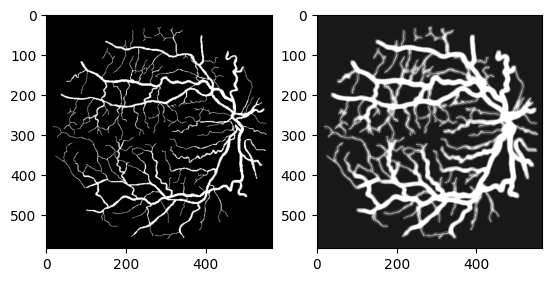

In [6]:
target=train_data[1][1]
weight=train_data[1][2]
print(target.shape)
plt.subplot(1, 2, 1)
plt.imshow(target,cmap='gray')
plt.subplot(1, 2, 2)

plt.imshow(weight, cmap='gray', vmin=0)
weight.max()


torch.Size([3, 3, 584, 565])
torch.Size([3, 584, 565])
torch.Size([584, 565, 3])
torch.Size([584, 565])
torch.Size([584, 565])
tensor([0, 1])
torch.Size([584, 565])
torch.Size([3, 584, 565])
torch.Size([584, 565, 3])
torch.Size([584, 565])
torch.Size([584, 565])
tensor([0, 1])
torch.Size([584, 565])
torch.Size([3, 584, 565])
torch.Size([584, 565, 3])
torch.Size([584, 565])
torch.Size([584, 565])
tensor([0, 1])
torch.Size([584, 565])


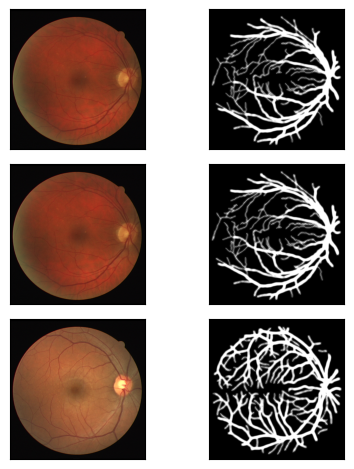

In [7]:
import matplotlib.pyplot as plt
length=3
begin=3
visualization_range = np.random.choice(len(train_data), length)
example_data = torch.stack([train_data[i][0] for i in visualization_range])
example_targets = torch.stack([train_data[i][1] for i in visualization_range])
example_weights = torch.stack([train_data[i][2] for i in visualization_range])

fig = plt.figure()
print(example_data.shape)
for i in range(3):
  print(example_data[i].shape)

  data = example_data[i].movedim(0, 2)

  print(data.shape)
  plt.subplot(3,3,3*i+1)
  plt.tight_layout()
  plt.imshow(data)
  plt.xticks([])
  plt.yticks([])

  print(example_targets[i].shape)
  target = example_targets[i]

  print (target.shape)
  plt.subplot(3,3,3*i+2)
  plt.tight_layout()
  plt.imshow(target, cmap='gray')
  plt.xticks([])
  plt.yticks([])

  print(torch.unique(target))

  weight=example_weights[i]
  print (weight.shape)
  plt.subplot(3,3,3*i+2)
  plt.tight_layout()
  plt.imshow(weight, cmap='gray', )
  plt.xticks([])
  plt.yticks([])


In [8]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)


In [9]:
def train(network, train_loader, epoch, optimizer, loss_fn, log_interval, batch_size_train, train_losses, train_counter):
  network.train()
  for batch_idx, (data, target, weight) in enumerate(train_loader):
    gc.collect()
    torch.cuda.empty_cache()
    data = data.to(device)
    target = target.to(device)
    weight =  weight.to(device)

    optimizer.zero_grad()
    output = network(data)

    loss = loss_fn(output, target)
    loss = loss * weight

    loss = loss.mean()

    loss.backward()

    optimizer.step()

    data = None
    target = None
    weight = None
    gc.collect()
    torch.cuda.empty_cache()
    if batch_idx % log_interval == 0:
      print('Train Epoch: {} [{}/{} ({:.0f}%)]\tLoss: {:.6f}'.format(
        epoch, batch_idx * batch_size_train, len(train_loader.dataset),
        100 * batch_idx / len(train_loader), loss))
    train_losses.append(loss)
    train_counter.append((batch_idx*batch_size_train) + ((epoch-1)*len(train_loader.dataset)))


In [10]:
def test(network, test_loader, loss_fn, batch_size_test, test_losses, test_counter):

  network.eval()
  test_loss = 0
  correct = 0
  batches=0
  total=0
  with torch.no_grad():
    for data, target, weight in test_loader:
      gc.collect()
      torch.cuda.empty_cache()
      data = data.to(device)
      target = target.to(device)
      weight = weight.to(device)
      output = network(data)
      loss = loss_fn(output, target ) * weight
      test_loss += loss.sum()
      pred = (output.argmax(dim=-3))
      correct += pred.eq(target).sum()
      total += target.numel()
  test_loss = test_loss / total
  test_losses.append(test_loss)
  test_counter.append((test_counter[-1] + len(test_loader.dataset))if len(test_counter) > 0 else 0)
  print('\nTest set: Avg. loss: {:.4f}, Accuracy: {}/{} ({:.0f}%)\n'.format(
    test_loss, correct, total,
    100 * correct / total ) )


  fig = plt.figure()
  ind = np.random.randint(0, len(test_loader.dataset))
  input=test_loader.dataset[ind][0]
  target=test_loader.dataset[ind][1]
  plt.subplot(1,3,1)
  plt.imshow(input.movedim(0, 2))
  plt.subplot(1,3,2)
  plt.imshow(target, cmap='gray')
  plt.subplot(1,3,3)
  output=network(input.unsqueeze(0).to(device)).cpu().squeeze(0).argmax(-3)
  plt.imshow(output, cmap='gray', vmin=0, vmax=1)
  plt.show()

## Rede menor

In [11]:
class UNetBlock(nn.Module):

  def __init__(self, in_channels, out_channels):
    super().__init__()

    self.seq=nn.Sequential(
      nn.Conv2d(in_channels, out_channels, 3, padding='same'),
      nn.ReLU(),
      nn.BatchNorm2d(out_channels),
      nn.Conv2d(out_channels, out_channels, 3, padding='same'),
      nn.ReLU())

  def forward(self, x):
    return self.seq(x)

class UpConvBlock(nn.Module):
  def __init__(self, in_channels, out_channels):
    super().__init__()

    self.ct= nn.Sequential(
      nn.ConvTranspose2d(in_channels, out_channels, kernel_size=2, stride=2),
      nn.ReLU())


  def forward(self, x, i):
    o = self.ct(x)

    padding = [0, 0, 0, 0]
    if o.shape[-1] == (i.shape[-1] - 1):
      padding[0] = 1
    if o.shape[-2] == (i.shape[-2] - 1):
      padding[2] = 1

    o = torch.nn.functional.pad(o, padding, mode='replicate')

    return torch.cat([i, o], dim=1)

class UNet(nn.Module):
    def __init__(self):
        super(UNet, self).__init__()


        self.e1=UNetBlock(3, 64)
        self.me1=nn.MaxPool2d(2)


        self.bt=UNetBlock(64, 128)


        self.ct1=UpConvBlock(128, 64)
        self.d1=UNetBlock(128, 64)

        self.cls = nn.Sequential(
            nn.Conv2d(64, 2, kernel_size=1),
            nn.ReLU()
        )



    def forward(self, x):
        i1 = self.e1(x)

        b = self.bt(self.me1(i1))

        o1 = self.d1( self.ct1(b, i1) )

        cls = self.cls(o1)

        return cls





In [28]:
random_seed = 42
torch.manual_seed(random_seed)
device = 'cuda' if torch.cuda.is_available() else 'cpu'
parameters_file='/content/drive/MyDrive/modelos/segmentacao_vasos/parameters.pth'
saved_parameters_file='/content/drive/MyDrive/modelos/segmentacao_vasos/best_parameters.pth'
training_data_file='/content/drive/MyDrive/modelos/segmentacao_vasos/treinamento.pickle'
batch_size_train = 8
batch_size_test = 8
train_loader = torch.utils.data.DataLoader(
  train_data,
  batch_size=batch_size_train, shuffle=True)

test_loader = torch.utils.data.DataLoader(
  test_data,
  batch_size=batch_size_test, shuffle=True)
device

'cuda'

In [29]:
gc.collect()
torch.cuda.empty_cache()
n_epochs = 150

learning_rate = 1e-3

log_interval=1

network = UNet().to(device)

optimizer = optim.Adam(network.parameters(), lr=learning_rate)
loss_fn=nn.CrossEntropyLoss(reduction='none', )
scheduler = schd.StepLR(optimizer, 100, 0.5)

train_losses = []
train_counter = []
test_losses = []
test_counter=[]


In [14]:
count_parameters(network)

404354


Test set: Avg. loss: 2.0280, Accuracy: 6021255/6599200 (91%)



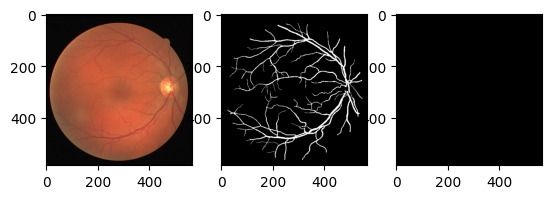

Train Epoch: 1 [0/20 (0%)]	Loss: 2.071117
Train Epoch: 1 [8/20 (33%)]	Loss: 1.858218
Train Epoch: 1 [16/20 (67%)]	Loss: 1.663678

Test set: Avg. loss: 2.0216, Accuracy: 6021255/6599200 (91%)



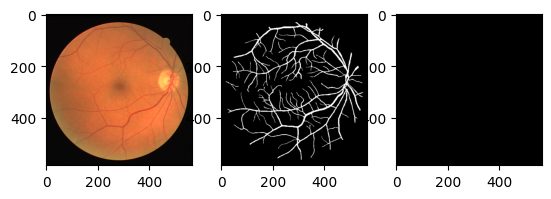

New best! Saving...
Train Epoch: 2 [0/20 (0%)]	Loss: 1.641148
Train Epoch: 2 [8/20 (33%)]	Loss: 1.369758
Train Epoch: 2 [16/20 (67%)]	Loss: 1.307152

Test set: Avg. loss: 1.9619, Accuracy: 6021255/6599200 (91%)



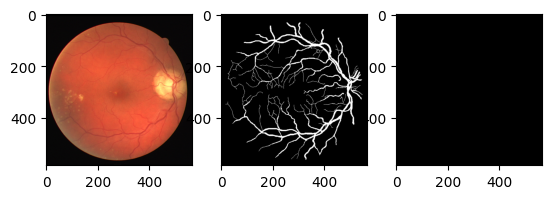

New best! Saving...
Train Epoch: 3 [0/20 (0%)]	Loss: 1.272263
Train Epoch: 3 [8/20 (33%)]	Loss: 1.194274
Train Epoch: 3 [16/20 (67%)]	Loss: 0.920055

Test set: Avg. loss: 1.9092, Accuracy: 6021255/6599200 (91%)



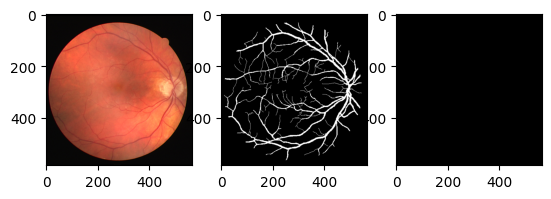

New best! Saving...
Train Epoch: 4 [0/20 (0%)]	Loss: 1.018035
Train Epoch: 4 [8/20 (33%)]	Loss: 0.940074
Train Epoch: 4 [16/20 (67%)]	Loss: 0.842104

Test set: Avg. loss: 1.9849, Accuracy: 6021255/6599200 (91%)



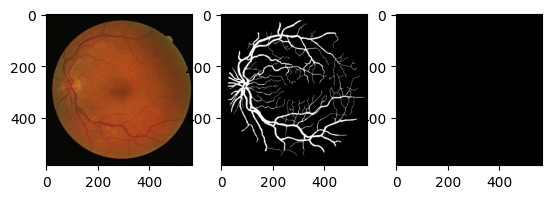

Train Epoch: 5 [0/20 (0%)]	Loss: 0.837273
Train Epoch: 5 [8/20 (33%)]	Loss: 0.992546
Train Epoch: 5 [16/20 (67%)]	Loss: 0.789411

Test set: Avg. loss: 2.0387, Accuracy: 6021255/6599200 (91%)



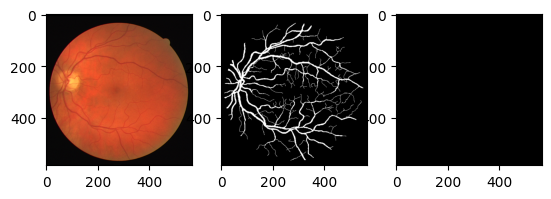

Train Epoch: 6 [0/20 (0%)]	Loss: 0.840231
Train Epoch: 6 [8/20 (33%)]	Loss: 0.943322
Train Epoch: 6 [16/20 (67%)]	Loss: 0.873625

Test set: Avg. loss: 2.0668, Accuracy: 6021255/6599200 (91%)



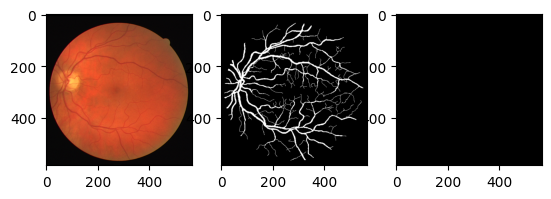

Train Epoch: 7 [0/20 (0%)]	Loss: 0.831783
Train Epoch: 7 [8/20 (33%)]	Loss: 0.833295
Train Epoch: 7 [16/20 (67%)]	Loss: 0.954288

Test set: Avg. loss: 1.9886, Accuracy: 6021255/6599200 (91%)



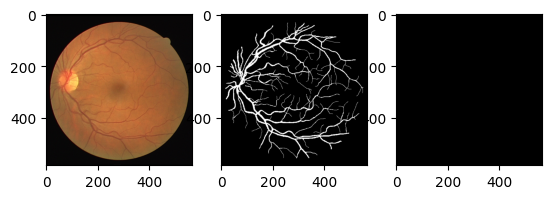

Train Epoch: 8 [0/20 (0%)]	Loss: 0.816984
Train Epoch: 8 [8/20 (33%)]	Loss: 0.853048
Train Epoch: 8 [16/20 (67%)]	Loss: 0.911765

Test set: Avg. loss: 2.0919, Accuracy: 6021255/6599200 (91%)



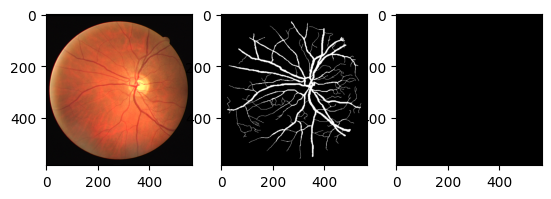

Train Epoch: 9 [0/20 (0%)]	Loss: 0.805674
Train Epoch: 9 [8/20 (33%)]	Loss: 0.846167
Train Epoch: 9 [16/20 (67%)]	Loss: 0.855514

Test set: Avg. loss: 2.0332, Accuracy: 6021259/6599200 (91%)



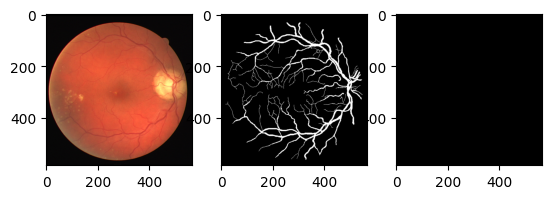

Train Epoch: 10 [0/20 (0%)]	Loss: 0.825857
Train Epoch: 10 [8/20 (33%)]	Loss: 0.846431
Train Epoch: 10 [16/20 (67%)]	Loss: 0.751011

Test set: Avg. loss: 2.2646, Accuracy: 6021256/6599200 (91%)



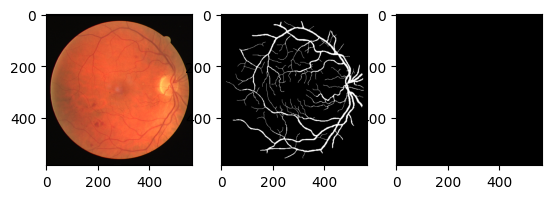

Train Epoch: 11 [0/20 (0%)]	Loss: 0.781174
Train Epoch: 11 [8/20 (33%)]	Loss: 0.856951
Train Epoch: 11 [16/20 (67%)]	Loss: 0.856091

Test set: Avg. loss: 2.1725, Accuracy: 6021282/6599200 (91%)



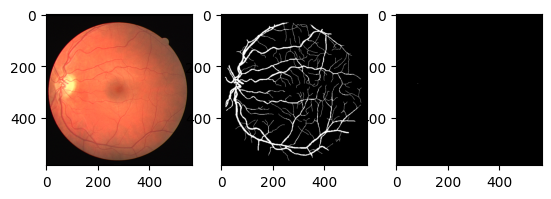

Train Epoch: 12 [0/20 (0%)]	Loss: 0.841683
Train Epoch: 12 [8/20 (33%)]	Loss: 0.799109
Train Epoch: 12 [16/20 (67%)]	Loss: 0.787187

Test set: Avg. loss: 2.2554, Accuracy: 6021345/6599200 (91%)



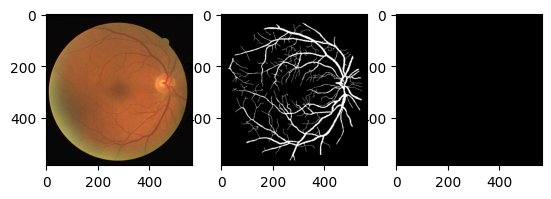

Train Epoch: 13 [0/20 (0%)]	Loss: 0.810499
Train Epoch: 13 [8/20 (33%)]	Loss: 0.807519
Train Epoch: 13 [16/20 (67%)]	Loss: 0.732757

Test set: Avg. loss: 2.6010, Accuracy: 6021345/6599200 (91%)



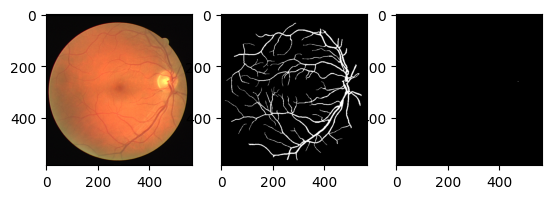

Train Epoch: 14 [0/20 (0%)]	Loss: 0.823066
Train Epoch: 14 [8/20 (33%)]	Loss: 0.733828
Train Epoch: 14 [16/20 (67%)]	Loss: 0.857558

Test set: Avg. loss: 2.3658, Accuracy: 6024026/6599200 (91%)



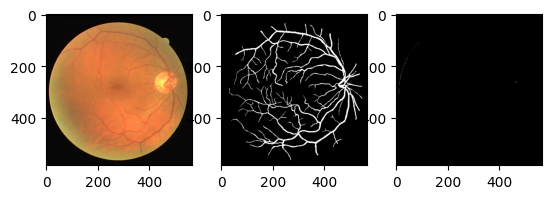

Train Epoch: 15 [0/20 (0%)]	Loss: 0.836446
Train Epoch: 15 [8/20 (33%)]	Loss: 0.750929
Train Epoch: 15 [16/20 (67%)]	Loss: 0.776266

Test set: Avg. loss: 2.2784, Accuracy: 6030393/6599200 (91%)



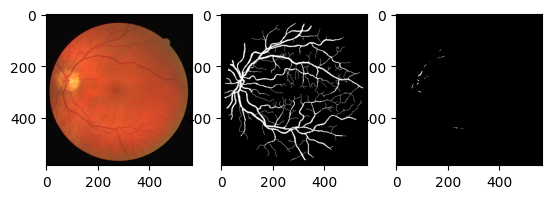

Train Epoch: 16 [0/20 (0%)]	Loss: 0.768602
Train Epoch: 16 [8/20 (33%)]	Loss: 0.791097
Train Epoch: 16 [16/20 (67%)]	Loss: 0.783455

Test set: Avg. loss: 2.3150, Accuracy: 6039258/6599200 (92%)



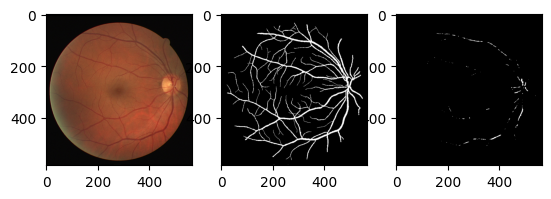

Train Epoch: 17 [0/20 (0%)]	Loss: 0.741621
Train Epoch: 17 [8/20 (33%)]	Loss: 0.869780
Train Epoch: 17 [16/20 (67%)]	Loss: 0.672418

Test set: Avg. loss: 2.2044, Accuracy: 6070544/6599200 (92%)



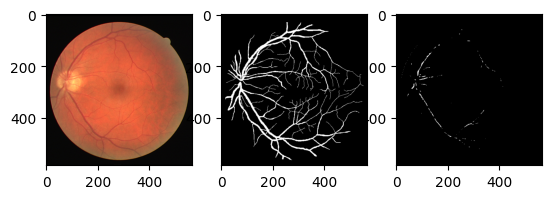

Train Epoch: 18 [0/20 (0%)]	Loss: 0.714636
Train Epoch: 18 [8/20 (33%)]	Loss: 0.742592
Train Epoch: 18 [16/20 (67%)]	Loss: 0.977906

Test set: Avg. loss: 1.9994, Accuracy: 6108795/6599200 (93%)



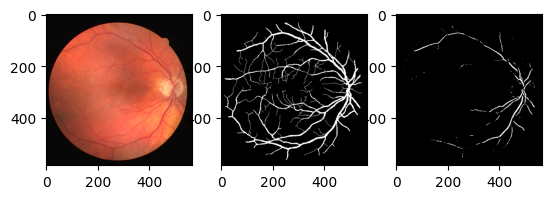

Train Epoch: 19 [0/20 (0%)]	Loss: 0.821859
Train Epoch: 19 [8/20 (33%)]	Loss: 0.752438
Train Epoch: 19 [16/20 (67%)]	Loss: 0.745204

Test set: Avg. loss: 1.4720, Accuracy: 6193946/6599200 (94%)



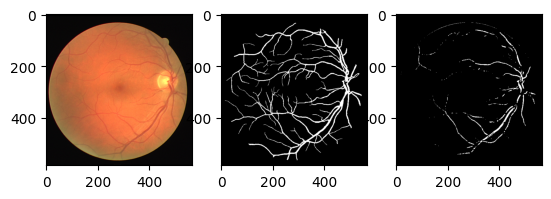

New best! Saving...
Train Epoch: 20 [0/20 (0%)]	Loss: 0.755941
Train Epoch: 20 [8/20 (33%)]	Loss: 0.803072
Train Epoch: 20 [16/20 (67%)]	Loss: 0.710709

Test set: Avg. loss: 1.6024, Accuracy: 6182753/6599200 (94%)



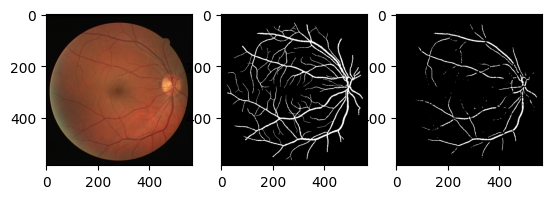

Train Epoch: 21 [0/20 (0%)]	Loss: 0.737611
Train Epoch: 21 [8/20 (33%)]	Loss: 0.744719
Train Epoch: 21 [16/20 (67%)]	Loss: 0.802404

Test set: Avg. loss: 1.3484, Accuracy: 6263401/6599200 (95%)



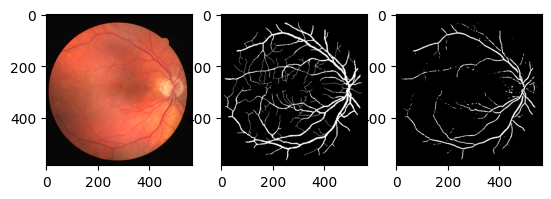

New best! Saving...
Train Epoch: 22 [0/20 (0%)]	Loss: 0.732900
Train Epoch: 22 [8/20 (33%)]	Loss: 0.768913
Train Epoch: 22 [16/20 (67%)]	Loss: 0.761322

Test set: Avg. loss: 1.2555, Accuracy: 6275955/6599200 (95%)



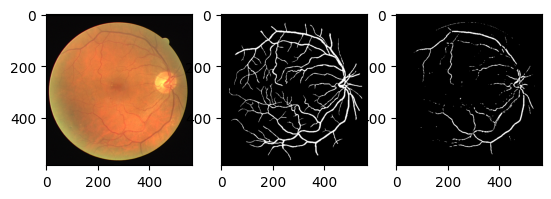

New best! Saving...
Train Epoch: 23 [0/20 (0%)]	Loss: 0.784656
Train Epoch: 23 [8/20 (33%)]	Loss: 0.717574
Train Epoch: 23 [16/20 (67%)]	Loss: 0.714265

Test set: Avg. loss: 1.1308, Accuracy: 6309100/6599200 (96%)



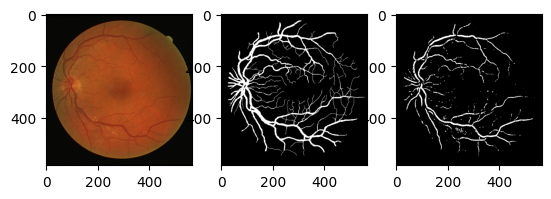

New best! Saving...
Train Epoch: 24 [0/20 (0%)]	Loss: 0.806895
Train Epoch: 24 [8/20 (33%)]	Loss: 0.715950
Train Epoch: 24 [16/20 (67%)]	Loss: 0.662165

Test set: Avg. loss: 1.0078, Accuracy: 6327095/6599200 (96%)



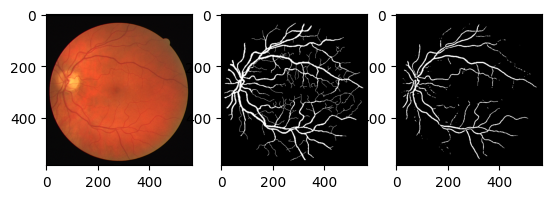

New best! Saving...
Train Epoch: 25 [0/20 (0%)]	Loss: 0.752773
Train Epoch: 25 [8/20 (33%)]	Loss: 0.692406
Train Epoch: 25 [16/20 (67%)]	Loss: 0.781059

Test set: Avg. loss: 0.9516, Accuracy: 6337297/6599200 (96%)



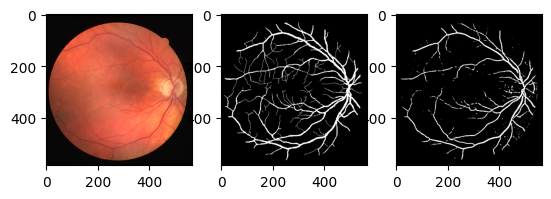

New best! Saving...
Train Epoch: 26 [0/20 (0%)]	Loss: 0.747632
Train Epoch: 26 [8/20 (33%)]	Loss: 0.698897
Train Epoch: 26 [16/20 (67%)]	Loss: 0.762367

Test set: Avg. loss: 0.8773, Accuracy: 6349346/6599200 (96%)



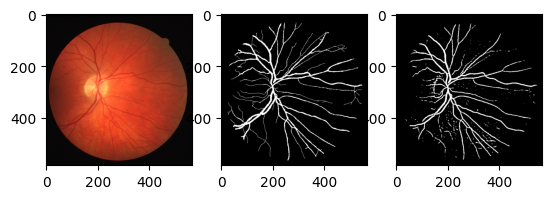

New best! Saving...
Train Epoch: 27 [0/20 (0%)]	Loss: 0.711204
Train Epoch: 27 [8/20 (33%)]	Loss: 0.756166
Train Epoch: 27 [16/20 (67%)]	Loss: 0.686098

Test set: Avg. loss: 0.8359, Accuracy: 6354454/6599200 (96%)



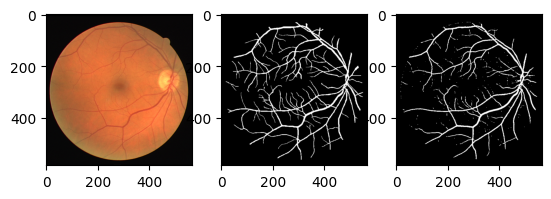

New best! Saving...
Train Epoch: 28 [0/20 (0%)]	Loss: 0.708682
Train Epoch: 28 [8/20 (33%)]	Loss: 0.773028
Train Epoch: 28 [16/20 (67%)]	Loss: 0.659033

Test set: Avg. loss: 0.8374, Accuracy: 6357018/6599200 (96%)



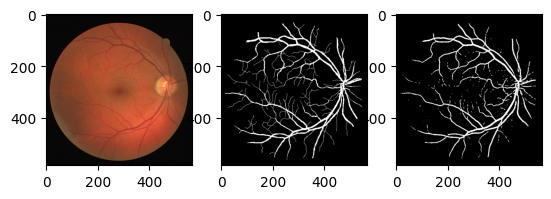

Train Epoch: 29 [0/20 (0%)]	Loss: 0.718479
Train Epoch: 29 [8/20 (33%)]	Loss: 0.700951
Train Epoch: 29 [16/20 (67%)]	Loss: 0.730472

Test set: Avg. loss: 0.7864, Accuracy: 6356132/6599200 (96%)



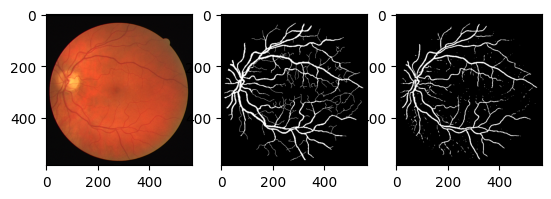

New best! Saving...
Train Epoch: 30 [0/20 (0%)]	Loss: 0.729378
Train Epoch: 30 [8/20 (33%)]	Loss: 0.662059
Train Epoch: 30 [16/20 (67%)]	Loss: 0.766087

Test set: Avg. loss: 0.7563, Accuracy: 6352646/6599200 (96%)



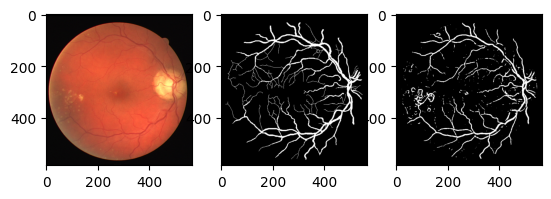

New best! Saving...
Train Epoch: 31 [0/20 (0%)]	Loss: 0.747145
Train Epoch: 31 [8/20 (33%)]	Loss: 0.657076
Train Epoch: 31 [16/20 (67%)]	Loss: 0.723471

Test set: Avg. loss: 0.7712, Accuracy: 6362152/6599200 (96%)



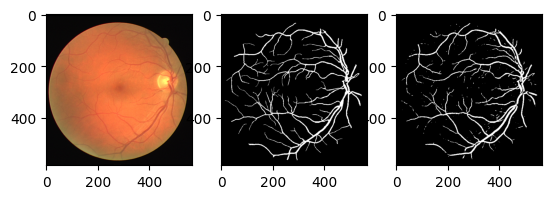

Train Epoch: 32 [0/20 (0%)]	Loss: 0.718582
Train Epoch: 32 [8/20 (33%)]	Loss: 0.735441
Train Epoch: 32 [16/20 (67%)]	Loss: 0.623811

Test set: Avg. loss: 0.7424, Accuracy: 6353112/6599200 (96%)



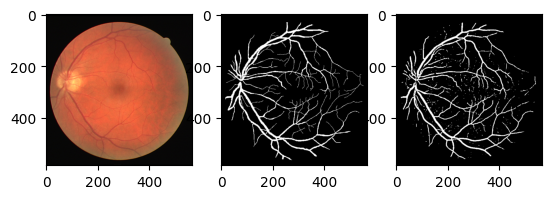

New best! Saving...
Train Epoch: 33 [0/20 (0%)]	Loss: 0.724835
Train Epoch: 33 [8/20 (33%)]	Loss: 0.668225
Train Epoch: 33 [16/20 (67%)]	Loss: 0.699157

Test set: Avg. loss: 0.7633, Accuracy: 6362907/6599200 (96%)



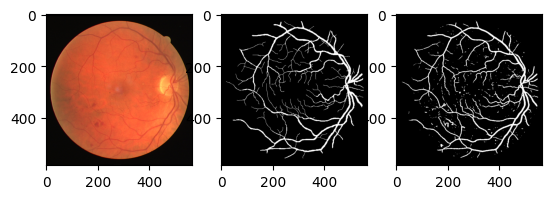

Train Epoch: 34 [0/20 (0%)]	Loss: 0.656853
Train Epoch: 34 [8/20 (33%)]	Loss: 0.708918
Train Epoch: 34 [16/20 (67%)]	Loss: 0.768950

Test set: Avg. loss: 0.7301, Accuracy: 6341913/6599200 (96%)



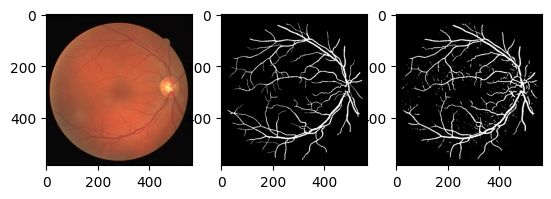

New best! Saving...
Train Epoch: 35 [0/20 (0%)]	Loss: 0.704153
Train Epoch: 35 [8/20 (33%)]	Loss: 0.700676
Train Epoch: 35 [16/20 (67%)]	Loss: 0.657799

Test set: Avg. loss: 0.7902, Accuracy: 6355887/6599200 (96%)



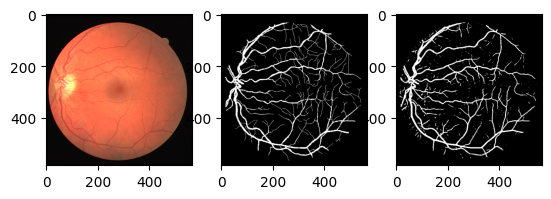

Train Epoch: 36 [0/20 (0%)]	Loss: 0.708659
Train Epoch: 36 [8/20 (33%)]	Loss: 0.680314
Train Epoch: 36 [16/20 (67%)]	Loss: 0.736084

Test set: Avg. loss: 0.7263, Accuracy: 6348072/6599200 (96%)



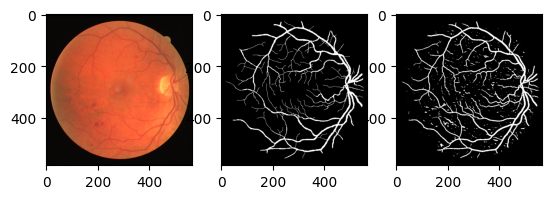

New best! Saving...
Train Epoch: 37 [0/20 (0%)]	Loss: 0.733652
Train Epoch: 37 [8/20 (33%)]	Loss: 0.696877
Train Epoch: 37 [16/20 (67%)]	Loss: 0.602963

Test set: Avg. loss: 0.7579, Accuracy: 6359791/6599200 (96%)



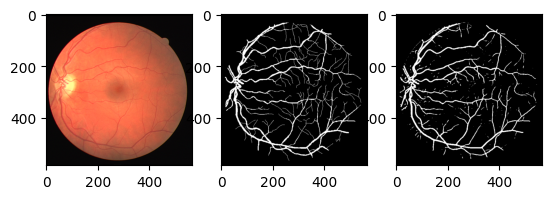

Train Epoch: 38 [0/20 (0%)]	Loss: 0.748806
Train Epoch: 38 [8/20 (33%)]	Loss: 0.654537
Train Epoch: 38 [16/20 (67%)]	Loss: 0.651977

Test set: Avg. loss: 0.7324, Accuracy: 6361784/6599200 (96%)



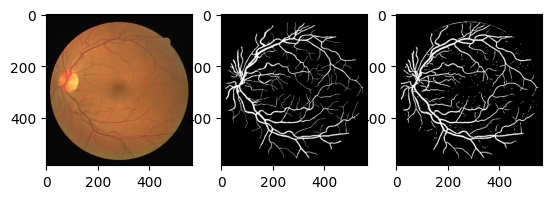

Train Epoch: 39 [0/20 (0%)]	Loss: 0.625696
Train Epoch: 39 [8/20 (33%)]	Loss: 0.674623
Train Epoch: 39 [16/20 (67%)]	Loss: 0.848940

Test set: Avg. loss: 0.7219, Accuracy: 6330396/6599200 (96%)



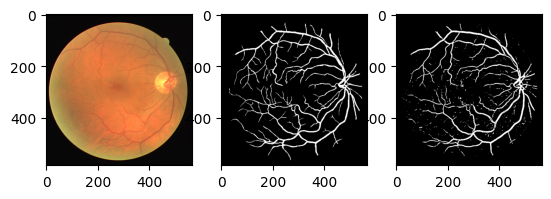

New best! Saving...
Train Epoch: 40 [0/20 (0%)]	Loss: 0.662682
Train Epoch: 40 [8/20 (33%)]	Loss: 0.655151
Train Epoch: 40 [16/20 (67%)]	Loss: 0.798999

Test set: Avg. loss: 0.7482, Accuracy: 6359651/6599200 (96%)



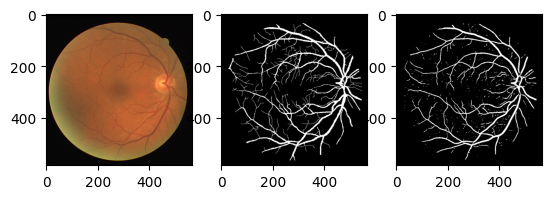

Train Epoch: 41 [0/20 (0%)]	Loss: 0.718678
Train Epoch: 41 [8/20 (33%)]	Loss: 0.682373
Train Epoch: 41 [16/20 (67%)]	Loss: 0.593573

Test set: Avg. loss: 0.8324, Accuracy: 6366961/6599200 (96%)



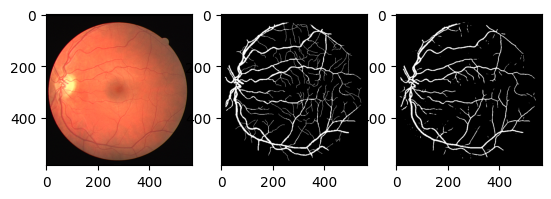

Train Epoch: 42 [0/20 (0%)]	Loss: 0.722515
Train Epoch: 42 [8/20 (33%)]	Loss: 0.679373
Train Epoch: 42 [16/20 (67%)]	Loss: 0.614607

Test set: Avg. loss: 0.7472, Accuracy: 6363163/6599200 (96%)



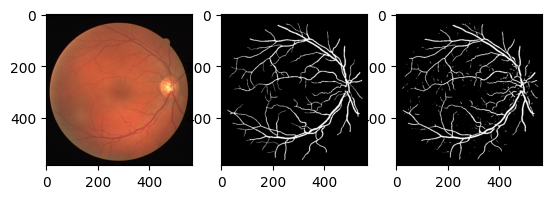

Train Epoch: 43 [0/20 (0%)]	Loss: 0.673375
Train Epoch: 43 [8/20 (33%)]	Loss: 0.677057
Train Epoch: 43 [16/20 (67%)]	Loss: 0.690496

Test set: Avg. loss: 0.7213, Accuracy: 6365382/6599200 (96%)



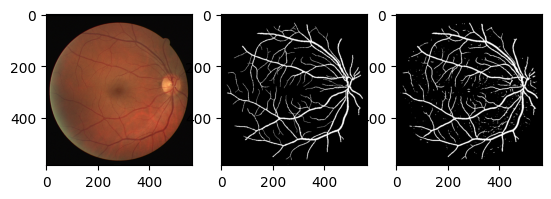

New best! Saving...
Train Epoch: 44 [0/20 (0%)]	Loss: 0.663642
Train Epoch: 44 [8/20 (33%)]	Loss: 0.668783
Train Epoch: 44 [16/20 (67%)]	Loss: 0.678133

Test set: Avg. loss: 0.7271, Accuracy: 6359118/6599200 (96%)



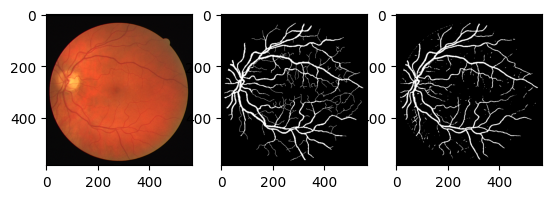

Train Epoch: 45 [0/20 (0%)]	Loss: 0.668505
Train Epoch: 45 [8/20 (33%)]	Loss: 0.697063
Train Epoch: 45 [16/20 (67%)]	Loss: 0.607149

Test set: Avg. loss: 0.7122, Accuracy: 6342234/6599200 (96%)



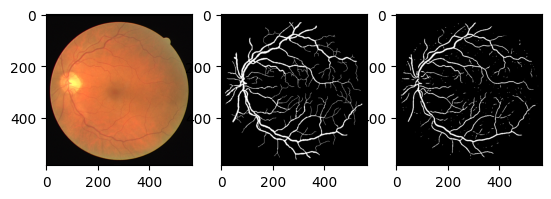

New best! Saving...
Train Epoch: 46 [0/20 (0%)]	Loss: 0.707093
Train Epoch: 46 [8/20 (33%)]	Loss: 0.637736
Train Epoch: 46 [16/20 (67%)]	Loss: 0.664821

Test set: Avg. loss: 0.7184, Accuracy: 6363339/6599200 (96%)



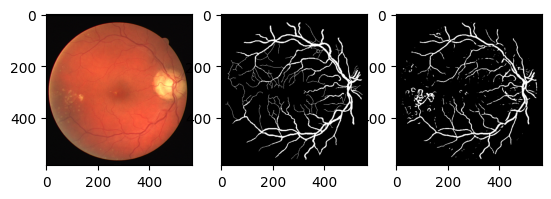

Train Epoch: 47 [0/20 (0%)]	Loss: 0.687591
Train Epoch: 47 [8/20 (33%)]	Loss: 0.645101
Train Epoch: 47 [16/20 (67%)]	Loss: 0.674514

Test set: Avg. loss: 0.7037, Accuracy: 6351291/6599200 (96%)



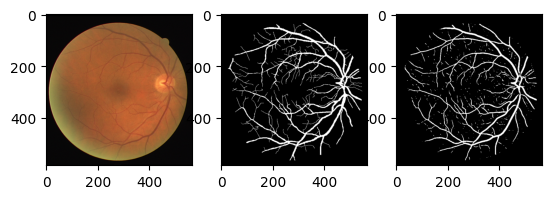

New best! Saving...
Train Epoch: 48 [0/20 (0%)]	Loss: 0.679688
Train Epoch: 48 [8/20 (33%)]	Loss: 0.648932
Train Epoch: 48 [16/20 (67%)]	Loss: 0.659832

Test set: Avg. loss: 0.7114, Accuracy: 6346137/6599200 (96%)



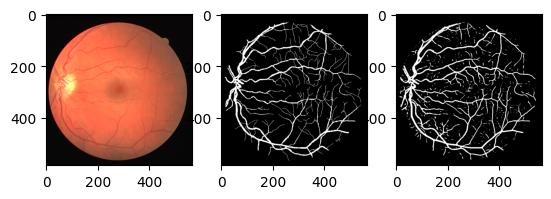

Train Epoch: 49 [0/20 (0%)]	Loss: 0.696961
Train Epoch: 49 [8/20 (33%)]	Loss: 0.624510
Train Epoch: 49 [16/20 (67%)]	Loss: 0.670850

Test set: Avg. loss: 0.7191, Accuracy: 6360766/6599200 (96%)



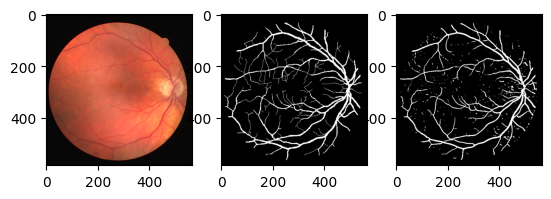

Train Epoch: 50 [0/20 (0%)]	Loss: 0.717582
Train Epoch: 50 [8/20 (33%)]	Loss: 0.600410
Train Epoch: 50 [16/20 (67%)]	Loss: 0.651628

Test set: Avg. loss: 0.7069, Accuracy: 6346735/6599200 (96%)



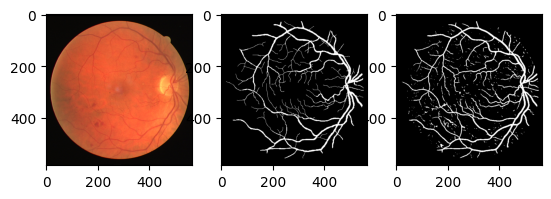

Train Epoch: 51 [0/20 (0%)]	Loss: 0.679178
Train Epoch: 51 [8/20 (33%)]	Loss: 0.618201
Train Epoch: 51 [16/20 (67%)]	Loss: 0.693349

Test set: Avg. loss: 0.7025, Accuracy: 6359448/6599200 (96%)



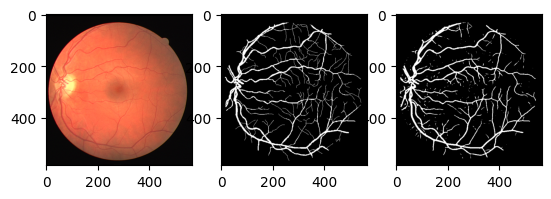

New best! Saving...
Train Epoch: 52 [0/20 (0%)]	Loss: 0.651858
Train Epoch: 52 [8/20 (33%)]	Loss: 0.676165
Train Epoch: 52 [16/20 (67%)]	Loss: 0.629525

Test set: Avg. loss: 0.7261, Accuracy: 6367480/6599200 (96%)



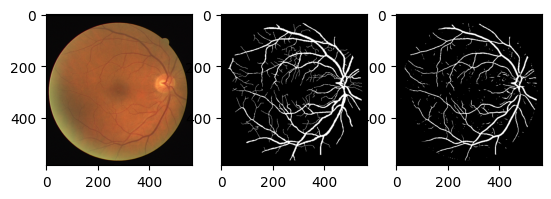

Train Epoch: 53 [0/20 (0%)]	Loss: 0.641691
Train Epoch: 53 [8/20 (33%)]	Loss: 0.685293
Train Epoch: 53 [16/20 (67%)]	Loss: 0.632587

Test set: Avg. loss: 0.7111, Accuracy: 6342916/6599200 (96%)



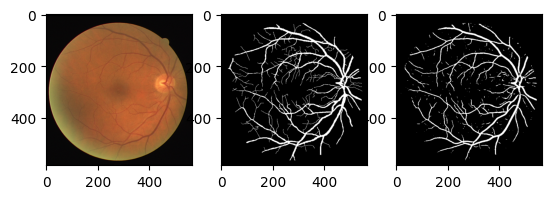

Train Epoch: 54 [0/20 (0%)]	Loss: 0.643004
Train Epoch: 54 [8/20 (33%)]	Loss: 0.644728
Train Epoch: 54 [16/20 (67%)]	Loss: 0.711221

Test set: Avg. loss: 0.6958, Accuracy: 6327491/6599200 (96%)



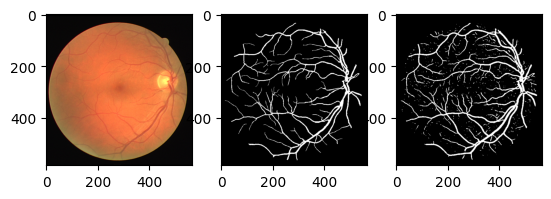

New best! Saving...
Train Epoch: 55 [0/20 (0%)]	Loss: 0.642007
Train Epoch: 55 [8/20 (33%)]	Loss: 0.664477
Train Epoch: 55 [16/20 (67%)]	Loss: 0.637142

Test set: Avg. loss: 0.7042, Accuracy: 6353598/6599200 (96%)



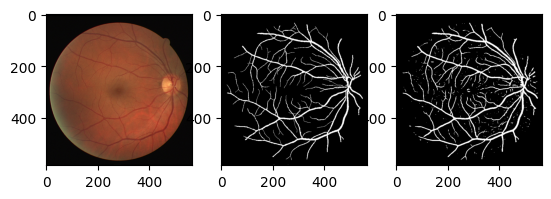

Train Epoch: 56 [0/20 (0%)]	Loss: 0.657095
Train Epoch: 56 [8/20 (33%)]	Loss: 0.671359
Train Epoch: 56 [16/20 (67%)]	Loss: 0.578576

Test set: Avg. loss: 0.7540, Accuracy: 6370212/6599200 (97%)



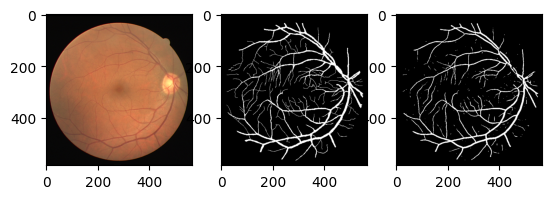

Train Epoch: 57 [0/20 (0%)]	Loss: 0.644365
Train Epoch: 57 [8/20 (33%)]	Loss: 0.614531
Train Epoch: 57 [16/20 (67%)]	Loss: 0.748394

Test set: Avg. loss: 0.6952, Accuracy: 6309391/6599200 (96%)



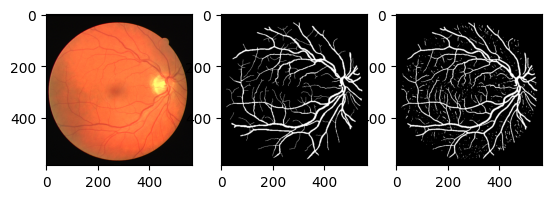

New best! Saving...
Train Epoch: 58 [0/20 (0%)]	Loss: 0.598908
Train Epoch: 58 [8/20 (33%)]	Loss: 0.637614
Train Epoch: 58 [16/20 (67%)]	Loss: 0.787209

Test set: Avg. loss: 0.6908, Accuracy: 6348155/6599200 (96%)



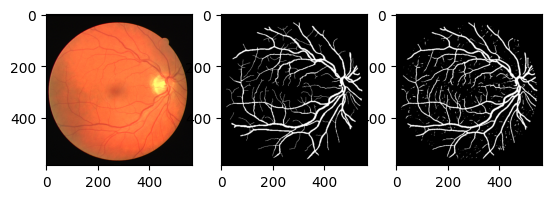

New best! Saving...
Train Epoch: 59 [0/20 (0%)]	Loss: 0.654586
Train Epoch: 59 [8/20 (33%)]	Loss: 0.628184
Train Epoch: 59 [16/20 (67%)]	Loss: 0.716931

Test set: Avg. loss: 0.7163, Accuracy: 6359713/6599200 (96%)



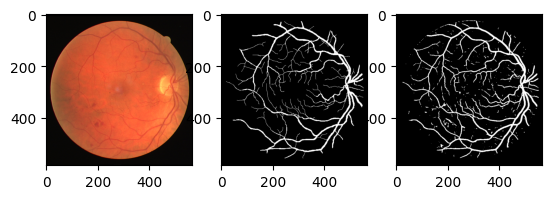

Train Epoch: 60 [0/20 (0%)]	Loss: 0.685893
Train Epoch: 60 [8/20 (33%)]	Loss: 0.646334
Train Epoch: 60 [16/20 (67%)]	Loss: 0.607339

Test set: Avg. loss: 0.7130, Accuracy: 6364962/6599200 (96%)



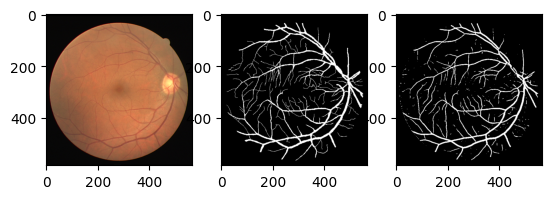

Train Epoch: 61 [0/20 (0%)]	Loss: 0.597035
Train Epoch: 61 [8/20 (33%)]	Loss: 0.680704
Train Epoch: 61 [16/20 (67%)]	Loss: 0.712835

Test set: Avg. loss: 0.6979, Accuracy: 6311476/6599200 (96%)



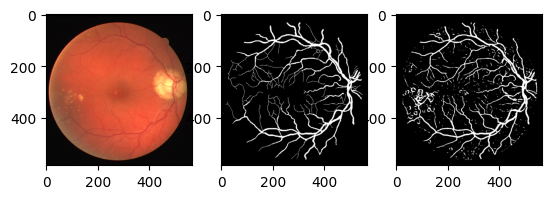

Train Epoch: 62 [0/20 (0%)]	Loss: 0.579366
Train Epoch: 62 [8/20 (33%)]	Loss: 0.738559
Train Epoch: 62 [16/20 (67%)]	Loss: 0.613638

Test set: Avg. loss: 0.7039, Accuracy: 6354287/6599200 (96%)



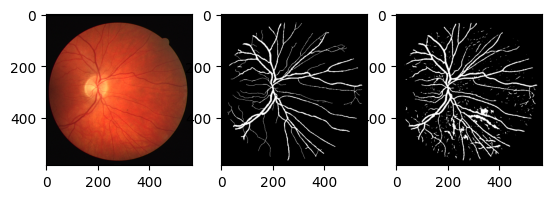

Train Epoch: 63 [0/20 (0%)]	Loss: 0.616358
Train Epoch: 63 [8/20 (33%)]	Loss: 0.665361
Train Epoch: 63 [16/20 (67%)]	Loss: 0.702747

Test set: Avg. loss: 0.6979, Accuracy: 6327589/6599200 (96%)



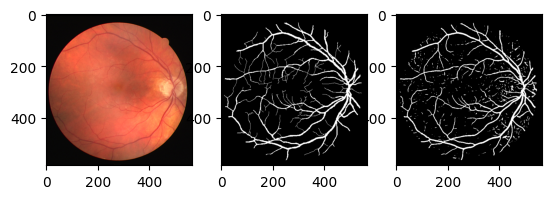

Train Epoch: 64 [0/20 (0%)]	Loss: 0.620237
Train Epoch: 64 [8/20 (33%)]	Loss: 0.683927
Train Epoch: 64 [16/20 (67%)]	Loss: 0.603430

Test set: Avg. loss: 0.7298, Accuracy: 6367386/6599200 (96%)



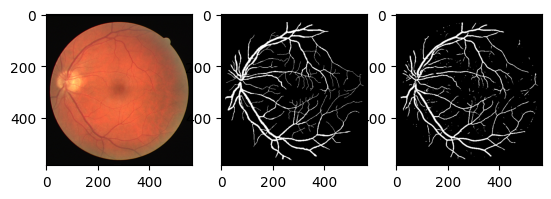

Train Epoch: 65 [0/20 (0%)]	Loss: 0.701467
Train Epoch: 65 [8/20 (33%)]	Loss: 0.606259
Train Epoch: 65 [16/20 (67%)]	Loss: 0.587339

Test set: Avg. loss: 0.7233, Accuracy: 6364281/6599200 (96%)



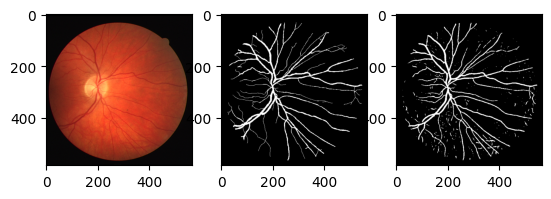

Train Epoch: 66 [0/20 (0%)]	Loss: 0.614493
Train Epoch: 66 [8/20 (33%)]	Loss: 0.701907
Train Epoch: 66 [16/20 (67%)]	Loss: 0.584282

Test set: Avg. loss: 0.7129, Accuracy: 6342029/6599200 (96%)



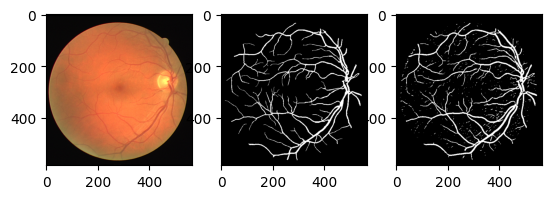

Train Epoch: 67 [0/20 (0%)]	Loss: 0.686623
Train Epoch: 67 [8/20 (33%)]	Loss: 0.590915
Train Epoch: 67 [16/20 (67%)]	Loss: 0.620969

Test set: Avg. loss: 0.6982, Accuracy: 6350729/6599200 (96%)



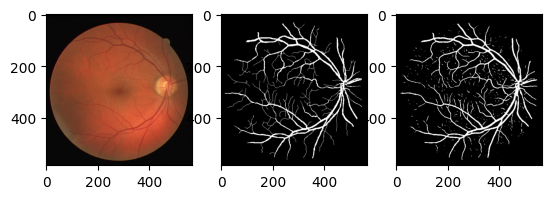

Train Epoch: 68 [0/20 (0%)]	Loss: 0.625656
Train Epoch: 68 [8/20 (33%)]	Loss: 0.662126
Train Epoch: 68 [16/20 (67%)]	Loss: 0.616748

Test set: Avg. loss: 0.7027, Accuracy: 6346363/6599200 (96%)



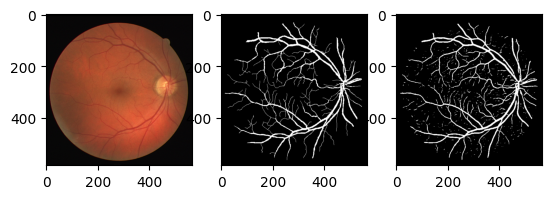

Train Epoch: 69 [0/20 (0%)]	Loss: 0.610321
Train Epoch: 69 [8/20 (33%)]	Loss: 0.717737
Train Epoch: 69 [16/20 (67%)]	Loss: 0.527016

Test set: Avg. loss: 0.6997, Accuracy: 6351925/6599200 (96%)



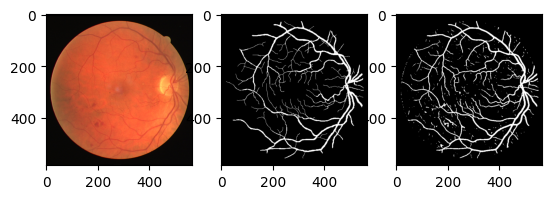

Train Epoch: 70 [0/20 (0%)]	Loss: 0.584549
Train Epoch: 70 [8/20 (33%)]	Loss: 0.667512
Train Epoch: 70 [16/20 (67%)]	Loss: 0.689768

Test set: Avg. loss: 0.7050, Accuracy: 6319177/6599200 (96%)



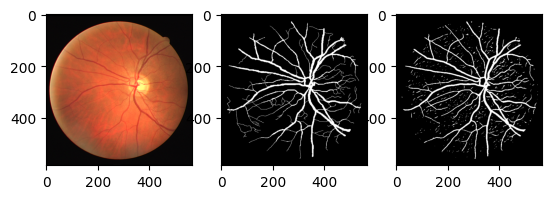

Train Epoch: 71 [0/20 (0%)]	Loss: 0.665051
Train Epoch: 71 [8/20 (33%)]	Loss: 0.617857
Train Epoch: 71 [16/20 (67%)]	Loss: 0.626945

Test set: Avg. loss: 0.7354, Accuracy: 6360367/6599200 (96%)



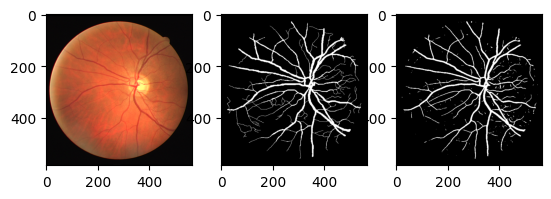

Train Epoch: 72 [0/20 (0%)]	Loss: 0.587587
Train Epoch: 72 [8/20 (33%)]	Loss: 0.665811
Train Epoch: 72 [16/20 (67%)]	Loss: 0.677830

Test set: Avg. loss: 0.7272, Accuracy: 6361713/6599200 (96%)



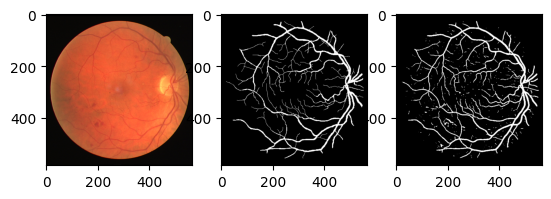

Train Epoch: 73 [0/20 (0%)]	Loss: 0.606406
Train Epoch: 73 [8/20 (33%)]	Loss: 0.647205
Train Epoch: 73 [16/20 (67%)]	Loss: 0.641260

Test set: Avg. loss: 0.7219, Accuracy: 6366552/6599200 (96%)



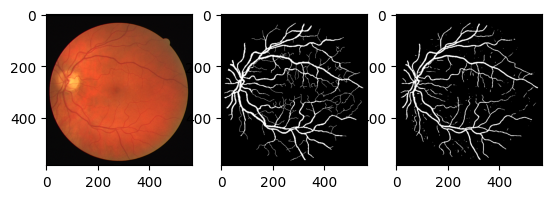

Train Epoch: 74 [0/20 (0%)]	Loss: 0.610574
Train Epoch: 74 [8/20 (33%)]	Loss: 0.646625
Train Epoch: 74 [16/20 (67%)]	Loss: 0.623011

Test set: Avg. loss: 0.7180, Accuracy: 6369997/6599200 (97%)



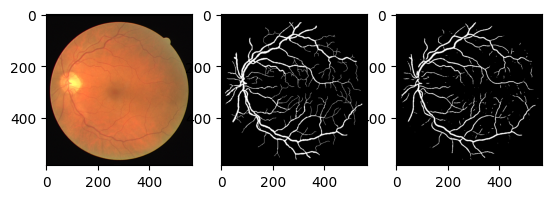

Train Epoch: 75 [0/20 (0%)]	Loss: 0.613848
Train Epoch: 75 [8/20 (33%)]	Loss: 0.607866
Train Epoch: 75 [16/20 (67%)]	Loss: 0.694491

Test set: Avg. loss: 0.7020, Accuracy: 6309526/6599200 (96%)



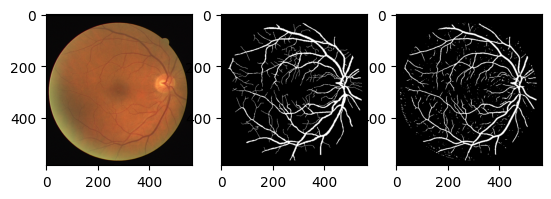

Train Epoch: 76 [0/20 (0%)]	Loss: 0.600956
Train Epoch: 76 [8/20 (33%)]	Loss: 0.676771
Train Epoch: 76 [16/20 (67%)]	Loss: 0.567848

Test set: Avg. loss: 0.7086, Accuracy: 6355387/6599200 (96%)



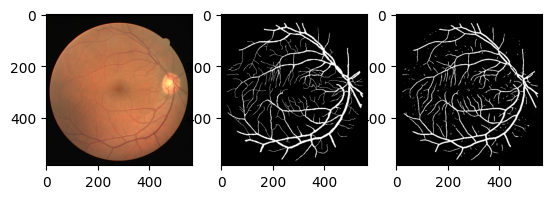

Train Epoch: 77 [0/20 (0%)]	Loss: 0.625827
Train Epoch: 77 [8/20 (33%)]	Loss: 0.606135
Train Epoch: 77 [16/20 (67%)]	Loss: 0.646898

Test set: Avg. loss: 0.6904, Accuracy: 6356248/6599200 (96%)



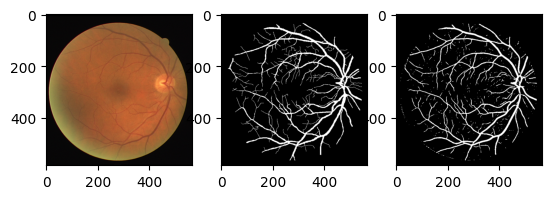

New best! Saving...
Train Epoch: 78 [0/20 (0%)]	Loss: 0.639858
Train Epoch: 78 [8/20 (33%)]	Loss: 0.592940
Train Epoch: 78 [16/20 (67%)]	Loss: 0.628368

Test set: Avg. loss: 0.6805, Accuracy: 6340587/6599200 (96%)



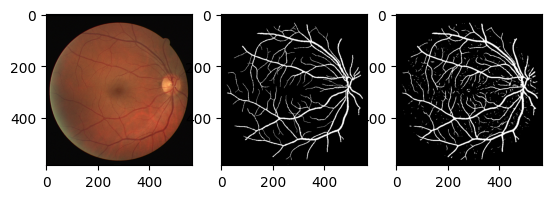

New best! Saving...
Train Epoch: 79 [0/20 (0%)]	Loss: 0.575834
Train Epoch: 79 [8/20 (33%)]	Loss: 0.674066
Train Epoch: 79 [16/20 (67%)]	Loss: 0.586719

Test set: Avg. loss: 0.6924, Accuracy: 6353541/6599200 (96%)



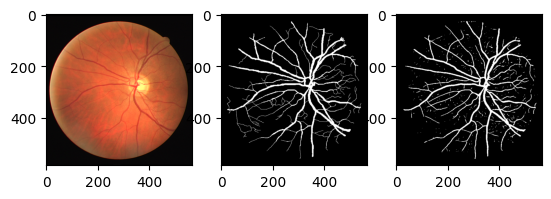

Train Epoch: 80 [0/20 (0%)]	Loss: 0.549406
Train Epoch: 80 [8/20 (33%)]	Loss: 0.683880
Train Epoch: 80 [16/20 (67%)]	Loss: 0.662099

Test set: Avg. loss: 0.7141, Accuracy: 6364163/6599200 (96%)



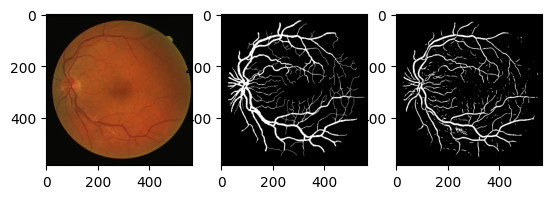

Train Epoch: 81 [0/20 (0%)]	Loss: 0.585141
Train Epoch: 81 [8/20 (33%)]	Loss: 0.699615
Train Epoch: 81 [16/20 (67%)]	Loss: 0.530043

Test set: Avg. loss: 0.7361, Accuracy: 6360045/6599200 (96%)



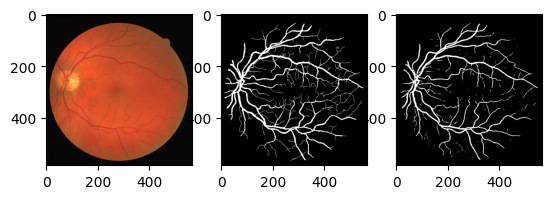

Train Epoch: 82 [0/20 (0%)]	Loss: 0.639862
Train Epoch: 82 [8/20 (33%)]	Loss: 0.578288
Train Epoch: 82 [16/20 (67%)]	Loss: 0.616918

Test set: Avg. loss: 0.7043, Accuracy: 6355741/6599200 (96%)



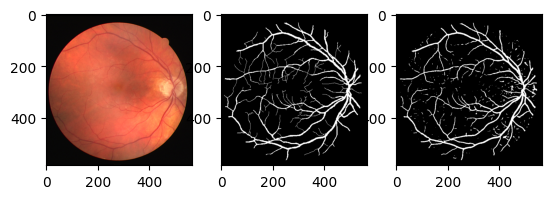

Train Epoch: 83 [0/20 (0%)]	Loss: 0.625543
Train Epoch: 83 [8/20 (33%)]	Loss: 0.571865
Train Epoch: 83 [16/20 (67%)]	Loss: 0.666468

Test set: Avg. loss: 0.6909, Accuracy: 6329568/6599200 (96%)



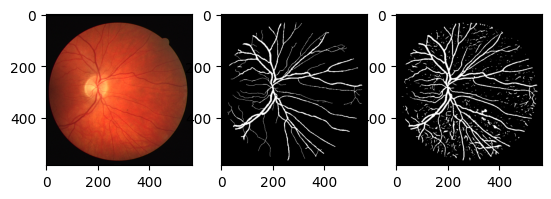

Train Epoch: 84 [0/20 (0%)]	Loss: 0.576331
Train Epoch: 84 [8/20 (33%)]	Loss: 0.645479
Train Epoch: 84 [16/20 (67%)]	Loss: 0.605664

Test set: Avg. loss: 0.6959, Accuracy: 6353529/6599200 (96%)



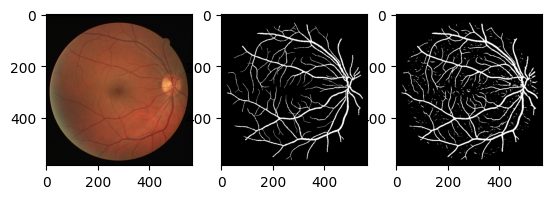

Train Epoch: 85 [0/20 (0%)]	Loss: 0.644544
Train Epoch: 85 [8/20 (33%)]	Loss: 0.539787
Train Epoch: 85 [16/20 (67%)]	Loss: 0.674202

Test set: Avg. loss: 0.7206, Accuracy: 6361295/6599200 (96%)



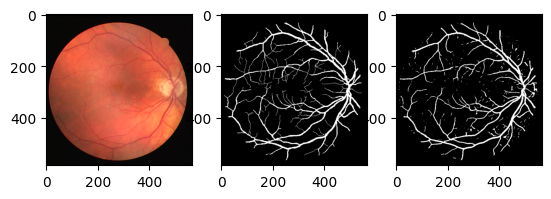

Train Epoch: 86 [0/20 (0%)]	Loss: 0.608993
Train Epoch: 86 [8/20 (33%)]	Loss: 0.621211
Train Epoch: 86 [16/20 (67%)]	Loss: 0.641770

Test set: Avg. loss: 0.7196, Accuracy: 6329149/6599200 (96%)



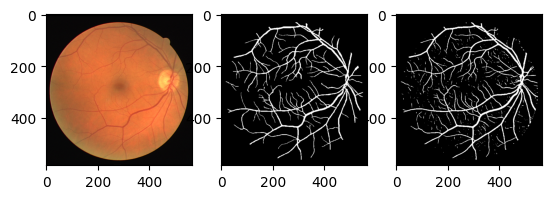

Train Epoch: 87 [0/20 (0%)]	Loss: 0.569024
Train Epoch: 87 [8/20 (33%)]	Loss: 0.708869
Train Epoch: 87 [16/20 (67%)]	Loss: 0.599506

Test set: Avg. loss: 0.7119, Accuracy: 6327500/6599200 (96%)



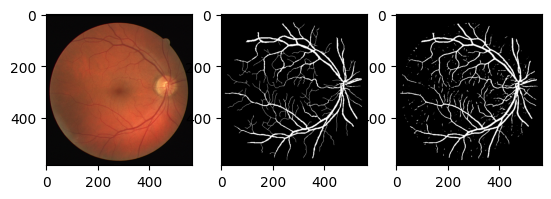

Train Epoch: 88 [0/20 (0%)]	Loss: 0.587372
Train Epoch: 88 [8/20 (33%)]	Loss: 0.625988
Train Epoch: 88 [16/20 (67%)]	Loss: 0.693711

Test set: Avg. loss: 0.7220, Accuracy: 6251654/6599200 (95%)



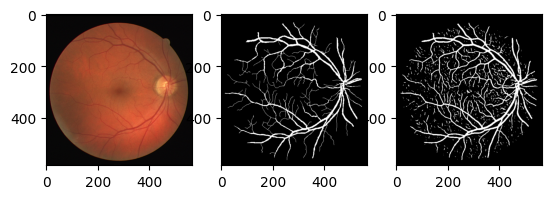

Train Epoch: 89 [0/20 (0%)]	Loss: 0.618407
Train Epoch: 89 [8/20 (33%)]	Loss: 0.634159
Train Epoch: 89 [16/20 (67%)]	Loss: 0.621957

Test set: Avg. loss: 0.8327, Accuracy: 6357066/6599200 (96%)



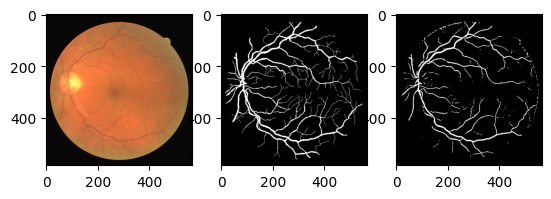

Train Epoch: 90 [0/20 (0%)]	Loss: 0.607474
Train Epoch: 90 [8/20 (33%)]	Loss: 0.683178
Train Epoch: 90 [16/20 (67%)]	Loss: 0.567343

Test set: Avg. loss: 0.7772, Accuracy: 6358504/6599200 (96%)



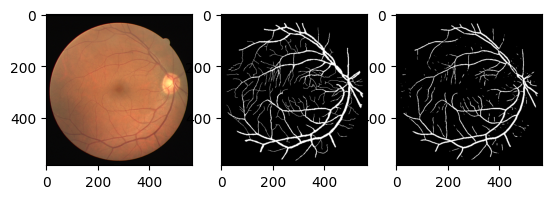

Train Epoch: 91 [0/20 (0%)]	Loss: 0.592536
Train Epoch: 91 [8/20 (33%)]	Loss: 0.655280
Train Epoch: 91 [16/20 (67%)]	Loss: 0.638833

Test set: Avg. loss: 0.7144, Accuracy: 6330476/6599200 (96%)



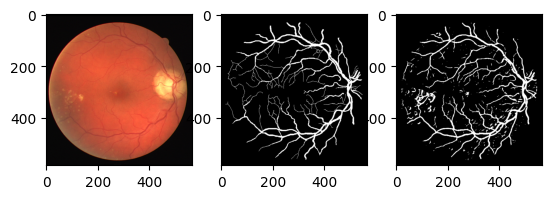

Train Epoch: 92 [0/20 (0%)]	Loss: 0.673882
Train Epoch: 92 [8/20 (33%)]	Loss: 0.591387
Train Epoch: 92 [16/20 (67%)]	Loss: 0.586819

Test set: Avg. loss: 0.7405, Accuracy: 6363008/6599200 (96%)



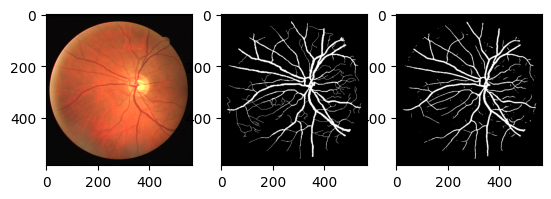

Train Epoch: 93 [0/20 (0%)]	Loss: 0.590731
Train Epoch: 93 [8/20 (33%)]	Loss: 0.654422
Train Epoch: 93 [16/20 (67%)]	Loss: 0.614364

Test set: Avg. loss: 0.6998, Accuracy: 6326787/6599200 (96%)



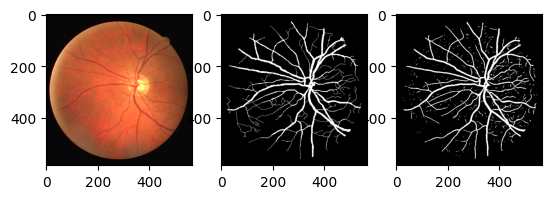

Train Epoch: 94 [0/20 (0%)]	Loss: 0.627733
Train Epoch: 94 [8/20 (33%)]	Loss: 0.574706
Train Epoch: 94 [16/20 (67%)]	Loss: 0.722444

Test set: Avg. loss: 0.7404, Accuracy: 6357044/6599200 (96%)



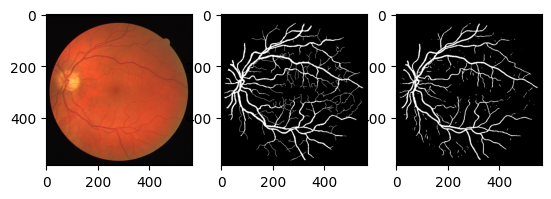

Train Epoch: 95 [0/20 (0%)]	Loss: 0.633978
Train Epoch: 95 [8/20 (33%)]	Loss: 0.592496
Train Epoch: 95 [16/20 (67%)]	Loss: 0.654060

Test set: Avg. loss: 0.7276, Accuracy: 6337572/6599200 (96%)



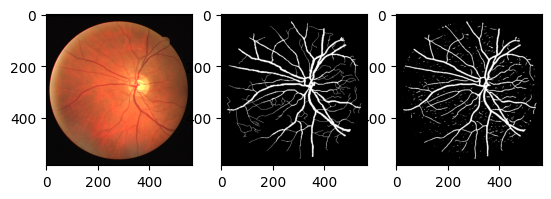

Train Epoch: 96 [0/20 (0%)]	Loss: 0.597606
Train Epoch: 96 [8/20 (33%)]	Loss: 0.624677
Train Epoch: 96 [16/20 (67%)]	Loss: 0.654407

Test set: Avg. loss: 0.6945, Accuracy: 6353149/6599200 (96%)



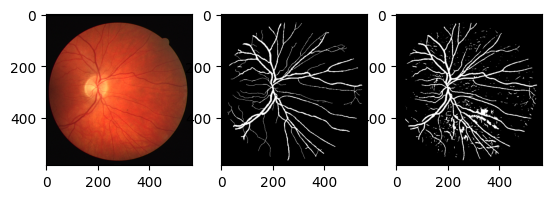

Train Epoch: 97 [0/20 (0%)]	Loss: 0.606649
Train Epoch: 97 [8/20 (33%)]	Loss: 0.586079
Train Epoch: 97 [16/20 (67%)]	Loss: 0.729222

Test set: Avg. loss: 0.7256, Accuracy: 6362541/6599200 (96%)



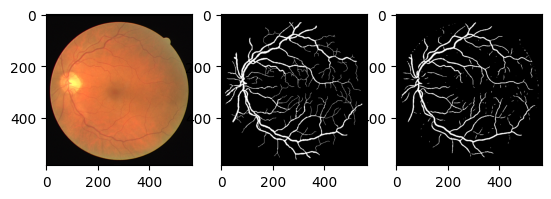

Train Epoch: 98 [0/20 (0%)]	Loss: 0.585859
Train Epoch: 98 [8/20 (33%)]	Loss: 0.623011
Train Epoch: 98 [16/20 (67%)]	Loss: 0.650296

Test set: Avg. loss: 0.7013, Accuracy: 6303491/6599200 (96%)



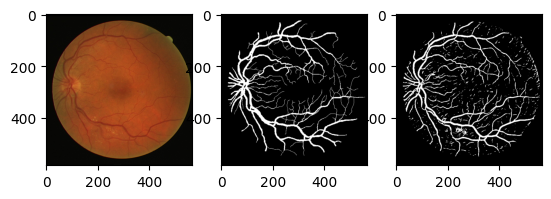

Train Epoch: 99 [0/20 (0%)]	Loss: 0.634204
Train Epoch: 99 [8/20 (33%)]	Loss: 0.602926
Train Epoch: 99 [16/20 (67%)]	Loss: 0.575615

Test set: Avg. loss: 0.7395, Accuracy: 6365860/6599200 (96%)



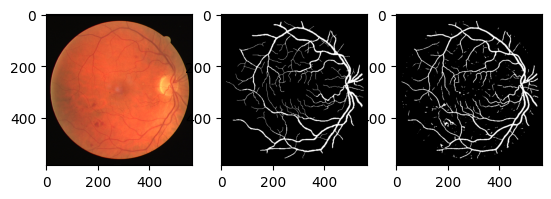

Train Epoch: 100 [0/20 (0%)]	Loss: 0.623139
Train Epoch: 100 [8/20 (33%)]	Loss: 0.624446
Train Epoch: 100 [16/20 (67%)]	Loss: 0.542280

Test set: Avg. loss: 0.7291, Accuracy: 6369779/6599200 (97%)



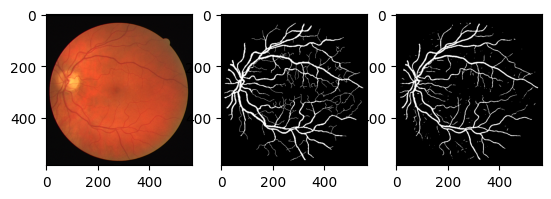

Train Epoch: 101 [0/20 (0%)]	Loss: 0.622985
Train Epoch: 101 [8/20 (33%)]	Loss: 0.593954
Train Epoch: 101 [16/20 (67%)]	Loss: 0.576572

Test set: Avg. loss: 0.6922, Accuracy: 6363022/6599200 (96%)



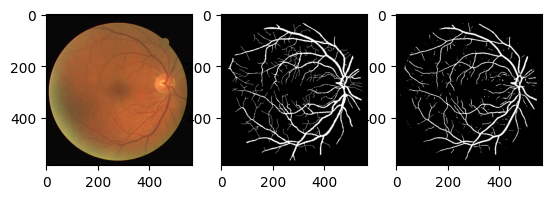

Train Epoch: 102 [0/20 (0%)]	Loss: 0.590734
Train Epoch: 102 [8/20 (33%)]	Loss: 0.603721
Train Epoch: 102 [16/20 (67%)]	Loss: 0.576474

Test set: Avg. loss: 0.6857, Accuracy: 6348716/6599200 (96%)



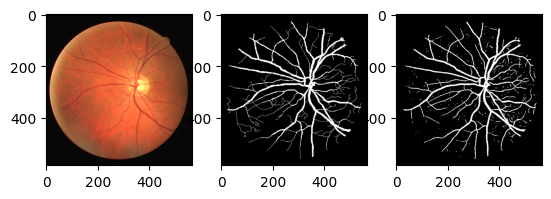

Train Epoch: 103 [0/20 (0%)]	Loss: 0.555300
Train Epoch: 103 [8/20 (33%)]	Loss: 0.605145
Train Epoch: 103 [16/20 (67%)]	Loss: 0.646781

Test set: Avg. loss: 0.6904, Accuracy: 6353815/6599200 (96%)



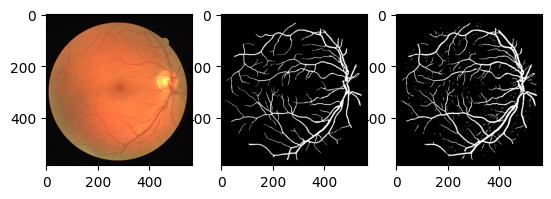

Train Epoch: 104 [0/20 (0%)]	Loss: 0.599496
Train Epoch: 104 [8/20 (33%)]	Loss: 0.568369
Train Epoch: 104 [16/20 (67%)]	Loss: 0.606925

Test set: Avg. loss: 0.6932, Accuracy: 6351330/6599200 (96%)



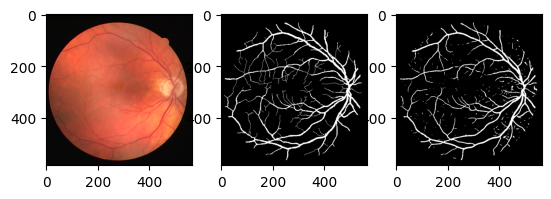

Train Epoch: 105 [0/20 (0%)]	Loss: 0.550929
Train Epoch: 105 [8/20 (33%)]	Loss: 0.599156
Train Epoch: 105 [16/20 (67%)]	Loss: 0.640028

Test set: Avg. loss: 0.6960, Accuracy: 6352159/6599200 (96%)



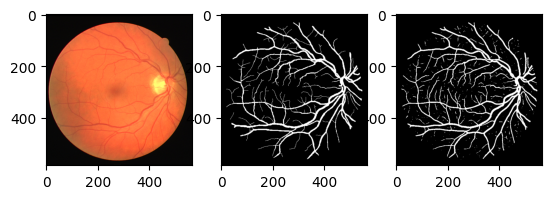

Train Epoch: 106 [0/20 (0%)]	Loss: 0.592961
Train Epoch: 106 [8/20 (33%)]	Loss: 0.581586
Train Epoch: 106 [16/20 (67%)]	Loss: 0.572037

Test set: Avg. loss: 0.7042, Accuracy: 6355886/6599200 (96%)



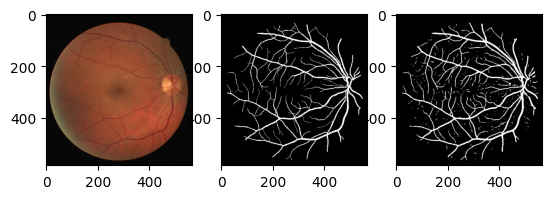

Train Epoch: 107 [0/20 (0%)]	Loss: 0.596404
Train Epoch: 107 [8/20 (33%)]	Loss: 0.573256
Train Epoch: 107 [16/20 (67%)]	Loss: 0.562497

Test set: Avg. loss: 0.6943, Accuracy: 6343706/6599200 (96%)



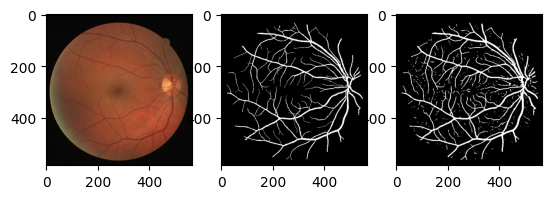

Train Epoch: 108 [0/20 (0%)]	Loss: 0.552983
Train Epoch: 108 [8/20 (33%)]	Loss: 0.631850
Train Epoch: 108 [16/20 (67%)]	Loss: 0.547059

Test set: Avg. loss: 0.6990, Accuracy: 6341876/6599200 (96%)



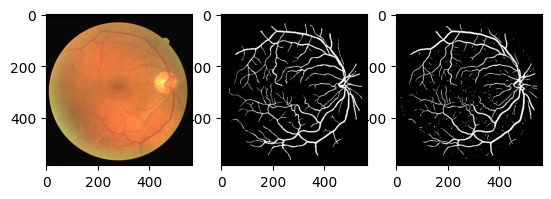

Train Epoch: 109 [0/20 (0%)]	Loss: 0.545306
Train Epoch: 109 [8/20 (33%)]	Loss: 0.615459
Train Epoch: 109 [16/20 (67%)]	Loss: 0.564682

Test set: Avg. loss: 0.6955, Accuracy: 6341812/6599200 (96%)



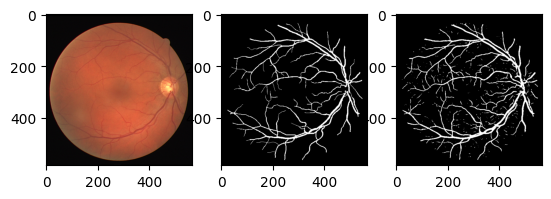

Train Epoch: 110 [0/20 (0%)]	Loss: 0.518866
Train Epoch: 110 [8/20 (33%)]	Loss: 0.604134
Train Epoch: 110 [16/20 (67%)]	Loss: 0.647792

Test set: Avg. loss: 0.6949, Accuracy: 6325535/6599200 (96%)



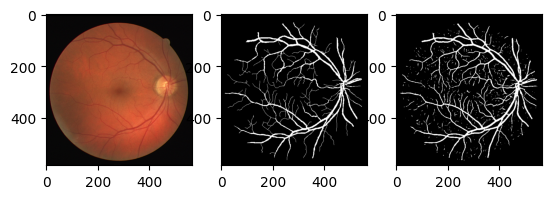

Train Epoch: 111 [0/20 (0%)]	Loss: 0.563351
Train Epoch: 111 [8/20 (33%)]	Loss: 0.575374
Train Epoch: 111 [16/20 (67%)]	Loss: 0.596205

Test set: Avg. loss: 0.6982, Accuracy: 6328719/6599200 (96%)



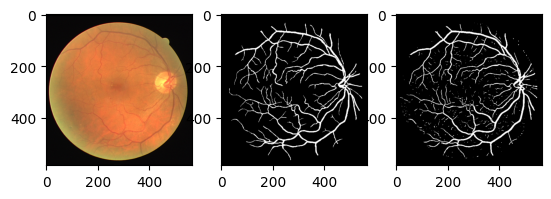

Train Epoch: 112 [0/20 (0%)]	Loss: 0.588307
Train Epoch: 112 [8/20 (33%)]	Loss: 0.559848
Train Epoch: 112 [16/20 (67%)]	Loss: 0.583602

Test set: Avg. loss: 0.7116, Accuracy: 6356168/6599200 (96%)



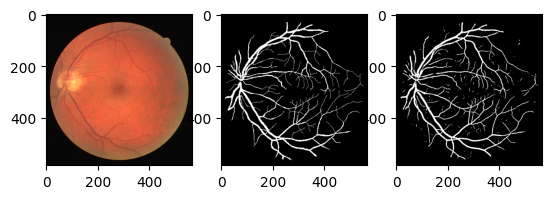

Train Epoch: 113 [0/20 (0%)]	Loss: 0.618438
Train Epoch: 113 [8/20 (33%)]	Loss: 0.519891
Train Epoch: 113 [16/20 (67%)]	Loss: 0.582871

Test set: Avg. loss: 0.7236, Accuracy: 6355753/6599200 (96%)



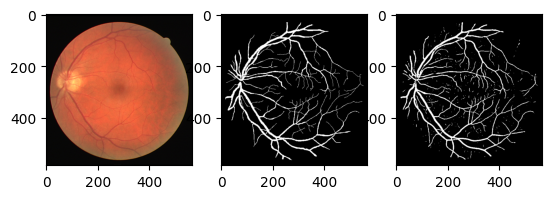

Train Epoch: 114 [0/20 (0%)]	Loss: 0.521516
Train Epoch: 114 [8/20 (33%)]	Loss: 0.612236
Train Epoch: 114 [16/20 (67%)]	Loss: 0.593923

Test set: Avg. loss: 0.7040, Accuracy: 6333043/6599200 (96%)



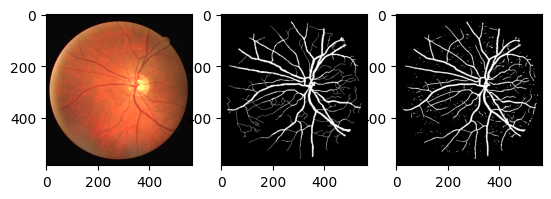

Train Epoch: 115 [0/20 (0%)]	Loss: 0.554163
Train Epoch: 115 [8/20 (33%)]	Loss: 0.579969
Train Epoch: 115 [16/20 (67%)]	Loss: 0.598883

Test set: Avg. loss: 0.7025, Accuracy: 6326740/6599200 (96%)



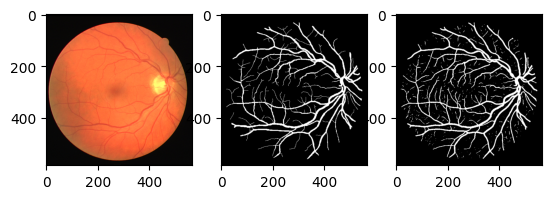

Train Epoch: 116 [0/20 (0%)]	Loss: 0.591368
Train Epoch: 116 [8/20 (33%)]	Loss: 0.578810
Train Epoch: 116 [16/20 (67%)]	Loss: 0.511954

Test set: Avg. loss: 0.7027, Accuracy: 6338062/6599200 (96%)



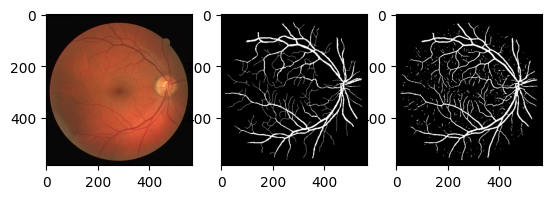

Train Epoch: 117 [0/20 (0%)]	Loss: 0.566890
Train Epoch: 117 [8/20 (33%)]	Loss: 0.589620
Train Epoch: 117 [16/20 (67%)]	Loss: 0.518798

Test set: Avg. loss: 0.7155, Accuracy: 6360511/6599200 (96%)



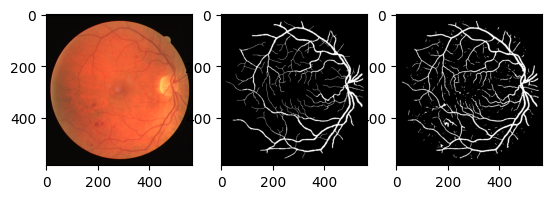

Train Epoch: 118 [0/20 (0%)]	Loss: 0.596485
Train Epoch: 118 [8/20 (33%)]	Loss: 0.557034
Train Epoch: 118 [16/20 (67%)]	Loss: 0.518419

Test set: Avg. loss: 0.7043, Accuracy: 6345574/6599200 (96%)



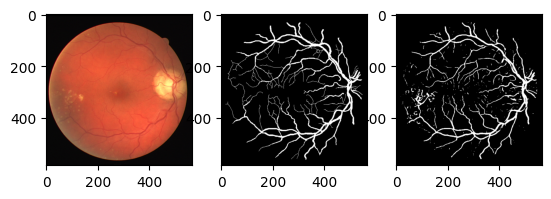

Train Epoch: 119 [0/20 (0%)]	Loss: 0.524175
Train Epoch: 119 [8/20 (33%)]	Loss: 0.601063
Train Epoch: 119 [16/20 (67%)]	Loss: 0.573927

Test set: Avg. loss: 0.7009, Accuracy: 6327677/6599200 (96%)



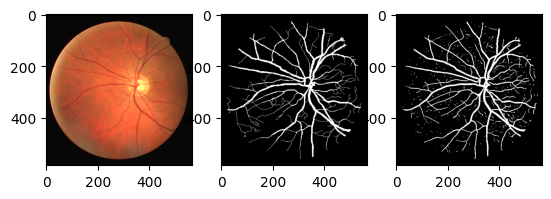

Train Epoch: 120 [0/20 (0%)]	Loss: 0.530362
Train Epoch: 120 [8/20 (33%)]	Loss: 0.574558
Train Epoch: 120 [16/20 (67%)]	Loss: 0.610005

Test set: Avg. loss: 0.7075, Accuracy: 6335262/6599200 (96%)



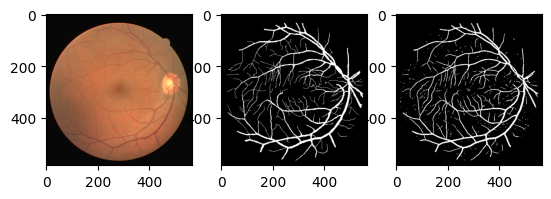

Train Epoch: 121 [0/20 (0%)]	Loss: 0.606614
Train Epoch: 121 [8/20 (33%)]	Loss: 0.571333
Train Epoch: 121 [16/20 (67%)]	Loss: 0.481327

Test set: Avg. loss: 0.7164, Accuracy: 6344074/6599200 (96%)



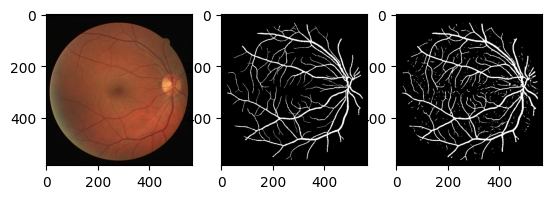

Train Epoch: 122 [0/20 (0%)]	Loss: 0.609663
Train Epoch: 122 [8/20 (33%)]	Loss: 0.520191
Train Epoch: 122 [16/20 (67%)]	Loss: 0.557410

Test set: Avg. loss: 0.7278, Accuracy: 6354068/6599200 (96%)



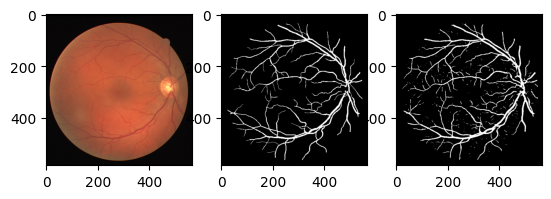

Train Epoch: 123 [0/20 (0%)]	Loss: 0.523964
Train Epoch: 123 [8/20 (33%)]	Loss: 0.579728
Train Epoch: 123 [16/20 (67%)]	Loss: 0.584407

Test set: Avg. loss: 0.7085, Accuracy: 6330577/6599200 (96%)



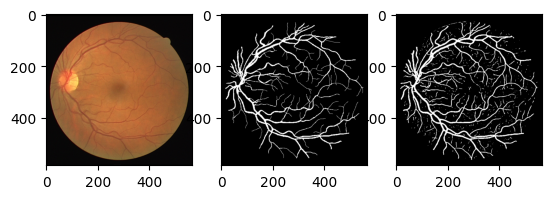

Train Epoch: 124 [0/20 (0%)]	Loss: 0.586841
Train Epoch: 124 [8/20 (33%)]	Loss: 0.536515
Train Epoch: 124 [16/20 (67%)]	Loss: 0.568403

Test set: Avg. loss: 0.7154, Accuracy: 6321539/6599200 (96%)



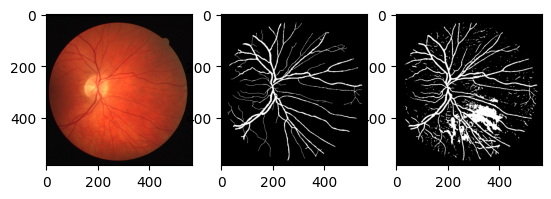

Train Epoch: 125 [0/20 (0%)]	Loss: 0.579503
Train Epoch: 125 [8/20 (33%)]	Loss: 0.563424
Train Epoch: 125 [16/20 (67%)]	Loss: 0.580297

Test set: Avg. loss: 0.7234, Accuracy: 6346198/6599200 (96%)



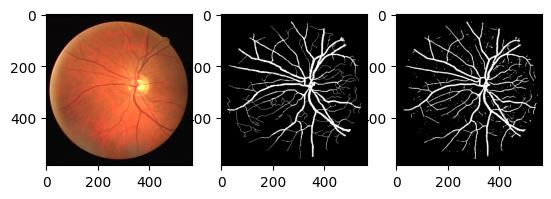

Train Epoch: 126 [0/20 (0%)]	Loss: 0.508271
Train Epoch: 126 [8/20 (33%)]	Loss: 0.597698
Train Epoch: 126 [16/20 (67%)]	Loss: 0.619862

Test set: Avg. loss: 0.7110, Accuracy: 6313600/6599200 (96%)



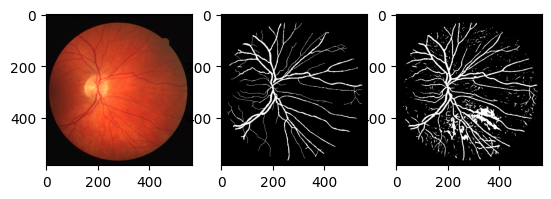

Train Epoch: 127 [0/20 (0%)]	Loss: 0.581599
Train Epoch: 127 [8/20 (33%)]	Loss: 0.553775
Train Epoch: 127 [16/20 (67%)]	Loss: 0.559983

Test set: Avg. loss: 0.7052, Accuracy: 6320189/6599200 (96%)



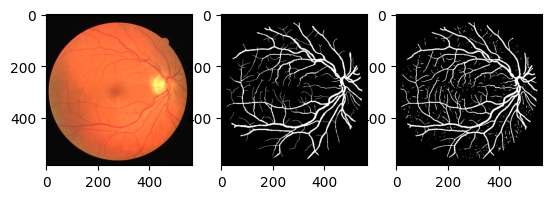

Train Epoch: 128 [0/20 (0%)]	Loss: 0.513882
Train Epoch: 128 [8/20 (33%)]	Loss: 0.616198
Train Epoch: 128 [16/20 (67%)]	Loss: 0.545204

Test set: Avg. loss: 0.7309, Accuracy: 6350066/6599200 (96%)



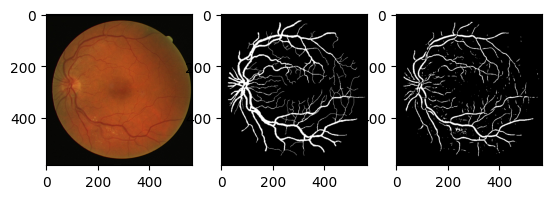

Train Epoch: 129 [0/20 (0%)]	Loss: 0.560149
Train Epoch: 129 [8/20 (33%)]	Loss: 0.523639
Train Epoch: 129 [16/20 (67%)]	Loss: 0.643819

Test set: Avg. loss: 0.7153, Accuracy: 6335370/6599200 (96%)



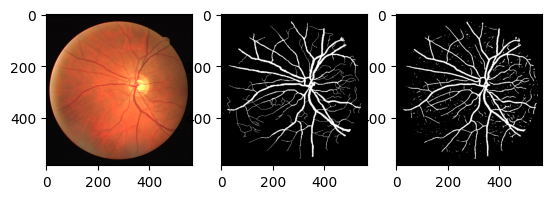

Train Epoch: 130 [0/20 (0%)]	Loss: 0.519638
Train Epoch: 130 [8/20 (33%)]	Loss: 0.582814
Train Epoch: 130 [16/20 (67%)]	Loss: 0.577603

Test set: Avg. loss: 0.7171, Accuracy: 6340603/6599200 (96%)



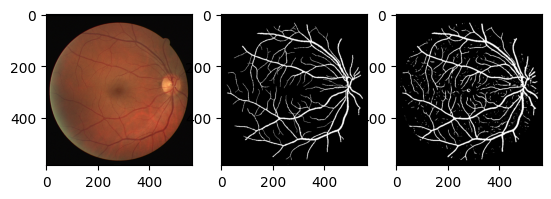

Train Epoch: 131 [0/20 (0%)]	Loss: 0.520580
Train Epoch: 131 [8/20 (33%)]	Loss: 0.559418
Train Epoch: 131 [16/20 (67%)]	Loss: 0.630548

Test set: Avg. loss: 0.7270, Accuracy: 6338798/6599200 (96%)



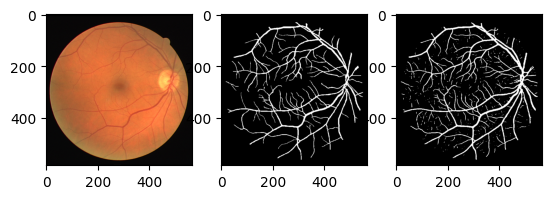

Train Epoch: 132 [0/20 (0%)]	Loss: 0.572061
Train Epoch: 132 [8/20 (33%)]	Loss: 0.539691
Train Epoch: 132 [16/20 (67%)]	Loss: 0.552215

Test set: Avg. loss: 0.7190, Accuracy: 6331266/6599200 (96%)



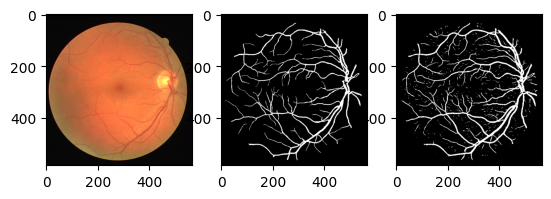

Train Epoch: 133 [0/20 (0%)]	Loss: 0.540157
Train Epoch: 133 [8/20 (33%)]	Loss: 0.562472
Train Epoch: 133 [16/20 (67%)]	Loss: 0.562373

Test set: Avg. loss: 0.7267, Accuracy: 6352566/6599200 (96%)



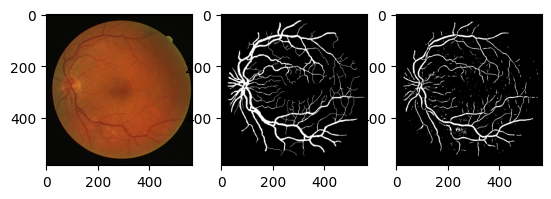

Train Epoch: 134 [0/20 (0%)]	Loss: 0.575377
Train Epoch: 134 [8/20 (33%)]	Loss: 0.544436
Train Epoch: 134 [16/20 (67%)]	Loss: 0.522691

Test set: Avg. loss: 0.7222, Accuracy: 6342667/6599200 (96%)



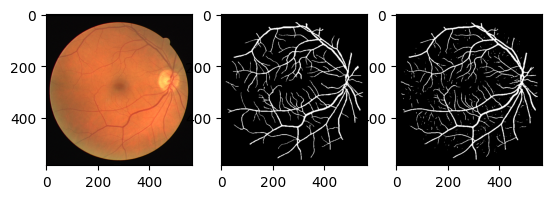

Train Epoch: 135 [0/20 (0%)]	Loss: 0.549337
Train Epoch: 135 [8/20 (33%)]	Loss: 0.561299
Train Epoch: 135 [16/20 (67%)]	Loss: 0.527310

Test set: Avg. loss: 0.7331, Accuracy: 6341353/6599200 (96%)



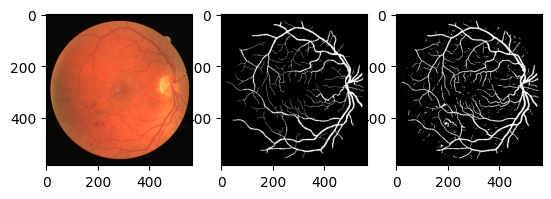

Train Epoch: 136 [0/20 (0%)]	Loss: 0.564622
Train Epoch: 136 [8/20 (33%)]	Loss: 0.545674
Train Epoch: 136 [16/20 (67%)]	Loss: 0.539318

Test set: Avg. loss: 0.7125, Accuracy: 6331127/6599200 (96%)



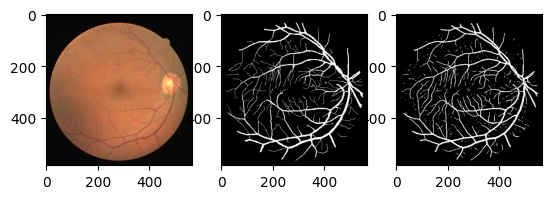

Train Epoch: 137 [0/20 (0%)]	Loss: 0.532561
Train Epoch: 137 [8/20 (33%)]	Loss: 0.564707
Train Epoch: 137 [16/20 (67%)]	Loss: 0.528998

Test set: Avg. loss: 0.7103, Accuracy: 6332176/6599200 (96%)



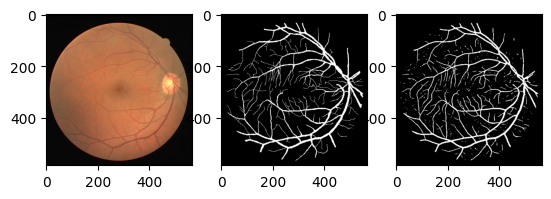

Train Epoch: 138 [0/20 (0%)]	Loss: 0.551501
Train Epoch: 138 [8/20 (33%)]	Loss: 0.557656
Train Epoch: 138 [16/20 (67%)]	Loss: 0.514159

Test set: Avg. loss: 0.7312, Accuracy: 6346037/6599200 (96%)



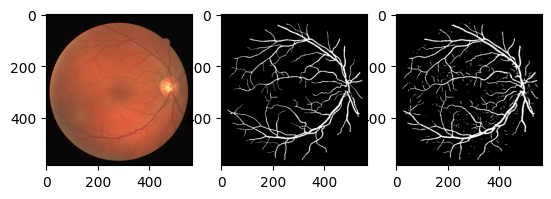

Train Epoch: 139 [0/20 (0%)]	Loss: 0.579533
Train Epoch: 139 [8/20 (33%)]	Loss: 0.506983
Train Epoch: 139 [16/20 (67%)]	Loss: 0.554076

Test set: Avg. loss: 0.7498, Accuracy: 6338682/6599200 (96%)



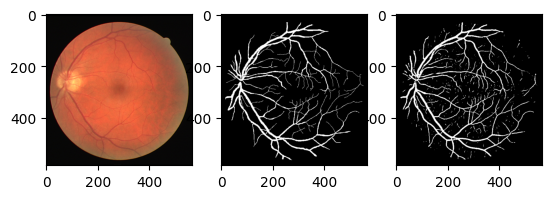

Train Epoch: 140 [0/20 (0%)]	Loss: 0.570441
Train Epoch: 140 [8/20 (33%)]	Loss: 0.551852
Train Epoch: 140 [16/20 (67%)]	Loss: 0.487429

Test set: Avg. loss: 0.7314, Accuracy: 6339063/6599200 (96%)



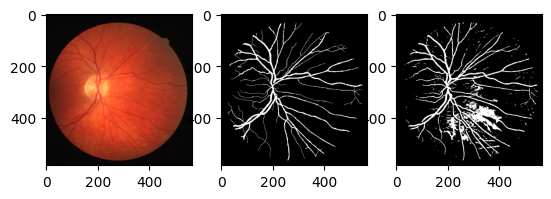

Train Epoch: 141 [0/20 (0%)]	Loss: 0.555801
Train Epoch: 141 [8/20 (33%)]	Loss: 0.549182
Train Epoch: 141 [16/20 (67%)]	Loss: 0.513574

Test set: Avg. loss: 0.7338, Accuracy: 6345925/6599200 (96%)



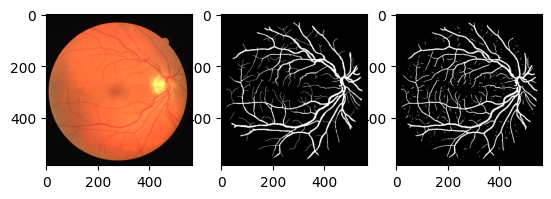

Train Epoch: 142 [0/20 (0%)]	Loss: 0.575291
Train Epoch: 142 [8/20 (33%)]	Loss: 0.500881
Train Epoch: 142 [16/20 (67%)]	Loss: 0.559738

Test set: Avg. loss: 0.7322, Accuracy: 6340747/6599200 (96%)



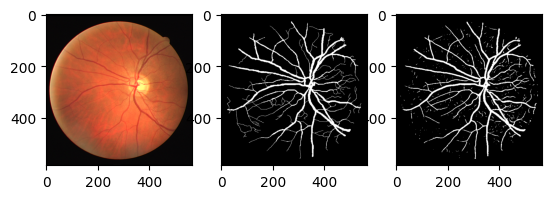

Train Epoch: 143 [0/20 (0%)]	Loss: 0.563474
Train Epoch: 143 [8/20 (33%)]	Loss: 0.518920
Train Epoch: 143 [16/20 (67%)]	Loss: 0.538543

Test set: Avg. loss: 0.7440, Accuracy: 6335265/6599200 (96%)



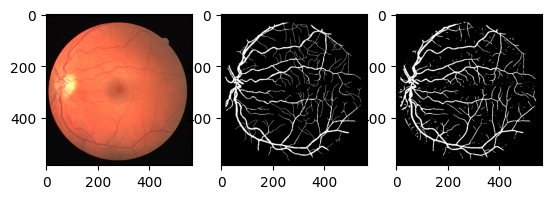

Train Epoch: 144 [0/20 (0%)]	Loss: 0.537539
Train Epoch: 144 [8/20 (33%)]	Loss: 0.593093
Train Epoch: 144 [16/20 (67%)]	Loss: 0.449065

Test set: Avg. loss: 0.7552, Accuracy: 6352635/6599200 (96%)



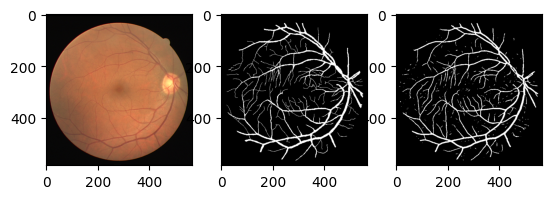

Train Epoch: 145 [0/20 (0%)]	Loss: 0.563990
Train Epoch: 145 [8/20 (33%)]	Loss: 0.493618
Train Epoch: 145 [16/20 (67%)]	Loss: 0.592619

Test set: Avg. loss: 0.7305, Accuracy: 6339145/6599200 (96%)



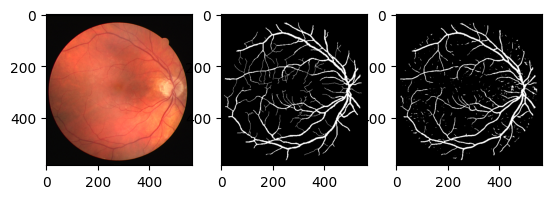

Train Epoch: 146 [0/20 (0%)]	Loss: 0.547299
Train Epoch: 146 [8/20 (33%)]	Loss: 0.531166
Train Epoch: 146 [16/20 (67%)]	Loss: 0.539570

Test set: Avg. loss: 0.7412, Accuracy: 6320419/6599200 (96%)



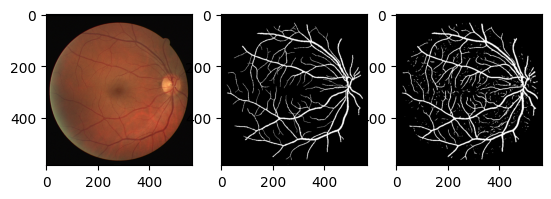

Train Epoch: 147 [0/20 (0%)]	Loss: 0.508869
Train Epoch: 147 [8/20 (33%)]	Loss: 0.535231
Train Epoch: 147 [16/20 (67%)]	Loss: 0.613187

Test set: Avg. loss: 0.7450, Accuracy: 6339926/6599200 (96%)



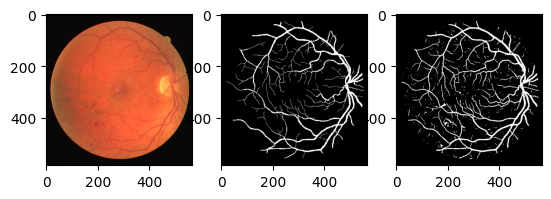

Train Epoch: 148 [0/20 (0%)]	Loss: 0.597988
Train Epoch: 148 [8/20 (33%)]	Loss: 0.497355
Train Epoch: 148 [16/20 (67%)]	Loss: 0.526544

Test set: Avg. loss: 0.7245, Accuracy: 6328605/6599200 (96%)



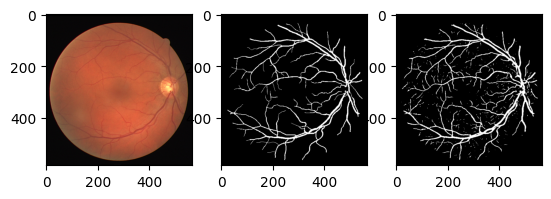

Train Epoch: 149 [0/20 (0%)]	Loss: 0.553957
Train Epoch: 149 [8/20 (33%)]	Loss: 0.493220
Train Epoch: 149 [16/20 (67%)]	Loss: 0.601993

Test set: Avg. loss: 0.7375, Accuracy: 6334909/6599200 (96%)



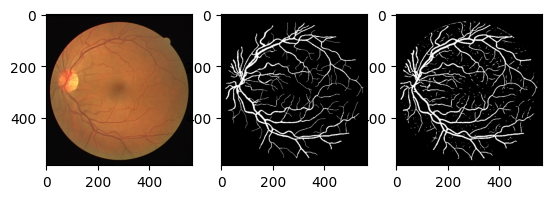

Train Epoch: 150 [0/20 (0%)]	Loss: 0.544388
Train Epoch: 150 [8/20 (33%)]	Loss: 0.554787
Train Epoch: 150 [16/20 (67%)]	Loss: 0.478928

Test set: Avg. loss: 0.7431, Accuracy: 6260855/6599200 (95%)



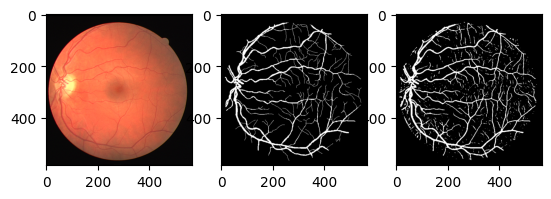

In [15]:
test(network, test_loader, loss_fn, batch_size_test,  test_losses, test_counter)
best=test_losses[-1]
for epoch in range(1, n_epochs + 1):
  train(network, train_loader, epoch, optimizer, loss_fn, log_interval, batch_size_train, train_losses, train_counter)
  test(network, test_loader, loss_fn, batch_size_test,  test_losses, test_counter)
  if test_losses[-1] < best:
    best=test_losses[-1]
    print("New best! Saving...")
    torch.save(network.state_dict(), parameters_file)
  scheduler.step()

torch.save((train_counter, train_losses, test_losses), training_data_file)

torch.Size([3, 584, 565])
torch.Size([584, 565, 3])
torch.Size([584, 565])
tensor([0, 1])
torch.Size([2, 584, 565])
torch.Size([3, 584, 565])
torch.Size([584, 565, 3])
torch.Size([584, 565])
tensor([0, 1])
torch.Size([2, 584, 565])
torch.Size([3, 584, 565])
torch.Size([584, 565, 3])
torch.Size([584, 565])
tensor([0, 1])
torch.Size([2, 584, 565])
torch.Size([3, 584, 565])
torch.Size([584, 565, 3])
torch.Size([584, 565])
tensor([0, 1])
torch.Size([2, 584, 565])
torch.Size([3, 584, 565])
torch.Size([584, 565, 3])
torch.Size([584, 565])
tensor([0, 1])
torch.Size([2, 584, 565])


<Figure size 640x480 with 0 Axes>

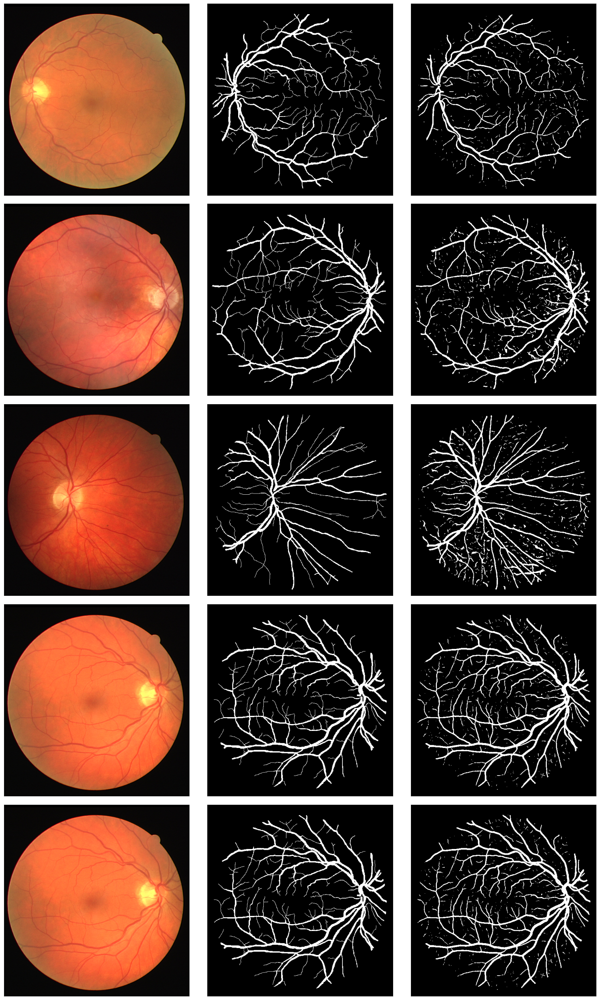

In [30]:

network.load_state_dict(torch.load(parameters_file))
fig = plt.figure()
length=5
begin=0
visualization_range = np.random.choice(len(test_data), length)
example_data = torch.stack([test_data[i][0] for i in visualization_range])
example_targets = torch.stack([test_data[i][1] for i in visualization_range])
network.eval()
plt.figure(figsize=(3*5, length*5))
for i in range(length):
  print(example_data[i].shape)

  data = example_data[i].movedim(0, 2)

  print(data.shape)
  plt.subplot(length,3,3*i+1)
  plt.tight_layout()
  plt.imshow(data)
  plt.xticks([])
  plt.yticks([])
  target = example_targets[i]

  print (target.shape)
  plt.subplot(length,3,3*i+2)
  plt.tight_layout()
  plt.imshow(target, cmap='gray')
  plt.xticks([])
  plt.yticks([])

  print(torch.unique(target))
  with torch.no_grad():
    output = network(example_data[i].to(device).unsqueeze(0)).squeeze(0)
    print (output.shape)
    plt.subplot(length,3,3*i+3)
    plt.tight_layout()
    plt.imshow(output.cpu().argmax(-3) , cmap='gray')
    plt.xticks([])
    plt.yticks([])


Best: 0.6804683804512024


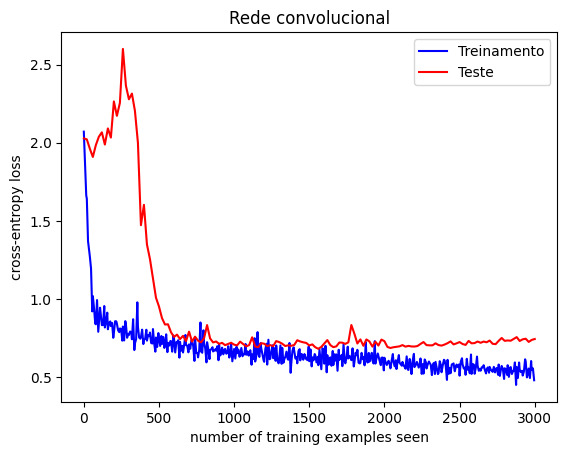

In [31]:
(train_counter, train_losses, test_losses) = torch.load( training_data_file)
fig = plt.figure()
test_counter = [i*len(train_loader.dataset) for i in range(len(test_losses))]
for i in range(len(train_losses)):
  train_losses[i] = train_losses[i].cpu().detach()

for i in range(len(test_losses)):
  test_losses[i] = test_losses[i].cpu().detach()

plt.plot(train_counter, train_losses, color='blue', label='Treinamento')
plt.plot(test_counter, test_losses, color='red', label='Teste')
plt.legend(['Train Loss', 'Test Loss'], loc='upper right')
plt.xlabel('number of training examples seen')
plt.ylabel('cross-entropy loss')
plt.legend()
plt.title("Rede convolucional")

print(f"Best: {min(test_losses)}")

In [18]:
gc.collect()
torch.cuda.empty_cache()

## Versão maior

In [19]:
class UNetBlock(nn.Module):

  def __init__(self, in_channels, out_channels):
    super().__init__()

    self.seq=nn.Sequential(
      nn.Conv2d(in_channels, out_channels, 3, padding='same'),
      nn.ReLU(),
      nn.BatchNorm2d(out_channels),
      nn.Conv2d(out_channels, out_channels, 3, padding='same'),
      nn.ReLU())

  def forward(self, x):
    return self.seq(x)

class UpConvBlock(nn.Module):
  def __init__(self, in_channels, out_channels):
    super().__init__()

    self.ct= nn.Sequential(
      nn.ConvTranspose2d(in_channels, out_channels, kernel_size=2, stride=2),
      nn.ReLU())


  def forward(self, x, i):
    o = self.ct(x)

    padding = [0, 0, 0, 0]
    if o.shape[-1] == (i.shape[-1] - 1):
      padding[0] = 1
    if o.shape[-2] == (i.shape[-2] - 1):
      padding[2] = 1

    o = torch.nn.functional.pad(o, padding, mode='replicate')

    return torch.cat([i, o], dim=1)

class UNetGiga(nn.Module):
    def __init__(self):
        super().__init__()


        self.e1=UNetBlock(3, 64)
        self.me1=nn.MaxPool2d(2)

        self.e2=UNetBlock(64, 128)
        self.me2=nn.MaxPool2d(2)

        self.e3=UNetBlock(128, 256)
        self.me3=nn.MaxPool2d(2)


        self.bt=UNetBlock(256, 512)


        self.ct3=UpConvBlock(512, 256)
        self.d3=UNetBlock(512, 256)

        self.ct2=UpConvBlock(256, 128)
        self.d2=UNetBlock(256, 128)

        self.ct1=UpConvBlock(128, 64)
        self.d1=UNetBlock(128, 64)

        self.cls = nn.Sequential(
            nn.Conv2d(64, 2, kernel_size=1),
            nn.ReLU()
        )



    def forward(self, x):
        i1 = self.e1(x)
        i2 = self.e2(self.me1(i1))
        i3 = self.e3(self.me2(i2))

        b = self.bt(self.me3(i3))

        o3 = self.d3( self.ct3(b, i3) )
        o2 = self.d2( self.ct2(o3, i2) )
        o1 = self.d1( self.ct1(o2, i1) )

        cls = self.cls(o1)

        return cls





In [32]:
random_seed = 42
torch.manual_seed(random_seed)
device = 'cuda' if torch.cuda.is_available() else 'cpu'
parameters_file='/content/drive/MyDrive/modelos/segmentacao_vasos/parameters_giga.pth'
saved_parameters_file='/content/drive/MyDrive/modelos/segmentacao_vasos/best_parameters_giga.pth'
training_data_file='/content/drive/MyDrive/modelos/segmentacao_vasos/treinamento_giga.pickle'
batch_size_train = 2
batch_size_test = 2
train_loader = torch.utils.data.DataLoader(
  train_data,
  batch_size=batch_size_train, shuffle=True)

test_loader = torch.utils.data.DataLoader(
  test_data,
  batch_size=batch_size_test, shuffle=True)
device

'cuda'

In [21]:

gc.collect()
torch.cuda.empty_cache()
n_epochs = 150

learning_rate = 1e-3

log_interval=1

network = UNetGiga().to(device)

optimizer = optim.Adam(network.parameters(), lr=learning_rate)
loss_fn=nn.CrossEntropyLoss(reduction='none', )
scheduler = schd.StepLR(optimizer, 100, 0.5)

train_losses = []
train_counter = []
test_losses = []
test_counter=[]


In [22]:
count_parameters(network)

7700226


Test set: Avg. loss: 2.0398, Accuracy: 6021255/6599200 (91%)



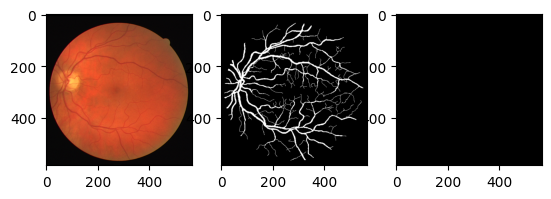

Train Epoch: 1 [0/20 (0%)]	Loss: 2.105670
Train Epoch: 1 [2/20 (10%)]	Loss: 2.164086
Train Epoch: 1 [4/20 (20%)]	Loss: 2.061682
Train Epoch: 1 [6/20 (30%)]	Loss: 1.669649
Train Epoch: 1 [8/20 (40%)]	Loss: 1.646256
Train Epoch: 1 [10/20 (50%)]	Loss: 1.772807
Train Epoch: 1 [12/20 (60%)]	Loss: 1.629969
Train Epoch: 1 [14/20 (70%)]	Loss: 1.567791
Train Epoch: 1 [16/20 (80%)]	Loss: 1.454288
Train Epoch: 1 [18/20 (90%)]	Loss: 1.657349

Test set: Avg. loss: 1.9200, Accuracy: 6021255/6599200 (91%)



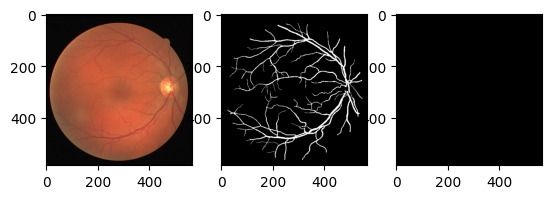

New best! Saving...
Train Epoch: 2 [0/20 (0%)]	Loss: 1.470815
Train Epoch: 2 [2/20 (10%)]	Loss: 1.385474
Train Epoch: 2 [4/20 (20%)]	Loss: 1.250381
Train Epoch: 2 [6/20 (30%)]	Loss: 1.499206
Train Epoch: 2 [8/20 (40%)]	Loss: 1.243076
Train Epoch: 2 [10/20 (50%)]	Loss: 1.090109
Train Epoch: 2 [12/20 (60%)]	Loss: 1.122425
Train Epoch: 2 [14/20 (70%)]	Loss: 1.343699
Train Epoch: 2 [16/20 (80%)]	Loss: 1.163055
Train Epoch: 2 [18/20 (90%)]	Loss: 1.126568

Test set: Avg. loss: 2.3176, Accuracy: 6021255/6599200 (91%)



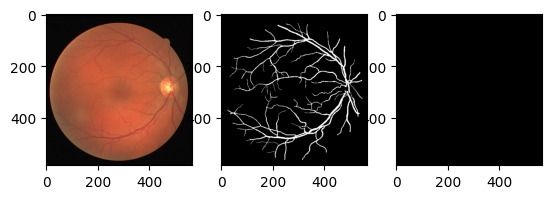

Train Epoch: 3 [0/20 (0%)]	Loss: 1.083523
Train Epoch: 3 [2/20 (10%)]	Loss: 1.038503
Train Epoch: 3 [4/20 (20%)]	Loss: 1.163005
Train Epoch: 3 [6/20 (30%)]	Loss: 1.296006
Train Epoch: 3 [8/20 (40%)]	Loss: 1.140650
Train Epoch: 3 [10/20 (50%)]	Loss: 0.961986
Train Epoch: 3 [12/20 (60%)]	Loss: 1.146081
Train Epoch: 3 [14/20 (70%)]	Loss: 1.275786
Train Epoch: 3 [16/20 (80%)]	Loss: 1.015369
Train Epoch: 3 [18/20 (90%)]	Loss: 1.069251

Test set: Avg. loss: 2.8096, Accuracy: 6021131/6599200 (91%)



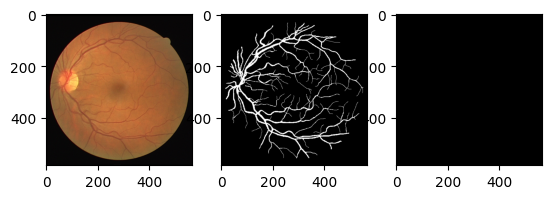

Train Epoch: 4 [0/20 (0%)]	Loss: 1.154545
Train Epoch: 4 [2/20 (10%)]	Loss: 1.008595
Train Epoch: 4 [4/20 (20%)]	Loss: 1.130684
Train Epoch: 4 [6/20 (30%)]	Loss: 0.993621
Train Epoch: 4 [8/20 (40%)]	Loss: 1.076076
Train Epoch: 4 [10/20 (50%)]	Loss: 1.014167
Train Epoch: 4 [12/20 (60%)]	Loss: 1.061702
Train Epoch: 4 [14/20 (70%)]	Loss: 0.922724
Train Epoch: 4 [16/20 (80%)]	Loss: 1.182678
Train Epoch: 4 [18/20 (90%)]	Loss: 1.052276

Test set: Avg. loss: 2.9627, Accuracy: 6029738/6599200 (91%)



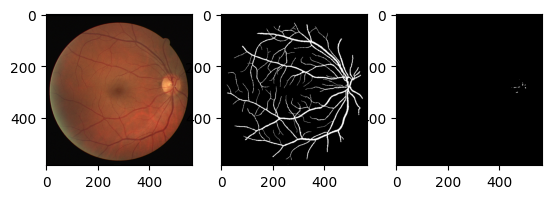

Train Epoch: 5 [0/20 (0%)]	Loss: 0.917081
Train Epoch: 5 [2/20 (10%)]	Loss: 1.058229
Train Epoch: 5 [4/20 (20%)]	Loss: 1.103771
Train Epoch: 5 [6/20 (30%)]	Loss: 1.074641
Train Epoch: 5 [8/20 (40%)]	Loss: 1.037003
Train Epoch: 5 [10/20 (50%)]	Loss: 1.050065
Train Epoch: 5 [12/20 (60%)]	Loss: 1.004286
Train Epoch: 5 [14/20 (70%)]	Loss: 1.013961
Train Epoch: 5 [16/20 (80%)]	Loss: 0.976543
Train Epoch: 5 [18/20 (90%)]	Loss: 1.237423

Test set: Avg. loss: 1.4697, Accuracy: 6225487/6599200 (94%)



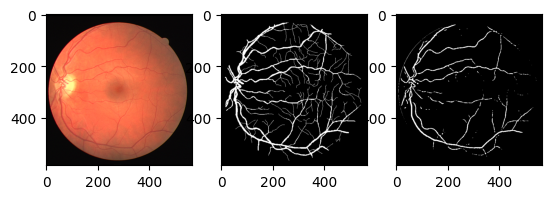

New best! Saving...
Train Epoch: 6 [0/20 (0%)]	Loss: 0.984397
Train Epoch: 6 [2/20 (10%)]	Loss: 0.929395
Train Epoch: 6 [4/20 (20%)]	Loss: 0.984386
Train Epoch: 6 [6/20 (30%)]	Loss: 1.128022
Train Epoch: 6 [8/20 (40%)]	Loss: 0.991531
Train Epoch: 6 [10/20 (50%)]	Loss: 1.018470
Train Epoch: 6 [12/20 (60%)]	Loss: 0.947866
Train Epoch: 6 [14/20 (70%)]	Loss: 1.225986
Train Epoch: 6 [16/20 (80%)]	Loss: 0.930891
Train Epoch: 6 [18/20 (90%)]	Loss: 1.020034

Test set: Avg. loss: 1.4405, Accuracy: 6256997/6599200 (95%)



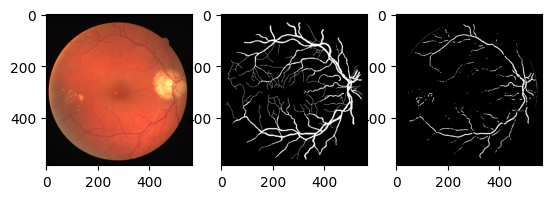

New best! Saving...
Train Epoch: 7 [0/20 (0%)]	Loss: 0.922008
Train Epoch: 7 [2/20 (10%)]	Loss: 1.002270
Train Epoch: 7 [4/20 (20%)]	Loss: 1.171082
Train Epoch: 7 [6/20 (30%)]	Loss: 0.858109
Train Epoch: 7 [8/20 (40%)]	Loss: 1.063837
Train Epoch: 7 [10/20 (50%)]	Loss: 0.985177
Train Epoch: 7 [12/20 (60%)]	Loss: 1.017859
Train Epoch: 7 [14/20 (70%)]	Loss: 0.908284
Train Epoch: 7 [16/20 (80%)]	Loss: 1.073130
Train Epoch: 7 [18/20 (90%)]	Loss: 0.987205

Test set: Avg. loss: 1.3621, Accuracy: 6266322/6599200 (95%)



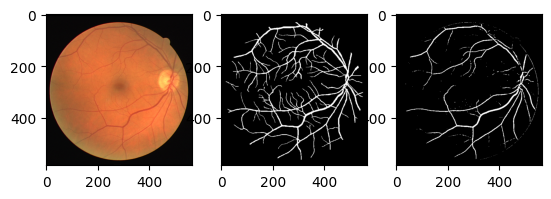

New best! Saving...
Train Epoch: 8 [0/20 (0%)]	Loss: 0.890569
Train Epoch: 8 [2/20 (10%)]	Loss: 1.145118
Train Epoch: 8 [4/20 (20%)]	Loss: 1.108971
Train Epoch: 8 [6/20 (30%)]	Loss: 0.932407
Train Epoch: 8 [8/20 (40%)]	Loss: 1.011481
Train Epoch: 8 [10/20 (50%)]	Loss: 0.880817
Train Epoch: 8 [12/20 (60%)]	Loss: 0.957791
Train Epoch: 8 [14/20 (70%)]	Loss: 0.881122
Train Epoch: 8 [16/20 (80%)]	Loss: 0.903741
Train Epoch: 8 [18/20 (90%)]	Loss: 1.105094

Test set: Avg. loss: 1.0789, Accuracy: 6348191/6599200 (96%)



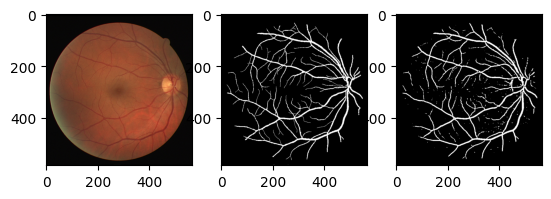

New best! Saving...
Train Epoch: 9 [0/20 (0%)]	Loss: 0.812276
Train Epoch: 9 [2/20 (10%)]	Loss: 0.949030
Train Epoch: 9 [4/20 (20%)]	Loss: 0.847686
Train Epoch: 9 [6/20 (30%)]	Loss: 0.904761
Train Epoch: 9 [8/20 (40%)]	Loss: 0.922625
Train Epoch: 9 [10/20 (50%)]	Loss: 1.010980
Train Epoch: 9 [12/20 (60%)]	Loss: 1.055115
Train Epoch: 9 [14/20 (70%)]	Loss: 1.191017
Train Epoch: 9 [16/20 (80%)]	Loss: 0.917542
Train Epoch: 9 [18/20 (90%)]	Loss: 0.994404

Test set: Avg. loss: 0.9846, Accuracy: 6339222/6599200 (96%)



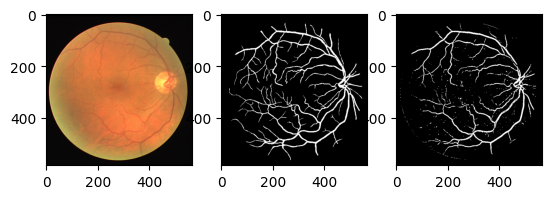

New best! Saving...
Train Epoch: 10 [0/20 (0%)]	Loss: 0.878037
Train Epoch: 10 [2/20 (10%)]	Loss: 0.952108
Train Epoch: 10 [4/20 (20%)]	Loss: 0.816429
Train Epoch: 10 [6/20 (30%)]	Loss: 0.950201
Train Epoch: 10 [8/20 (40%)]	Loss: 1.106175
Train Epoch: 10 [10/20 (50%)]	Loss: 0.887086
Train Epoch: 10 [12/20 (60%)]	Loss: 1.027267
Train Epoch: 10 [14/20 (70%)]	Loss: 0.850210
Train Epoch: 10 [16/20 (80%)]	Loss: 0.876615
Train Epoch: 10 [18/20 (90%)]	Loss: 0.760290

Test set: Avg. loss: 0.7889, Accuracy: 6320145/6599200 (96%)



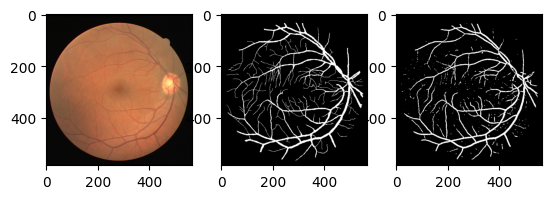

New best! Saving...
Train Epoch: 11 [0/20 (0%)]	Loss: 0.781232
Train Epoch: 11 [2/20 (10%)]	Loss: 0.936065
Train Epoch: 11 [4/20 (20%)]	Loss: 0.876628
Train Epoch: 11 [6/20 (30%)]	Loss: 0.722878
Train Epoch: 11 [8/20 (40%)]	Loss: 0.773130
Train Epoch: 11 [10/20 (50%)]	Loss: 0.793967
Train Epoch: 11 [12/20 (60%)]	Loss: 0.654971
Train Epoch: 11 [14/20 (70%)]	Loss: 0.763696
Train Epoch: 11 [16/20 (80%)]	Loss: 0.676204
Train Epoch: 11 [18/20 (90%)]	Loss: 0.625090

Test set: Avg. loss: 0.8101, Accuracy: 6358153/6599200 (96%)



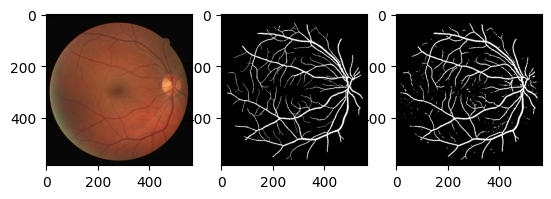

Train Epoch: 12 [0/20 (0%)]	Loss: 0.668097
Train Epoch: 12 [2/20 (10%)]	Loss: 0.715646
Train Epoch: 12 [4/20 (20%)]	Loss: 0.847722
Train Epoch: 12 [6/20 (30%)]	Loss: 0.668351
Train Epoch: 12 [8/20 (40%)]	Loss: 0.725165
Train Epoch: 12 [10/20 (50%)]	Loss: 0.637833
Train Epoch: 12 [12/20 (60%)]	Loss: 0.720396
Train Epoch: 12 [14/20 (70%)]	Loss: 0.732089
Train Epoch: 12 [16/20 (80%)]	Loss: 0.542707
Train Epoch: 12 [18/20 (90%)]	Loss: 1.020309

Test set: Avg. loss: 0.7469, Accuracy: 6330758/6599200 (96%)



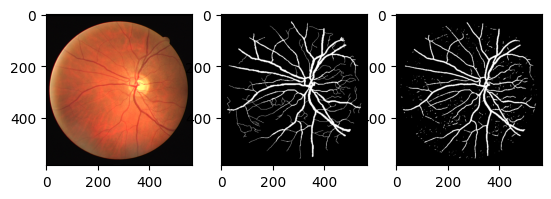

New best! Saving...
Train Epoch: 13 [0/20 (0%)]	Loss: 0.852706
Train Epoch: 13 [2/20 (10%)]	Loss: 0.713532
Train Epoch: 13 [4/20 (20%)]	Loss: 0.747767
Train Epoch: 13 [6/20 (30%)]	Loss: 0.702934
Train Epoch: 13 [8/20 (40%)]	Loss: 0.594547
Train Epoch: 13 [10/20 (50%)]	Loss: 0.745275
Train Epoch: 13 [12/20 (60%)]	Loss: 0.755904
Train Epoch: 13 [14/20 (70%)]	Loss: 0.855514
Train Epoch: 13 [16/20 (80%)]	Loss: 0.601410
Train Epoch: 13 [18/20 (90%)]	Loss: 0.654908

Test set: Avg. loss: 0.8551, Accuracy: 6343739/6599200 (96%)



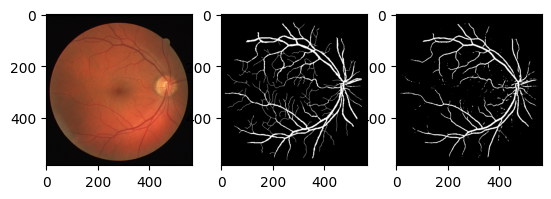

Train Epoch: 14 [0/20 (0%)]	Loss: 0.726138
Train Epoch: 14 [2/20 (10%)]	Loss: 0.567095
Train Epoch: 14 [4/20 (20%)]	Loss: 0.548262
Train Epoch: 14 [6/20 (30%)]	Loss: 0.937008
Train Epoch: 14 [8/20 (40%)]	Loss: 0.674157
Train Epoch: 14 [10/20 (50%)]	Loss: 0.797413
Train Epoch: 14 [12/20 (60%)]	Loss: 0.706602
Train Epoch: 14 [14/20 (70%)]	Loss: 0.827448
Train Epoch: 14 [16/20 (80%)]	Loss: 0.698473
Train Epoch: 14 [18/20 (90%)]	Loss: 0.661746

Test set: Avg. loss: 0.7502, Accuracy: 6353882/6599200 (96%)



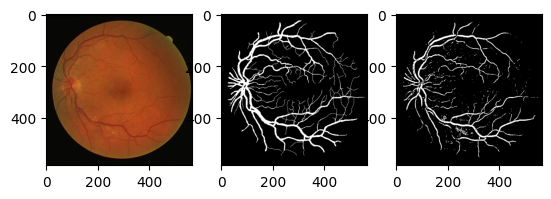

Train Epoch: 15 [0/20 (0%)]	Loss: 0.571726
Train Epoch: 15 [2/20 (10%)]	Loss: 0.791332
Train Epoch: 15 [4/20 (20%)]	Loss: 0.575318
Train Epoch: 15 [6/20 (30%)]	Loss: 0.688489
Train Epoch: 15 [8/20 (40%)]	Loss: 0.809585
Train Epoch: 15 [10/20 (50%)]	Loss: 0.736191
Train Epoch: 15 [12/20 (60%)]	Loss: 0.647049
Train Epoch: 15 [14/20 (70%)]	Loss: 0.728662
Train Epoch: 15 [16/20 (80%)]	Loss: 0.908928
Train Epoch: 15 [18/20 (90%)]	Loss: 0.601269

Test set: Avg. loss: 1.0027, Accuracy: 5958536/6599200 (90%)



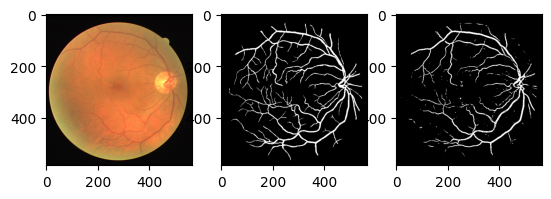

Train Epoch: 16 [0/20 (0%)]	Loss: 0.695703
Train Epoch: 16 [2/20 (10%)]	Loss: 0.871220
Train Epoch: 16 [4/20 (20%)]	Loss: 0.702639
Train Epoch: 16 [6/20 (30%)]	Loss: 0.701896
Train Epoch: 16 [8/20 (40%)]	Loss: 0.638979
Train Epoch: 16 [10/20 (50%)]	Loss: 0.704031
Train Epoch: 16 [12/20 (60%)]	Loss: 0.561991
Train Epoch: 16 [14/20 (70%)]	Loss: 0.562610
Train Epoch: 16 [16/20 (80%)]	Loss: 0.810058
Train Epoch: 16 [18/20 (90%)]	Loss: 0.659960

Test set: Avg. loss: 0.7429, Accuracy: 6354542/6599200 (96%)



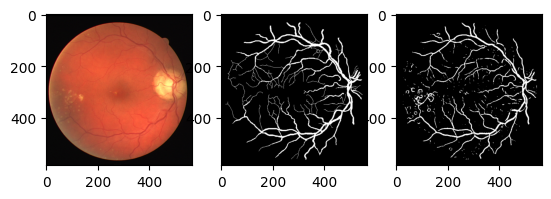

New best! Saving...
Train Epoch: 17 [0/20 (0%)]	Loss: 0.678852
Train Epoch: 17 [2/20 (10%)]	Loss: 0.703724
Train Epoch: 17 [4/20 (20%)]	Loss: 0.730078
Train Epoch: 17 [6/20 (30%)]	Loss: 0.617454
Train Epoch: 17 [8/20 (40%)]	Loss: 0.647659
Train Epoch: 17 [10/20 (50%)]	Loss: 0.697520
Train Epoch: 17 [12/20 (60%)]	Loss: 0.596304
Train Epoch: 17 [14/20 (70%)]	Loss: 0.852822
Train Epoch: 17 [16/20 (80%)]	Loss: 0.598480
Train Epoch: 17 [18/20 (90%)]	Loss: 0.703939

Test set: Avg. loss: 0.7334, Accuracy: 6350579/6599200 (96%)



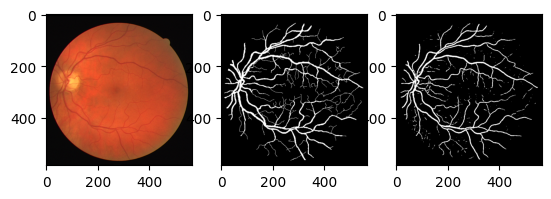

New best! Saving...
Train Epoch: 18 [0/20 (0%)]	Loss: 0.636530
Train Epoch: 18 [2/20 (10%)]	Loss: 0.594712
Train Epoch: 18 [4/20 (20%)]	Loss: 0.549193
Train Epoch: 18 [6/20 (30%)]	Loss: 0.825618
Train Epoch: 18 [8/20 (40%)]	Loss: 0.677637
Train Epoch: 18 [10/20 (50%)]	Loss: 0.885116
Train Epoch: 18 [12/20 (60%)]	Loss: 0.643854
Train Epoch: 18 [14/20 (70%)]	Loss: 0.692221
Train Epoch: 18 [16/20 (80%)]	Loss: 0.741786
Train Epoch: 18 [18/20 (90%)]	Loss: 0.675445

Test set: Avg. loss: 0.7523, Accuracy: 6358162/6599200 (96%)



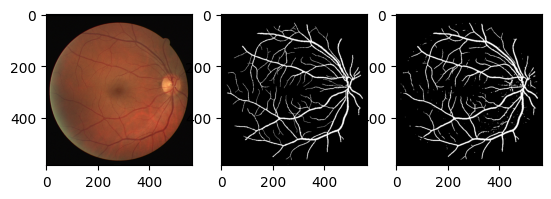

Train Epoch: 19 [0/20 (0%)]	Loss: 0.698953
Train Epoch: 19 [2/20 (10%)]	Loss: 0.562919
Train Epoch: 19 [4/20 (20%)]	Loss: 0.759970
Train Epoch: 19 [6/20 (30%)]	Loss: 0.776136
Train Epoch: 19 [8/20 (40%)]	Loss: 0.671269
Train Epoch: 19 [10/20 (50%)]	Loss: 0.600075
Train Epoch: 19 [12/20 (60%)]	Loss: 0.661862
Train Epoch: 19 [14/20 (70%)]	Loss: 0.757075
Train Epoch: 19 [16/20 (80%)]	Loss: 0.628448
Train Epoch: 19 [18/20 (90%)]	Loss: 0.705342

Test set: Avg. loss: 0.7169, Accuracy: 6330636/6599200 (96%)



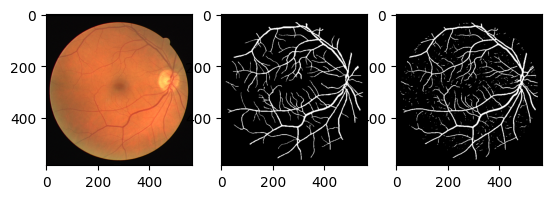

New best! Saving...
Train Epoch: 20 [0/20 (0%)]	Loss: 0.616377
Train Epoch: 20 [2/20 (10%)]	Loss: 0.536991
Train Epoch: 20 [4/20 (20%)]	Loss: 0.617309
Train Epoch: 20 [6/20 (30%)]	Loss: 0.676868
Train Epoch: 20 [8/20 (40%)]	Loss: 0.768271
Train Epoch: 20 [10/20 (50%)]	Loss: 0.677520
Train Epoch: 20 [12/20 (60%)]	Loss: 0.791770
Train Epoch: 20 [14/20 (70%)]	Loss: 0.730436
Train Epoch: 20 [16/20 (80%)]	Loss: 0.703602
Train Epoch: 20 [18/20 (90%)]	Loss: 0.632822

Test set: Avg. loss: 0.7739, Accuracy: 6345202/6599200 (96%)



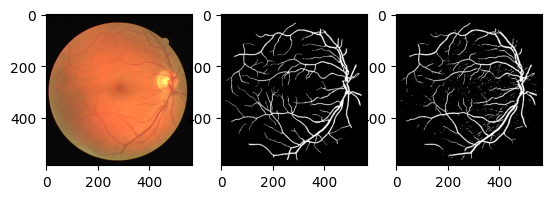

Train Epoch: 21 [0/20 (0%)]	Loss: 0.559882
Train Epoch: 21 [2/20 (10%)]	Loss: 0.615941
Train Epoch: 21 [4/20 (20%)]	Loss: 0.736752
Train Epoch: 21 [6/20 (30%)]	Loss: 0.652633
Train Epoch: 21 [8/20 (40%)]	Loss: 0.622413
Train Epoch: 21 [10/20 (50%)]	Loss: 0.687783
Train Epoch: 21 [12/20 (60%)]	Loss: 0.575325
Train Epoch: 21 [14/20 (70%)]	Loss: 0.814423
Train Epoch: 21 [16/20 (80%)]	Loss: 0.775243
Train Epoch: 21 [18/20 (90%)]	Loss: 0.749775

Test set: Avg. loss: 0.7418, Accuracy: 6321441/6599200 (96%)



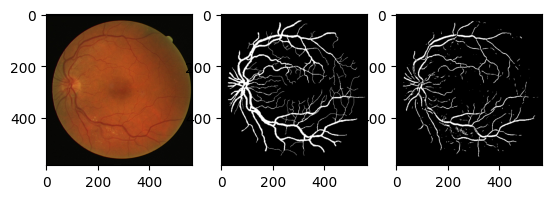

Train Epoch: 22 [0/20 (0%)]	Loss: 0.617726
Train Epoch: 22 [2/20 (10%)]	Loss: 0.632367
Train Epoch: 22 [4/20 (20%)]	Loss: 0.665147
Train Epoch: 22 [6/20 (30%)]	Loss: 0.796845
Train Epoch: 22 [8/20 (40%)]	Loss: 0.712521
Train Epoch: 22 [10/20 (50%)]	Loss: 0.627745
Train Epoch: 22 [12/20 (60%)]	Loss: 0.640818
Train Epoch: 22 [14/20 (70%)]	Loss: 0.672726
Train Epoch: 22 [16/20 (80%)]	Loss: 0.825129
Train Epoch: 22 [18/20 (90%)]	Loss: 0.492900

Test set: Avg. loss: 0.6997, Accuracy: 6350931/6599200 (96%)



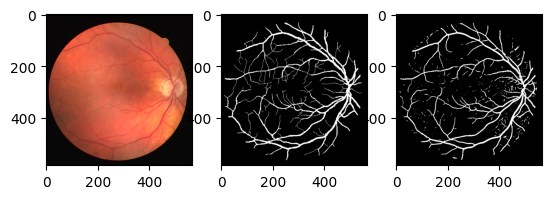

New best! Saving...
Train Epoch: 23 [0/20 (0%)]	Loss: 0.576227
Train Epoch: 23 [2/20 (10%)]	Loss: 0.675530
Train Epoch: 23 [4/20 (20%)]	Loss: 0.563903
Train Epoch: 23 [6/20 (30%)]	Loss: 0.790953
Train Epoch: 23 [8/20 (40%)]	Loss: 0.583363
Train Epoch: 23 [10/20 (50%)]	Loss: 0.518545
Train Epoch: 23 [12/20 (60%)]	Loss: 0.641941
Train Epoch: 23 [14/20 (70%)]	Loss: 0.673156
Train Epoch: 23 [16/20 (80%)]	Loss: 0.778241
Train Epoch: 23 [18/20 (90%)]	Loss: 0.777882

Test set: Avg. loss: 0.6934, Accuracy: 6329484/6599200 (96%)



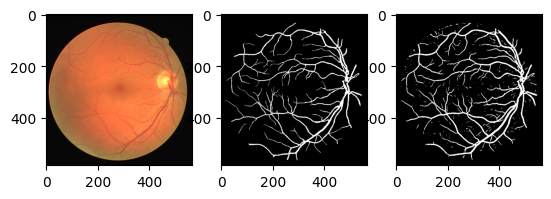

New best! Saving...
Train Epoch: 24 [0/20 (0%)]	Loss: 0.611133
Train Epoch: 24 [2/20 (10%)]	Loss: 0.736893
Train Epoch: 24 [4/20 (20%)]	Loss: 0.562401
Train Epoch: 24 [6/20 (30%)]	Loss: 0.728837
Train Epoch: 24 [8/20 (40%)]	Loss: 0.683733
Train Epoch: 24 [10/20 (50%)]	Loss: 0.667450
Train Epoch: 24 [12/20 (60%)]	Loss: 0.648190
Train Epoch: 24 [14/20 (70%)]	Loss: 0.648288
Train Epoch: 24 [16/20 (80%)]	Loss: 0.697141
Train Epoch: 24 [18/20 (90%)]	Loss: 0.621366

Test set: Avg. loss: 0.6858, Accuracy: 6343405/6599200 (96%)



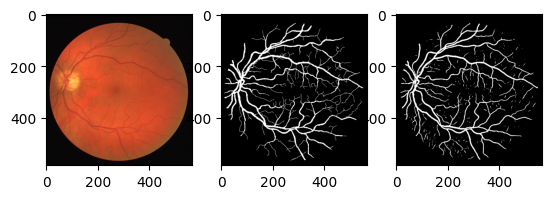

New best! Saving...
Train Epoch: 25 [0/20 (0%)]	Loss: 0.723391
Train Epoch: 25 [2/20 (10%)]	Loss: 0.663200
Train Epoch: 25 [4/20 (20%)]	Loss: 0.498854
Train Epoch: 25 [6/20 (30%)]	Loss: 0.726870
Train Epoch: 25 [8/20 (40%)]	Loss: 0.830787
Train Epoch: 25 [10/20 (50%)]	Loss: 0.623004
Train Epoch: 25 [12/20 (60%)]	Loss: 0.522999
Train Epoch: 25 [14/20 (70%)]	Loss: 0.593595
Train Epoch: 25 [16/20 (80%)]	Loss: 0.614227
Train Epoch: 25 [18/20 (90%)]	Loss: 0.657833

Test set: Avg. loss: 0.7429, Accuracy: 6360684/6599200 (96%)



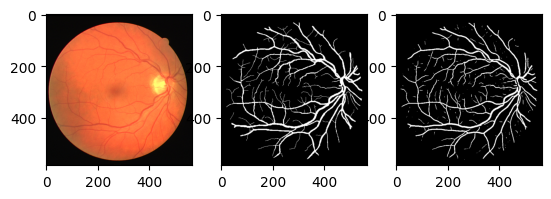

Train Epoch: 26 [0/20 (0%)]	Loss: 0.737575
Train Epoch: 26 [2/20 (10%)]	Loss: 0.673465
Train Epoch: 26 [4/20 (20%)]	Loss: 0.663183
Train Epoch: 26 [6/20 (30%)]	Loss: 0.772755
Train Epoch: 26 [8/20 (40%)]	Loss: 0.618948
Train Epoch: 26 [10/20 (50%)]	Loss: 0.615391
Train Epoch: 26 [12/20 (60%)]	Loss: 0.809757
Train Epoch: 26 [14/20 (70%)]	Loss: 0.556156
Train Epoch: 26 [16/20 (80%)]	Loss: 0.530517
Train Epoch: 26 [18/20 (90%)]	Loss: 0.616531

Test set: Avg. loss: 0.8191, Accuracy: 6356875/6599200 (96%)



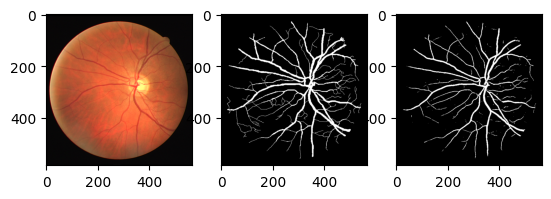

Train Epoch: 27 [0/20 (0%)]	Loss: 0.690262
Train Epoch: 27 [2/20 (10%)]	Loss: 0.648077
Train Epoch: 27 [4/20 (20%)]	Loss: 0.655596
Train Epoch: 27 [6/20 (30%)]	Loss: 0.549793
Train Epoch: 27 [8/20 (40%)]	Loss: 0.510494
Train Epoch: 27 [10/20 (50%)]	Loss: 0.620349
Train Epoch: 27 [12/20 (60%)]	Loss: 0.571916
Train Epoch: 27 [14/20 (70%)]	Loss: 0.753619
Train Epoch: 27 [16/20 (80%)]	Loss: 0.621126
Train Epoch: 27 [18/20 (90%)]	Loss: 0.911958

Test set: Avg. loss: 0.6965, Accuracy: 6281706/6599200 (95%)



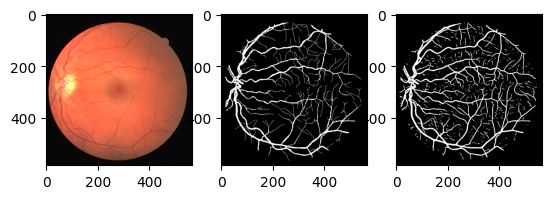

Train Epoch: 28 [0/20 (0%)]	Loss: 0.565239
Train Epoch: 28 [2/20 (10%)]	Loss: 0.573046
Train Epoch: 28 [4/20 (20%)]	Loss: 0.643016
Train Epoch: 28 [6/20 (30%)]	Loss: 0.633668
Train Epoch: 28 [8/20 (40%)]	Loss: 0.736648
Train Epoch: 28 [10/20 (50%)]	Loss: 0.560301
Train Epoch: 28 [12/20 (60%)]	Loss: 0.645009
Train Epoch: 28 [14/20 (70%)]	Loss: 0.768591
Train Epoch: 28 [16/20 (80%)]	Loss: 0.620309
Train Epoch: 28 [18/20 (90%)]	Loss: 0.627289

Test set: Avg. loss: 0.7246, Accuracy: 6361830/6599200 (96%)



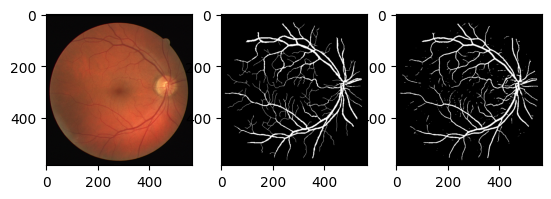

Train Epoch: 29 [0/20 (0%)]	Loss: 0.675237
Train Epoch: 29 [2/20 (10%)]	Loss: 0.507669
Train Epoch: 29 [4/20 (20%)]	Loss: 0.631135
Train Epoch: 29 [6/20 (30%)]	Loss: 0.733098
Train Epoch: 29 [8/20 (40%)]	Loss: 0.615009
Train Epoch: 29 [10/20 (50%)]	Loss: 0.729404
Train Epoch: 29 [12/20 (60%)]	Loss: 0.645356
Train Epoch: 29 [14/20 (70%)]	Loss: 0.648683
Train Epoch: 29 [16/20 (80%)]	Loss: 0.646414
Train Epoch: 29 [18/20 (90%)]	Loss: 0.576197

Test set: Avg. loss: 0.9405, Accuracy: 6347675/6599200 (96%)



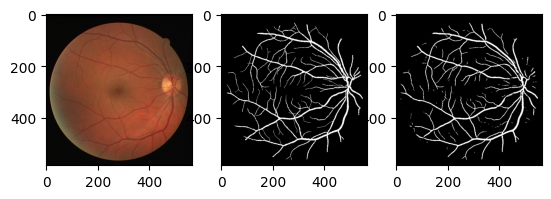

Train Epoch: 30 [0/20 (0%)]	Loss: 0.573402
Train Epoch: 30 [2/20 (10%)]	Loss: 0.638491
Train Epoch: 30 [4/20 (20%)]	Loss: 0.534276
Train Epoch: 30 [6/20 (30%)]	Loss: 0.771062
Train Epoch: 30 [8/20 (40%)]	Loss: 0.912842
Train Epoch: 30 [10/20 (50%)]	Loss: 0.617764
Train Epoch: 30 [12/20 (60%)]	Loss: 0.672794
Train Epoch: 30 [14/20 (70%)]	Loss: 0.565677
Train Epoch: 30 [16/20 (80%)]	Loss: 0.605503
Train Epoch: 30 [18/20 (90%)]	Loss: 0.661576

Test set: Avg. loss: 0.9141, Accuracy: 6341235/6599200 (96%)



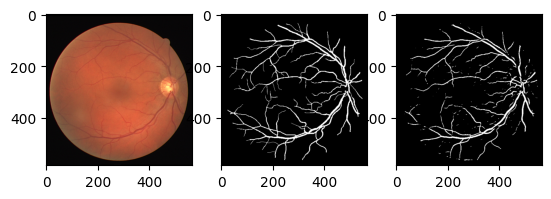

Train Epoch: 31 [0/20 (0%)]	Loss: 0.588730
Train Epoch: 31 [2/20 (10%)]	Loss: 0.789165
Train Epoch: 31 [4/20 (20%)]	Loss: 0.634984
Train Epoch: 31 [6/20 (30%)]	Loss: 0.620180
Train Epoch: 31 [8/20 (40%)]	Loss: 0.554321
Train Epoch: 31 [10/20 (50%)]	Loss: 0.585654
Train Epoch: 31 [12/20 (60%)]	Loss: 0.644523
Train Epoch: 31 [14/20 (70%)]	Loss: 0.852553
Train Epoch: 31 [16/20 (80%)]	Loss: 0.559279
Train Epoch: 31 [18/20 (90%)]	Loss: 0.653717

Test set: Avg. loss: 0.8922, Accuracy: 6335348/6599200 (96%)



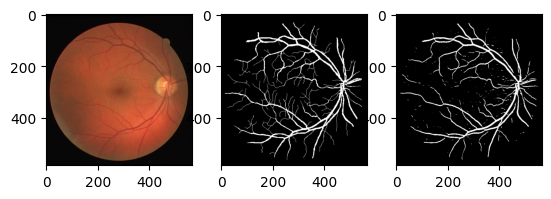

Train Epoch: 32 [0/20 (0%)]	Loss: 0.611566
Train Epoch: 32 [2/20 (10%)]	Loss: 0.532640
Train Epoch: 32 [4/20 (20%)]	Loss: 0.638486
Train Epoch: 32 [6/20 (30%)]	Loss: 0.542337
Train Epoch: 32 [8/20 (40%)]	Loss: 0.643065
Train Epoch: 32 [10/20 (50%)]	Loss: 0.567105
Train Epoch: 32 [12/20 (60%)]	Loss: 0.667114
Train Epoch: 32 [14/20 (70%)]	Loss: 0.733287
Train Epoch: 32 [16/20 (80%)]	Loss: 0.798672
Train Epoch: 32 [18/20 (90%)]	Loss: 0.627600

Test set: Avg. loss: 0.7089, Accuracy: 6303417/6599200 (96%)



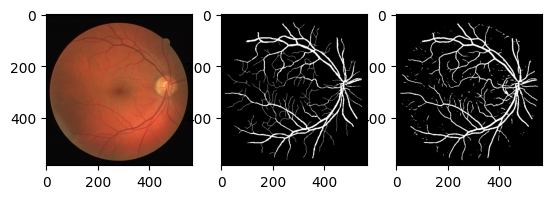

Train Epoch: 33 [0/20 (0%)]	Loss: 0.555539
Train Epoch: 33 [2/20 (10%)]	Loss: 0.619189
Train Epoch: 33 [4/20 (20%)]	Loss: 0.801939
Train Epoch: 33 [6/20 (30%)]	Loss: 0.814699
Train Epoch: 33 [8/20 (40%)]	Loss: 0.541990
Train Epoch: 33 [10/20 (50%)]	Loss: 0.592173
Train Epoch: 33 [12/20 (60%)]	Loss: 0.574697
Train Epoch: 33 [14/20 (70%)]	Loss: 0.575335
Train Epoch: 33 [16/20 (80%)]	Loss: 0.645288
Train Epoch: 33 [18/20 (90%)]	Loss: 0.675509

Test set: Avg. loss: 0.7708, Accuracy: 6367630/6599200 (96%)



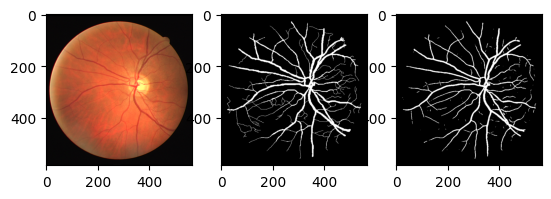

Train Epoch: 34 [0/20 (0%)]	Loss: 0.469048
Train Epoch: 34 [2/20 (10%)]	Loss: 0.586041
Train Epoch: 34 [4/20 (20%)]	Loss: 0.723551
Train Epoch: 34 [6/20 (30%)]	Loss: 0.608258
Train Epoch: 34 [8/20 (40%)]	Loss: 0.582674
Train Epoch: 34 [10/20 (50%)]	Loss: 0.645867
Train Epoch: 34 [12/20 (60%)]	Loss: 0.505035
Train Epoch: 34 [14/20 (70%)]	Loss: 0.806366
Train Epoch: 34 [16/20 (80%)]	Loss: 0.608860
Train Epoch: 34 [18/20 (90%)]	Loss: 0.697245

Test set: Avg. loss: 0.6826, Accuracy: 6361297/6599200 (96%)



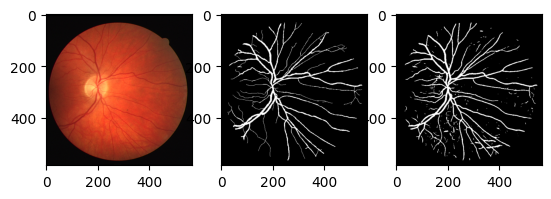

New best! Saving...
Train Epoch: 35 [0/20 (0%)]	Loss: 0.574681
Train Epoch: 35 [2/20 (10%)]	Loss: 0.621167
Train Epoch: 35 [4/20 (20%)]	Loss: 0.582279
Train Epoch: 35 [6/20 (30%)]	Loss: 0.704184
Train Epoch: 35 [8/20 (40%)]	Loss: 0.710574
Train Epoch: 35 [10/20 (50%)]	Loss: 0.567701
Train Epoch: 35 [12/20 (60%)]	Loss: 0.745866
Train Epoch: 35 [14/20 (70%)]	Loss: 0.574557
Train Epoch: 35 [16/20 (80%)]	Loss: 0.506439
Train Epoch: 35 [18/20 (90%)]	Loss: 0.559689

Test set: Avg. loss: 0.7765, Accuracy: 6365874/6599200 (96%)



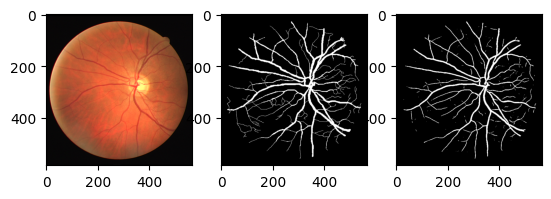

Train Epoch: 36 [0/20 (0%)]	Loss: 0.578967
Train Epoch: 36 [2/20 (10%)]	Loss: 0.711453
Train Epoch: 36 [4/20 (20%)]	Loss: 0.638442
Train Epoch: 36 [6/20 (30%)]	Loss: 0.578443
Train Epoch: 36 [8/20 (40%)]	Loss: 0.609891
Train Epoch: 36 [10/20 (50%)]	Loss: 0.634616
Train Epoch: 36 [12/20 (60%)]	Loss: 0.541595
Train Epoch: 36 [14/20 (70%)]	Loss: 0.671892
Train Epoch: 36 [16/20 (80%)]	Loss: 0.550130
Train Epoch: 36 [18/20 (90%)]	Loss: 0.717529

Test set: Avg. loss: 0.6975, Accuracy: 6368086/6599200 (96%)



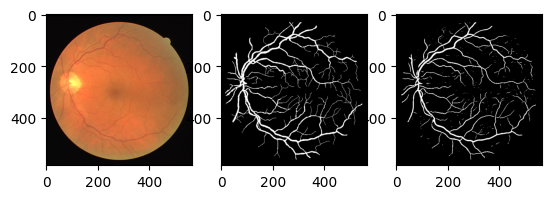

Train Epoch: 37 [0/20 (0%)]	Loss: 0.491105
Train Epoch: 37 [2/20 (10%)]	Loss: 0.596352
Train Epoch: 37 [4/20 (20%)]	Loss: 0.773770
Train Epoch: 37 [6/20 (30%)]	Loss: 0.645244
Train Epoch: 37 [8/20 (40%)]	Loss: 0.723806
Train Epoch: 37 [10/20 (50%)]	Loss: 0.576083
Train Epoch: 37 [12/20 (60%)]	Loss: 0.722972
Train Epoch: 37 [14/20 (70%)]	Loss: 0.587033
Train Epoch: 37 [16/20 (80%)]	Loss: 0.557294
Train Epoch: 37 [18/20 (90%)]	Loss: 0.580582

Test set: Avg. loss: 0.6906, Accuracy: 6367089/6599200 (96%)



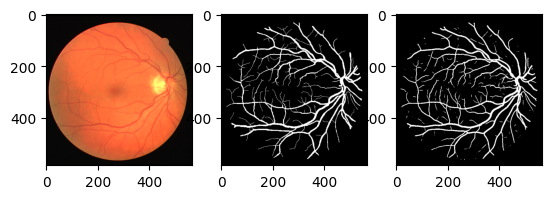

Train Epoch: 38 [0/20 (0%)]	Loss: 0.515208
Train Epoch: 38 [2/20 (10%)]	Loss: 0.488327
Train Epoch: 38 [4/20 (20%)]	Loss: 0.609587
Train Epoch: 38 [6/20 (30%)]	Loss: 0.712473
Train Epoch: 38 [8/20 (40%)]	Loss: 0.717610
Train Epoch: 38 [10/20 (50%)]	Loss: 0.679291
Train Epoch: 38 [12/20 (60%)]	Loss: 0.534442
Train Epoch: 38 [14/20 (70%)]	Loss: 0.639153
Train Epoch: 38 [16/20 (80%)]	Loss: 0.614304
Train Epoch: 38 [18/20 (90%)]	Loss: 0.653875

Test set: Avg. loss: 0.8568, Accuracy: 6364398/6599200 (96%)



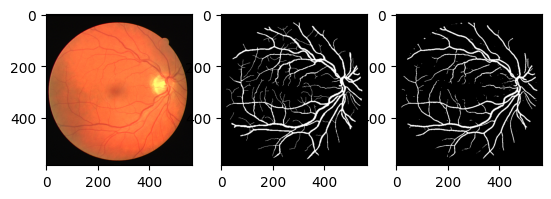

Train Epoch: 39 [0/20 (0%)]	Loss: 0.627437
Train Epoch: 39 [2/20 (10%)]	Loss: 0.536700
Train Epoch: 39 [4/20 (20%)]	Loss: 0.596977
Train Epoch: 39 [6/20 (30%)]	Loss: 0.582126
Train Epoch: 39 [8/20 (40%)]	Loss: 0.491283
Train Epoch: 39 [10/20 (50%)]	Loss: 0.681783
Train Epoch: 39 [12/20 (60%)]	Loss: 0.635582
Train Epoch: 39 [14/20 (70%)]	Loss: 0.701490
Train Epoch: 39 [16/20 (80%)]	Loss: 0.486943
Train Epoch: 39 [18/20 (90%)]	Loss: 0.707242

Test set: Avg. loss: 0.6929, Accuracy: 6374082/6599200 (97%)



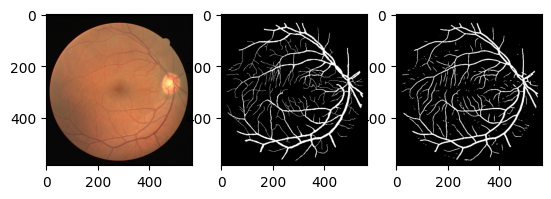

Train Epoch: 40 [0/20 (0%)]	Loss: 0.655734
Train Epoch: 40 [2/20 (10%)]	Loss: 0.618674
Train Epoch: 40 [4/20 (20%)]	Loss: 0.522207
Train Epoch: 40 [6/20 (30%)]	Loss: 0.496951
Train Epoch: 40 [8/20 (40%)]	Loss: 0.563476
Train Epoch: 40 [10/20 (50%)]	Loss: 0.538300
Train Epoch: 40 [12/20 (60%)]	Loss: 0.608936
Train Epoch: 40 [14/20 (70%)]	Loss: 0.637689
Train Epoch: 40 [16/20 (80%)]	Loss: 0.662078
Train Epoch: 40 [18/20 (90%)]	Loss: 0.688938

Test set: Avg. loss: 0.6925, Accuracy: 6297465/6599200 (95%)



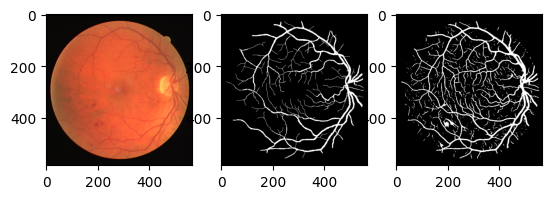

Train Epoch: 41 [0/20 (0%)]	Loss: 0.607135
Train Epoch: 41 [2/20 (10%)]	Loss: 0.565513
Train Epoch: 41 [4/20 (20%)]	Loss: 0.640300
Train Epoch: 41 [6/20 (30%)]	Loss: 0.629095
Train Epoch: 41 [8/20 (40%)]	Loss: 0.571539
Train Epoch: 41 [10/20 (50%)]	Loss: 0.531184
Train Epoch: 41 [12/20 (60%)]	Loss: 0.759788
Train Epoch: 41 [14/20 (70%)]	Loss: 0.725040
Train Epoch: 41 [16/20 (80%)]	Loss: 0.509075
Train Epoch: 41 [18/20 (90%)]	Loss: 0.502062

Test set: Avg. loss: 0.6901, Accuracy: 6377409/6599200 (97%)



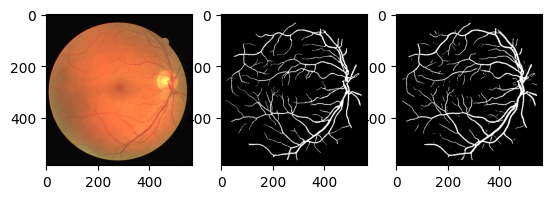

Train Epoch: 42 [0/20 (0%)]	Loss: 0.500021
Train Epoch: 42 [2/20 (10%)]	Loss: 0.581652
Train Epoch: 42 [4/20 (20%)]	Loss: 0.503729
Train Epoch: 42 [6/20 (30%)]	Loss: 0.578263
Train Epoch: 42 [8/20 (40%)]	Loss: 0.728907
Train Epoch: 42 [10/20 (50%)]	Loss: 0.605899
Train Epoch: 42 [12/20 (60%)]	Loss: 0.621944
Train Epoch: 42 [14/20 (70%)]	Loss: 0.716379
Train Epoch: 42 [16/20 (80%)]	Loss: 0.594709
Train Epoch: 42 [18/20 (90%)]	Loss: 0.511211

Test set: Avg. loss: 0.7261, Accuracy: 6346050/6599200 (96%)



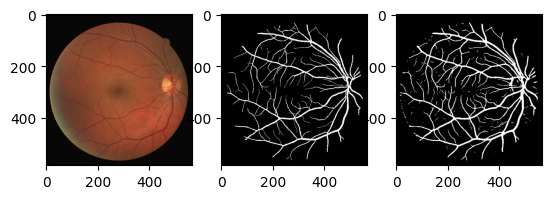

Train Epoch: 43 [0/20 (0%)]	Loss: 0.600026
Train Epoch: 43 [2/20 (10%)]	Loss: 0.582726
Train Epoch: 43 [4/20 (20%)]	Loss: 0.681828
Train Epoch: 43 [6/20 (30%)]	Loss: 0.552189
Train Epoch: 43 [8/20 (40%)]	Loss: 0.555534
Train Epoch: 43 [10/20 (50%)]	Loss: 0.581649
Train Epoch: 43 [12/20 (60%)]	Loss: 0.702434
Train Epoch: 43 [14/20 (70%)]	Loss: 0.736977
Train Epoch: 43 [16/20 (80%)]	Loss: 0.567970
Train Epoch: 43 [18/20 (90%)]	Loss: 0.444265

Test set: Avg. loss: 0.7686, Accuracy: 6385941/6599200 (97%)



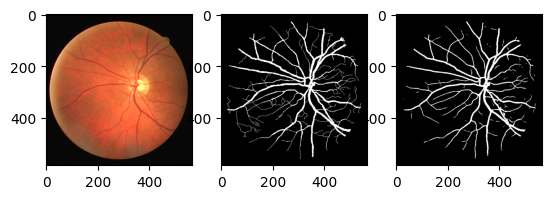

Train Epoch: 44 [0/20 (0%)]	Loss: 0.599822
Train Epoch: 44 [2/20 (10%)]	Loss: 0.583611
Train Epoch: 44 [4/20 (20%)]	Loss: 0.694799
Train Epoch: 44 [6/20 (30%)]	Loss: 0.554990
Train Epoch: 44 [8/20 (40%)]	Loss: 0.529561
Train Epoch: 44 [10/20 (50%)]	Loss: 0.578887
Train Epoch: 44 [12/20 (60%)]	Loss: 0.584580
Train Epoch: 44 [14/20 (70%)]	Loss: 0.598975
Train Epoch: 44 [16/20 (80%)]	Loss: 0.625494
Train Epoch: 44 [18/20 (90%)]	Loss: 0.480313

Test set: Avg. loss: 0.6977, Accuracy: 6381967/6599200 (97%)



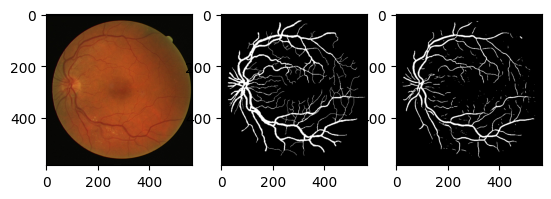

Train Epoch: 45 [0/20 (0%)]	Loss: 0.623190
Train Epoch: 45 [2/20 (10%)]	Loss: 0.569622
Train Epoch: 45 [4/20 (20%)]	Loss: 0.695819
Train Epoch: 45 [6/20 (30%)]	Loss: 0.501963
Train Epoch: 45 [8/20 (40%)]	Loss: 0.574482
Train Epoch: 45 [10/20 (50%)]	Loss: 0.503791
Train Epoch: 45 [12/20 (60%)]	Loss: 0.578807
Train Epoch: 45 [14/20 (70%)]	Loss: 0.527350
Train Epoch: 45 [16/20 (80%)]	Loss: 0.685361
Train Epoch: 45 [18/20 (90%)]	Loss: 0.526966

Test set: Avg. loss: 0.6954, Accuracy: 6362529/6599200 (96%)



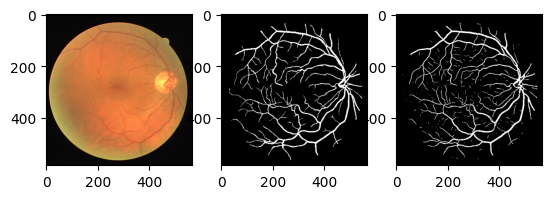

Train Epoch: 46 [0/20 (0%)]	Loss: 0.531112
Train Epoch: 46 [2/20 (10%)]	Loss: 0.583269
Train Epoch: 46 [4/20 (20%)]	Loss: 0.504495
Train Epoch: 46 [6/20 (30%)]	Loss: 0.622752
Train Epoch: 46 [8/20 (40%)]	Loss: 0.529666
Train Epoch: 46 [10/20 (50%)]	Loss: 0.690172
Train Epoch: 46 [12/20 (60%)]	Loss: 0.520774
Train Epoch: 46 [14/20 (70%)]	Loss: 0.531847
Train Epoch: 46 [16/20 (80%)]	Loss: 0.675119
Train Epoch: 46 [18/20 (90%)]	Loss: 0.640681

Test set: Avg. loss: 0.6972, Accuracy: 6300382/6599200 (95%)



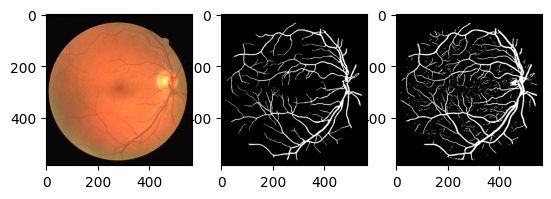

Train Epoch: 47 [0/20 (0%)]	Loss: 0.576146
Train Epoch: 47 [2/20 (10%)]	Loss: 0.501441
Train Epoch: 47 [4/20 (20%)]	Loss: 0.612853
Train Epoch: 47 [6/20 (30%)]	Loss: 0.627642
Train Epoch: 47 [8/20 (40%)]	Loss: 0.546306
Train Epoch: 47 [10/20 (50%)]	Loss: 0.543820
Train Epoch: 47 [12/20 (60%)]	Loss: 0.694651
Train Epoch: 47 [14/20 (70%)]	Loss: 0.497135
Train Epoch: 47 [16/20 (80%)]	Loss: 0.600424
Train Epoch: 47 [18/20 (90%)]	Loss: 0.494677

Test set: Avg. loss: 0.6732, Accuracy: 6351051/6599200 (96%)



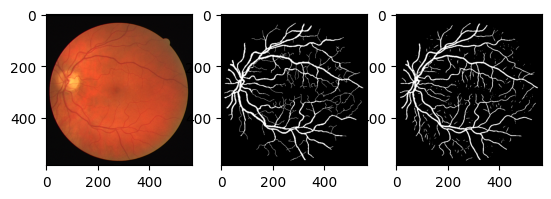

New best! Saving...
Train Epoch: 48 [0/20 (0%)]	Loss: 0.584213
Train Epoch: 48 [2/20 (10%)]	Loss: 0.702846
Train Epoch: 48 [4/20 (20%)]	Loss: 0.582252
Train Epoch: 48 [6/20 (30%)]	Loss: 0.580591
Train Epoch: 48 [8/20 (40%)]	Loss: 0.568708
Train Epoch: 48 [10/20 (50%)]	Loss: 0.618210
Train Epoch: 48 [12/20 (60%)]	Loss: 0.545900
Train Epoch: 48 [14/20 (70%)]	Loss: 0.452942
Train Epoch: 48 [16/20 (80%)]	Loss: 0.569179
Train Epoch: 48 [18/20 (90%)]	Loss: 0.432016

Test set: Avg. loss: 0.7579, Accuracy: 6376768/6599200 (97%)



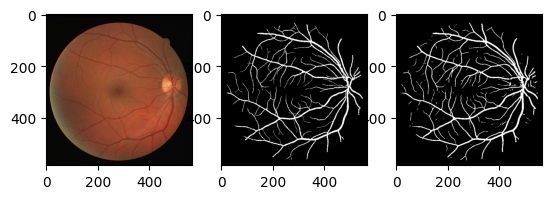

Train Epoch: 49 [0/20 (0%)]	Loss: 0.524290
Train Epoch: 49 [2/20 (10%)]	Loss: 0.605775
Train Epoch: 49 [4/20 (20%)]	Loss: 0.682340
Train Epoch: 49 [6/20 (30%)]	Loss: 0.466730
Train Epoch: 49 [8/20 (40%)]	Loss: 0.546996
Train Epoch: 49 [10/20 (50%)]	Loss: 0.553756
Train Epoch: 49 [12/20 (60%)]	Loss: 0.713644
Train Epoch: 49 [14/20 (70%)]	Loss: 0.510814
Train Epoch: 49 [16/20 (80%)]	Loss: 0.587497
Train Epoch: 49 [18/20 (90%)]	Loss: 0.435607

Test set: Avg. loss: 0.6753, Accuracy: 6325177/6599200 (96%)



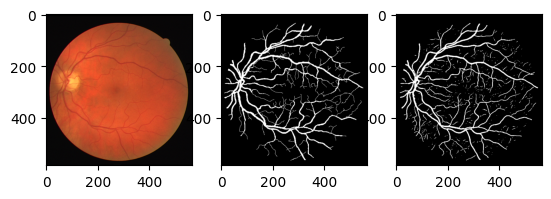

Train Epoch: 50 [0/20 (0%)]	Loss: 0.478245
Train Epoch: 50 [2/20 (10%)]	Loss: 0.651407
Train Epoch: 50 [4/20 (20%)]	Loss: 0.766776
Train Epoch: 50 [6/20 (30%)]	Loss: 0.440724
Train Epoch: 50 [8/20 (40%)]	Loss: 0.571711
Train Epoch: 50 [10/20 (50%)]	Loss: 0.541259
Train Epoch: 50 [12/20 (60%)]	Loss: 0.564538
Train Epoch: 50 [14/20 (70%)]	Loss: 0.584559
Train Epoch: 50 [16/20 (80%)]	Loss: 0.428606
Train Epoch: 50 [18/20 (90%)]	Loss: 0.550044

Test set: Avg. loss: 0.7491, Accuracy: 6364254/6599200 (96%)



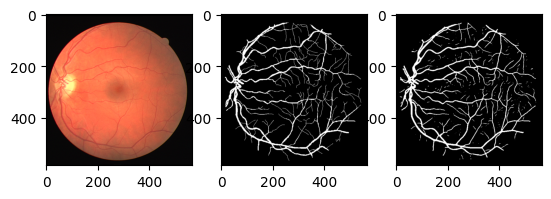

Train Epoch: 51 [0/20 (0%)]	Loss: 0.526194
Train Epoch: 51 [2/20 (10%)]	Loss: 0.532228
Train Epoch: 51 [4/20 (20%)]	Loss: 0.762404
Train Epoch: 51 [6/20 (30%)]	Loss: 0.537093
Train Epoch: 51 [8/20 (40%)]	Loss: 0.458473
Train Epoch: 51 [10/20 (50%)]	Loss: 0.525459
Train Epoch: 51 [12/20 (60%)]	Loss: 0.610049
Train Epoch: 51 [14/20 (70%)]	Loss: 0.645488
Train Epoch: 51 [16/20 (80%)]	Loss: 0.430296
Train Epoch: 51 [18/20 (90%)]	Loss: 0.556412

Test set: Avg. loss: 0.7179, Accuracy: 6372126/6599200 (97%)



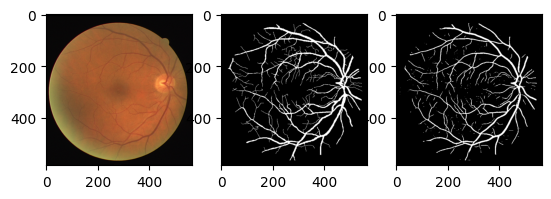

Train Epoch: 52 [0/20 (0%)]	Loss: 0.465435
Train Epoch: 52 [2/20 (10%)]	Loss: 0.450982
Train Epoch: 52 [4/20 (20%)]	Loss: 0.645256
Train Epoch: 52 [6/20 (30%)]	Loss: 0.592869
Train Epoch: 52 [8/20 (40%)]	Loss: 0.606111
Train Epoch: 52 [10/20 (50%)]	Loss: 0.538118
Train Epoch: 52 [12/20 (60%)]	Loss: 0.633562
Train Epoch: 52 [14/20 (70%)]	Loss: 0.586822
Train Epoch: 52 [16/20 (80%)]	Loss: 0.572029
Train Epoch: 52 [18/20 (90%)]	Loss: 0.516946

Test set: Avg. loss: 0.7663, Accuracy: 6358202/6599200 (96%)



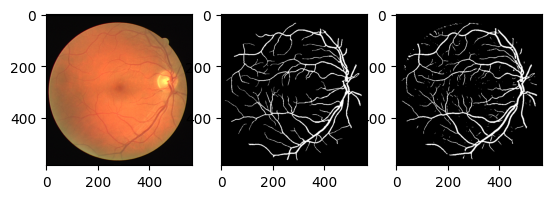

Train Epoch: 53 [0/20 (0%)]	Loss: 0.543512
Train Epoch: 53 [2/20 (10%)]	Loss: 0.473704
Train Epoch: 53 [4/20 (20%)]	Loss: 0.534407
Train Epoch: 53 [6/20 (30%)]	Loss: 0.608285
Train Epoch: 53 [8/20 (40%)]	Loss: 0.530789
Train Epoch: 53 [10/20 (50%)]	Loss: 0.404254
Train Epoch: 53 [12/20 (60%)]	Loss: 0.754913
Train Epoch: 53 [14/20 (70%)]	Loss: 0.521855
Train Epoch: 53 [16/20 (80%)]	Loss: 0.570267
Train Epoch: 53 [18/20 (90%)]	Loss: 0.580097

Test set: Avg. loss: 0.7422, Accuracy: 6343546/6599200 (96%)



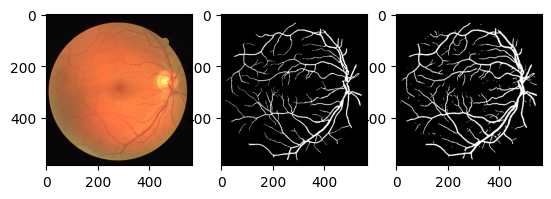

Train Epoch: 54 [0/20 (0%)]	Loss: 0.464493
Train Epoch: 54 [2/20 (10%)]	Loss: 0.465002
Train Epoch: 54 [4/20 (20%)]	Loss: 0.555104
Train Epoch: 54 [6/20 (30%)]	Loss: 0.607628
Train Epoch: 54 [8/20 (40%)]	Loss: 0.497994
Train Epoch: 54 [10/20 (50%)]	Loss: 0.516627
Train Epoch: 54 [12/20 (60%)]	Loss: 0.573553
Train Epoch: 54 [14/20 (70%)]	Loss: 0.567863
Train Epoch: 54 [16/20 (80%)]	Loss: 0.663401
Train Epoch: 54 [18/20 (90%)]	Loss: 0.604466

Test set: Avg. loss: 0.7268, Accuracy: 6355106/6599200 (96%)



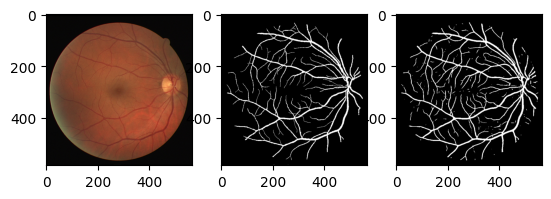

Train Epoch: 55 [0/20 (0%)]	Loss: 0.514372
Train Epoch: 55 [2/20 (10%)]	Loss: 0.571956
Train Epoch: 55 [4/20 (20%)]	Loss: 0.542222
Train Epoch: 55 [6/20 (30%)]	Loss: 0.485010
Train Epoch: 55 [8/20 (40%)]	Loss: 0.520358
Train Epoch: 55 [10/20 (50%)]	Loss: 0.656401
Train Epoch: 55 [12/20 (60%)]	Loss: 0.509497
Train Epoch: 55 [14/20 (70%)]	Loss: 0.583786
Train Epoch: 55 [16/20 (80%)]	Loss: 0.566324
Train Epoch: 55 [18/20 (90%)]	Loss: 0.464446

Test set: Avg. loss: 0.7280, Accuracy: 6350273/6599200 (96%)



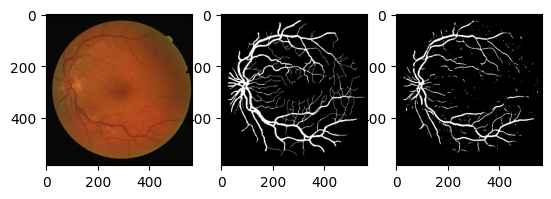

Train Epoch: 56 [0/20 (0%)]	Loss: 0.595514
Train Epoch: 56 [2/20 (10%)]	Loss: 0.565781
Train Epoch: 56 [4/20 (20%)]	Loss: 0.539794
Train Epoch: 56 [6/20 (30%)]	Loss: 0.496224
Train Epoch: 56 [8/20 (40%)]	Loss: 0.558150
Train Epoch: 56 [10/20 (50%)]	Loss: 0.466714
Train Epoch: 56 [12/20 (60%)]	Loss: 0.593268
Train Epoch: 56 [14/20 (70%)]	Loss: 0.458068
Train Epoch: 56 [16/20 (80%)]	Loss: 0.536922
Train Epoch: 56 [18/20 (90%)]	Loss: 0.564274

Test set: Avg. loss: 0.7920, Accuracy: 6367898/6599200 (96%)



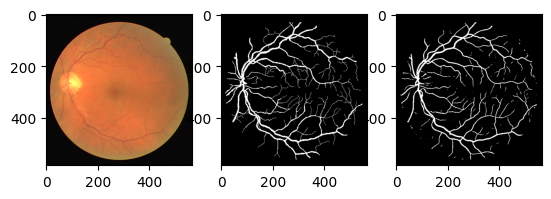

Train Epoch: 57 [0/20 (0%)]	Loss: 0.533619
Train Epoch: 57 [2/20 (10%)]	Loss: 0.591627
Train Epoch: 57 [4/20 (20%)]	Loss: 0.519929
Train Epoch: 57 [6/20 (30%)]	Loss: 0.500502
Train Epoch: 57 [8/20 (40%)]	Loss: 0.464531
Train Epoch: 57 [10/20 (50%)]	Loss: 0.469356
Train Epoch: 57 [12/20 (60%)]	Loss: 0.558189
Train Epoch: 57 [14/20 (70%)]	Loss: 0.706595
Train Epoch: 57 [16/20 (80%)]	Loss: 0.498012
Train Epoch: 57 [18/20 (90%)]	Loss: 0.530095

Test set: Avg. loss: 0.7346, Accuracy: 6294684/6599200 (95%)



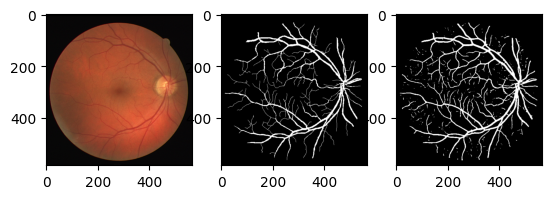

Train Epoch: 58 [0/20 (0%)]	Loss: 0.589827
Train Epoch: 58 [2/20 (10%)]	Loss: 0.570534
Train Epoch: 58 [4/20 (20%)]	Loss: 0.492900
Train Epoch: 58 [6/20 (30%)]	Loss: 0.520215
Train Epoch: 58 [8/20 (40%)]	Loss: 0.520408
Train Epoch: 58 [10/20 (50%)]	Loss: 0.542867
Train Epoch: 58 [12/20 (60%)]	Loss: 0.611720
Train Epoch: 58 [14/20 (70%)]	Loss: 0.555157
Train Epoch: 58 [16/20 (80%)]	Loss: 0.473374
Train Epoch: 58 [18/20 (90%)]	Loss: 0.419886

Test set: Avg. loss: 0.7391, Accuracy: 6340122/6599200 (96%)



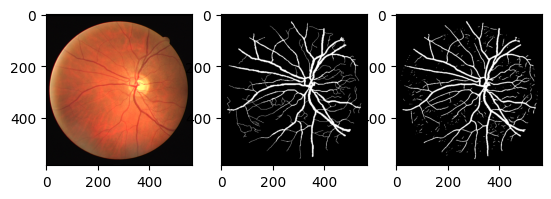

Train Epoch: 59 [0/20 (0%)]	Loss: 0.432145
Train Epoch: 59 [2/20 (10%)]	Loss: 0.411104
Train Epoch: 59 [4/20 (20%)]	Loss: 0.609574
Train Epoch: 59 [6/20 (30%)]	Loss: 0.537748
Train Epoch: 59 [8/20 (40%)]	Loss: 0.583100
Train Epoch: 59 [10/20 (50%)]	Loss: 0.549934
Train Epoch: 59 [12/20 (60%)]	Loss: 0.523164
Train Epoch: 59 [14/20 (70%)]	Loss: 0.523137
Train Epoch: 59 [16/20 (80%)]	Loss: 0.527451
Train Epoch: 59 [18/20 (90%)]	Loss: 0.489548

Test set: Avg. loss: 0.8448, Accuracy: 6365492/6599200 (96%)



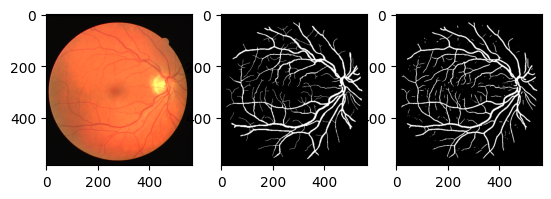

Train Epoch: 60 [0/20 (0%)]	Loss: 0.519315
Train Epoch: 60 [2/20 (10%)]	Loss: 0.484588
Train Epoch: 60 [4/20 (20%)]	Loss: 0.441689
Train Epoch: 60 [6/20 (30%)]	Loss: 0.607982
Train Epoch: 60 [8/20 (40%)]	Loss: 0.490365
Train Epoch: 60 [10/20 (50%)]	Loss: 0.515835
Train Epoch: 60 [12/20 (60%)]	Loss: 0.569936
Train Epoch: 60 [14/20 (70%)]	Loss: 0.542978
Train Epoch: 60 [16/20 (80%)]	Loss: 0.463379
Train Epoch: 60 [18/20 (90%)]	Loss: 0.467498

Test set: Avg. loss: 0.8933, Accuracy: 6353787/6599200 (96%)



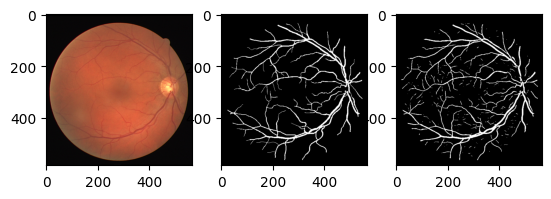

Train Epoch: 61 [0/20 (0%)]	Loss: 0.521879
Train Epoch: 61 [2/20 (10%)]	Loss: 0.512570
Train Epoch: 61 [4/20 (20%)]	Loss: 0.622087
Train Epoch: 61 [6/20 (30%)]	Loss: 0.518844
Train Epoch: 61 [8/20 (40%)]	Loss: 0.474172
Train Epoch: 61 [10/20 (50%)]	Loss: 0.599370
Train Epoch: 61 [12/20 (60%)]	Loss: 0.439452
Train Epoch: 61 [14/20 (70%)]	Loss: 0.476481
Train Epoch: 61 [16/20 (80%)]	Loss: 0.555010
Train Epoch: 61 [18/20 (90%)]	Loss: 0.462507

Test set: Avg. loss: 0.8640, Accuracy: 6364112/6599200 (96%)



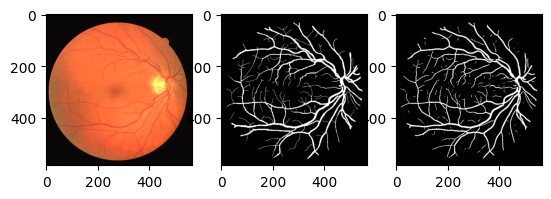

Train Epoch: 62 [0/20 (0%)]	Loss: 0.572747
Train Epoch: 62 [2/20 (10%)]	Loss: 0.528711
Train Epoch: 62 [4/20 (20%)]	Loss: 0.414384
Train Epoch: 62 [6/20 (30%)]	Loss: 0.587058
Train Epoch: 62 [8/20 (40%)]	Loss: 0.585889
Train Epoch: 62 [10/20 (50%)]	Loss: 0.454562
Train Epoch: 62 [12/20 (60%)]	Loss: 0.507209
Train Epoch: 62 [14/20 (70%)]	Loss: 0.486161
Train Epoch: 62 [16/20 (80%)]	Loss: 0.478928
Train Epoch: 62 [18/20 (90%)]	Loss: 0.544781

Test set: Avg. loss: 0.8868, Accuracy: 6368985/6599200 (97%)



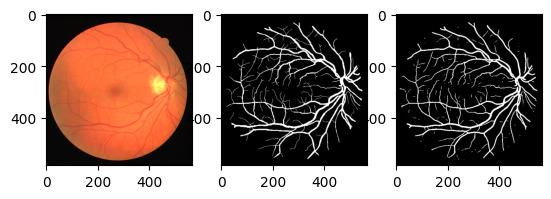

Train Epoch: 63 [0/20 (0%)]	Loss: 0.454590
Train Epoch: 63 [2/20 (10%)]	Loss: 0.514680
Train Epoch: 63 [4/20 (20%)]	Loss: 0.470097
Train Epoch: 63 [6/20 (30%)]	Loss: 0.544657
Train Epoch: 63 [8/20 (40%)]	Loss: 0.555274
Train Epoch: 63 [10/20 (50%)]	Loss: 0.571414
Train Epoch: 63 [12/20 (60%)]	Loss: 0.537948
Train Epoch: 63 [14/20 (70%)]	Loss: 0.384695
Train Epoch: 63 [16/20 (80%)]	Loss: 0.498066
Train Epoch: 63 [18/20 (90%)]	Loss: 0.573439

Test set: Avg. loss: 0.7783, Accuracy: 6363281/6599200 (96%)



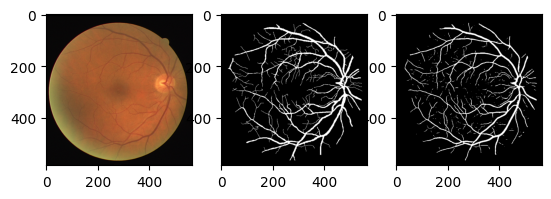

Train Epoch: 64 [0/20 (0%)]	Loss: 0.549984
Train Epoch: 64 [2/20 (10%)]	Loss: 0.581816
Train Epoch: 64 [4/20 (20%)]	Loss: 0.507039
Train Epoch: 64 [6/20 (30%)]	Loss: 0.412920
Train Epoch: 64 [8/20 (40%)]	Loss: 0.431117
Train Epoch: 64 [10/20 (50%)]	Loss: 0.443832
Train Epoch: 64 [12/20 (60%)]	Loss: 0.488967
Train Epoch: 64 [14/20 (70%)]	Loss: 0.604048
Train Epoch: 64 [16/20 (80%)]	Loss: 0.458544
Train Epoch: 64 [18/20 (90%)]	Loss: 0.539313

Test set: Avg. loss: 0.7414, Accuracy: 6312924/6599200 (96%)



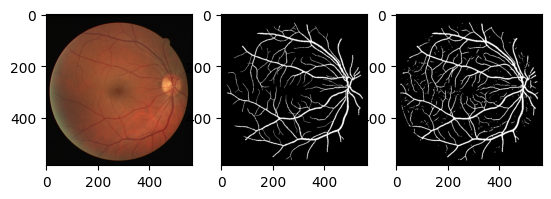

Train Epoch: 65 [0/20 (0%)]	Loss: 0.529650
Train Epoch: 65 [2/20 (10%)]	Loss: 0.558923
Train Epoch: 65 [4/20 (20%)]	Loss: 0.549753
Train Epoch: 65 [6/20 (30%)]	Loss: 0.561704
Train Epoch: 65 [8/20 (40%)]	Loss: 0.481002
Train Epoch: 65 [10/20 (50%)]	Loss: 0.482808
Train Epoch: 65 [12/20 (60%)]	Loss: 0.470785
Train Epoch: 65 [14/20 (70%)]	Loss: 0.499392
Train Epoch: 65 [16/20 (80%)]	Loss: 0.489587
Train Epoch: 65 [18/20 (90%)]	Loss: 0.381255

Test set: Avg. loss: 0.7595, Accuracy: 6338083/6599200 (96%)



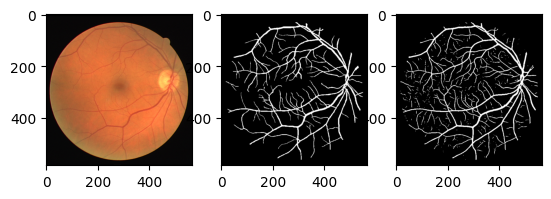

Train Epoch: 66 [0/20 (0%)]	Loss: 0.481986
Train Epoch: 66 [2/20 (10%)]	Loss: 0.550094
Train Epoch: 66 [4/20 (20%)]	Loss: 0.445738
Train Epoch: 66 [6/20 (30%)]	Loss: 0.448745
Train Epoch: 66 [8/20 (40%)]	Loss: 0.516131
Train Epoch: 66 [10/20 (50%)]	Loss: 0.422031
Train Epoch: 66 [12/20 (60%)]	Loss: 0.515825
Train Epoch: 66 [14/20 (70%)]	Loss: 0.532976
Train Epoch: 66 [16/20 (80%)]	Loss: 0.559534
Train Epoch: 66 [18/20 (90%)]	Loss: 0.386993

Test set: Avg. loss: 0.7581, Accuracy: 6298252/6599200 (95%)



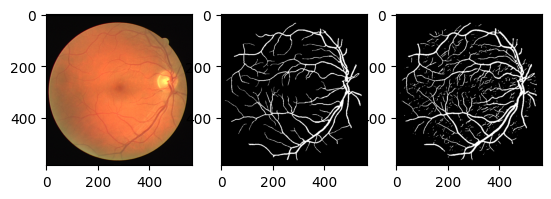

Train Epoch: 67 [0/20 (0%)]	Loss: 0.450697
Train Epoch: 67 [2/20 (10%)]	Loss: 0.543733
Train Epoch: 67 [4/20 (20%)]	Loss: 0.492970
Train Epoch: 67 [6/20 (30%)]	Loss: 0.477428
Train Epoch: 67 [8/20 (40%)]	Loss: 0.459787
Train Epoch: 67 [10/20 (50%)]	Loss: 0.480734
Train Epoch: 67 [12/20 (60%)]	Loss: 0.478733
Train Epoch: 67 [14/20 (70%)]	Loss: 0.459753
Train Epoch: 67 [16/20 (80%)]	Loss: 0.406543
Train Epoch: 67 [18/20 (90%)]	Loss: 0.439672

Test set: Avg. loss: 0.8647, Accuracy: 6361236/6599200 (96%)



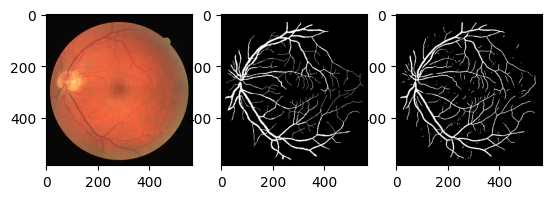

Train Epoch: 68 [0/20 (0%)]	Loss: 0.553017
Train Epoch: 68 [2/20 (10%)]	Loss: 0.492398
Train Epoch: 68 [4/20 (20%)]	Loss: 0.444013
Train Epoch: 68 [6/20 (30%)]	Loss: 0.493013
Train Epoch: 68 [8/20 (40%)]	Loss: 0.389618
Train Epoch: 68 [10/20 (50%)]	Loss: 0.506406
Train Epoch: 68 [12/20 (60%)]	Loss: 0.405398
Train Epoch: 68 [14/20 (70%)]	Loss: 0.387549
Train Epoch: 68 [16/20 (80%)]	Loss: 0.452501
Train Epoch: 68 [18/20 (90%)]	Loss: 0.481166

Test set: Avg. loss: 0.7935, Accuracy: 6340679/6599200 (96%)



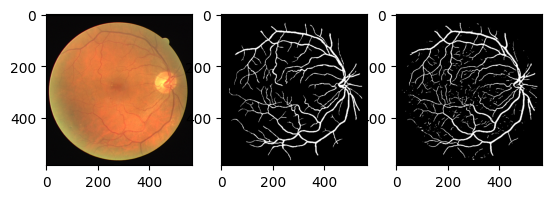

Train Epoch: 69 [0/20 (0%)]	Loss: 0.392621
Train Epoch: 69 [2/20 (10%)]	Loss: 0.436303
Train Epoch: 69 [4/20 (20%)]	Loss: 0.512869
Train Epoch: 69 [6/20 (30%)]	Loss: 0.493828
Train Epoch: 69 [8/20 (40%)]	Loss: 0.409064
Train Epoch: 69 [10/20 (50%)]	Loss: 0.479633
Train Epoch: 69 [12/20 (60%)]	Loss: 0.395969
Train Epoch: 69 [14/20 (70%)]	Loss: 0.462093
Train Epoch: 69 [16/20 (80%)]	Loss: 0.487615
Train Epoch: 69 [18/20 (90%)]	Loss: 0.393348

Test set: Avg. loss: 0.9515, Accuracy: 6352319/6599200 (96%)



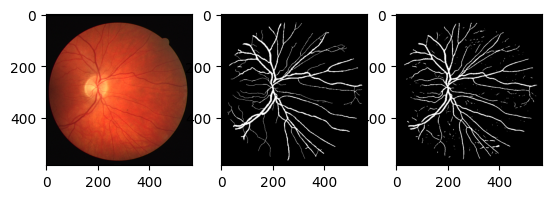

Train Epoch: 70 [0/20 (0%)]	Loss: 0.406585
Train Epoch: 70 [2/20 (10%)]	Loss: 0.463263
Train Epoch: 70 [4/20 (20%)]	Loss: 0.459458
Train Epoch: 70 [6/20 (30%)]	Loss: 0.425396
Train Epoch: 70 [8/20 (40%)]	Loss: 0.393356
Train Epoch: 70 [10/20 (50%)]	Loss: 0.496881
Train Epoch: 70 [12/20 (60%)]	Loss: 0.501215
Train Epoch: 70 [14/20 (70%)]	Loss: 0.457573
Train Epoch: 70 [16/20 (80%)]	Loss: 0.432990
Train Epoch: 70 [18/20 (90%)]	Loss: 0.406443

Test set: Avg. loss: 0.8949, Accuracy: 6354672/6599200 (96%)



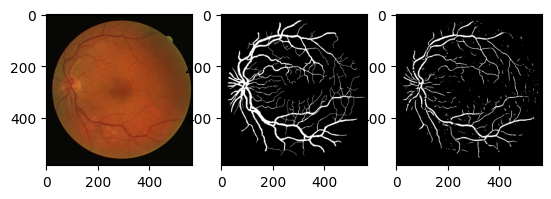

Train Epoch: 71 [0/20 (0%)]	Loss: 0.389619
Train Epoch: 71 [2/20 (10%)]	Loss: 0.500392
Train Epoch: 71 [4/20 (20%)]	Loss: 0.388166
Train Epoch: 71 [6/20 (30%)]	Loss: 0.499961
Train Epoch: 71 [8/20 (40%)]	Loss: 0.466328
Train Epoch: 71 [10/20 (50%)]	Loss: 0.427787
Train Epoch: 71 [12/20 (60%)]	Loss: 0.434250
Train Epoch: 71 [14/20 (70%)]	Loss: 0.495321
Train Epoch: 71 [16/20 (80%)]	Loss: 0.366330
Train Epoch: 71 [18/20 (90%)]	Loss: 0.461780

Test set: Avg. loss: 0.9606, Accuracy: 6351072/6599200 (96%)



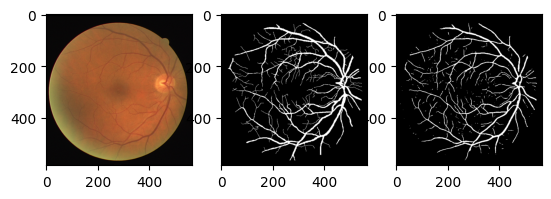

Train Epoch: 72 [0/20 (0%)]	Loss: 0.441311
Train Epoch: 72 [2/20 (10%)]	Loss: 0.360225
Train Epoch: 72 [4/20 (20%)]	Loss: 0.467868
Train Epoch: 72 [6/20 (30%)]	Loss: 0.451229
Train Epoch: 72 [8/20 (40%)]	Loss: 0.439019
Train Epoch: 72 [10/20 (50%)]	Loss: 0.444747
Train Epoch: 72 [12/20 (60%)]	Loss: 0.480125
Train Epoch: 72 [14/20 (70%)]	Loss: 0.427952
Train Epoch: 72 [16/20 (80%)]	Loss: 0.391994
Train Epoch: 72 [18/20 (90%)]	Loss: 0.453226

Test set: Avg. loss: 1.0002, Accuracy: 6364361/6599200 (96%)



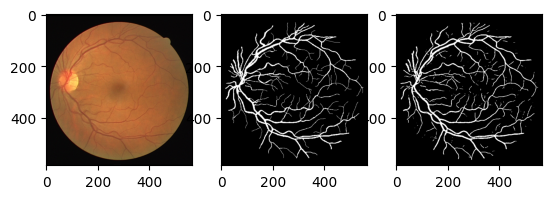

Train Epoch: 73 [0/20 (0%)]	Loss: 0.435905
Train Epoch: 73 [2/20 (10%)]	Loss: 0.363961
Train Epoch: 73 [4/20 (20%)]	Loss: 0.433254
Train Epoch: 73 [6/20 (30%)]	Loss: 0.361045
Train Epoch: 73 [8/20 (40%)]	Loss: 0.480288
Train Epoch: 73 [10/20 (50%)]	Loss: 0.373983
Train Epoch: 73 [12/20 (60%)]	Loss: 0.393451
Train Epoch: 73 [14/20 (70%)]	Loss: 0.496771
Train Epoch: 73 [16/20 (80%)]	Loss: 0.391041
Train Epoch: 73 [18/20 (90%)]	Loss: 0.487613

Test set: Avg. loss: 0.8229, Accuracy: 6319404/6599200 (96%)



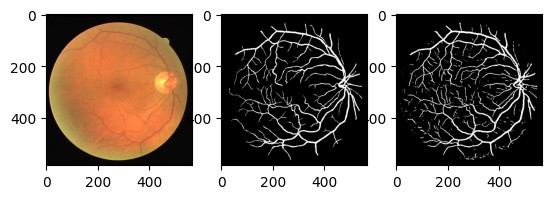

Train Epoch: 74 [0/20 (0%)]	Loss: 0.432405
Train Epoch: 74 [2/20 (10%)]	Loss: 0.367130
Train Epoch: 74 [4/20 (20%)]	Loss: 0.325511
Train Epoch: 74 [6/20 (30%)]	Loss: 0.413157
Train Epoch: 74 [8/20 (40%)]	Loss: 0.427220
Train Epoch: 74 [10/20 (50%)]	Loss: 0.506828
Train Epoch: 74 [12/20 (60%)]	Loss: 0.451727
Train Epoch: 74 [14/20 (70%)]	Loss: 0.429193
Train Epoch: 74 [16/20 (80%)]	Loss: 0.407985
Train Epoch: 74 [18/20 (90%)]	Loss: 0.398022

Test set: Avg. loss: 0.8534, Accuracy: 6298531/6599200 (95%)



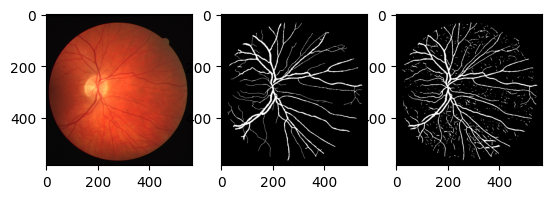

Train Epoch: 75 [0/20 (0%)]	Loss: 0.541968
Train Epoch: 75 [2/20 (10%)]	Loss: 0.424038
Train Epoch: 75 [4/20 (20%)]	Loss: 0.452679
Train Epoch: 75 [6/20 (30%)]	Loss: 0.416729
Train Epoch: 75 [8/20 (40%)]	Loss: 0.349599
Train Epoch: 75 [10/20 (50%)]	Loss: 0.396300
Train Epoch: 75 [12/20 (60%)]	Loss: 0.364884
Train Epoch: 75 [14/20 (70%)]	Loss: 0.392056
Train Epoch: 75 [16/20 (80%)]	Loss: 0.399034
Train Epoch: 75 [18/20 (90%)]	Loss: 0.415208

Test set: Avg. loss: 0.9201, Accuracy: 6357869/6599200 (96%)



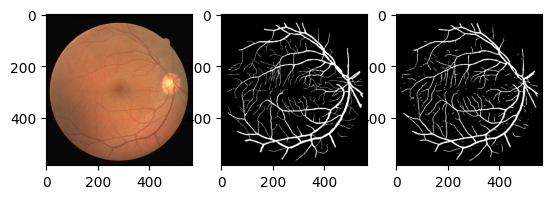

Train Epoch: 76 [0/20 (0%)]	Loss: 0.417734
Train Epoch: 76 [2/20 (10%)]	Loss: 0.437966
Train Epoch: 76 [4/20 (20%)]	Loss: 0.368313
Train Epoch: 76 [6/20 (30%)]	Loss: 0.392787
Train Epoch: 76 [8/20 (40%)]	Loss: 0.457213
Train Epoch: 76 [10/20 (50%)]	Loss: 0.429843
Train Epoch: 76 [12/20 (60%)]	Loss: 0.396681
Train Epoch: 76 [14/20 (70%)]	Loss: 0.372321
Train Epoch: 76 [16/20 (80%)]	Loss: 0.363985
Train Epoch: 76 [18/20 (90%)]	Loss: 0.387257

Test set: Avg. loss: 0.9951, Accuracy: 6356013/6599200 (96%)



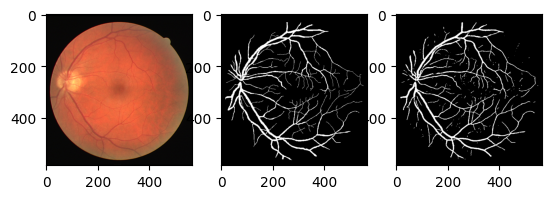

Train Epoch: 77 [0/20 (0%)]	Loss: 0.382521
Train Epoch: 77 [2/20 (10%)]	Loss: 0.403188
Train Epoch: 77 [4/20 (20%)]	Loss: 0.367487
Train Epoch: 77 [6/20 (30%)]	Loss: 0.381525
Train Epoch: 77 [8/20 (40%)]	Loss: 0.400769
Train Epoch: 77 [10/20 (50%)]	Loss: 0.399856
Train Epoch: 77 [12/20 (60%)]	Loss: 0.452680
Train Epoch: 77 [14/20 (70%)]	Loss: 0.326946
Train Epoch: 77 [16/20 (80%)]	Loss: 0.388051
Train Epoch: 77 [18/20 (90%)]	Loss: 0.367500

Test set: Avg. loss: 0.9877, Accuracy: 6356859/6599200 (96%)



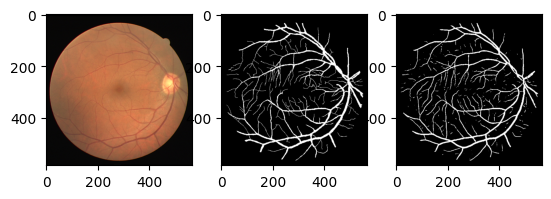

Train Epoch: 78 [0/20 (0%)]	Loss: 0.329114
Train Epoch: 78 [2/20 (10%)]	Loss: 0.310662
Train Epoch: 78 [4/20 (20%)]	Loss: 0.365491
Train Epoch: 78 [6/20 (30%)]	Loss: 0.361874
Train Epoch: 78 [8/20 (40%)]	Loss: 0.398576
Train Epoch: 78 [10/20 (50%)]	Loss: 0.428141
Train Epoch: 78 [12/20 (60%)]	Loss: 0.414798
Train Epoch: 78 [14/20 (70%)]	Loss: 0.399080
Train Epoch: 78 [16/20 (80%)]	Loss: 0.399950
Train Epoch: 78 [18/20 (90%)]	Loss: 0.319768

Test set: Avg. loss: 1.0651, Accuracy: 6350891/6599200 (96%)



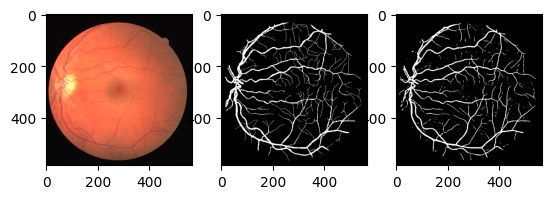

Train Epoch: 79 [0/20 (0%)]	Loss: 0.403253
Train Epoch: 79 [2/20 (10%)]	Loss: 0.320739
Train Epoch: 79 [4/20 (20%)]	Loss: 0.333830
Train Epoch: 79 [6/20 (30%)]	Loss: 0.393768
Train Epoch: 79 [8/20 (40%)]	Loss: 0.302319
Train Epoch: 79 [10/20 (50%)]	Loss: 0.353252
Train Epoch: 79 [12/20 (60%)]	Loss: 0.329532
Train Epoch: 79 [14/20 (70%)]	Loss: 0.379167
Train Epoch: 79 [16/20 (80%)]	Loss: 0.457386
Train Epoch: 79 [18/20 (90%)]	Loss: 0.412659

Test set: Avg. loss: 0.9292, Accuracy: 6294023/6599200 (95%)



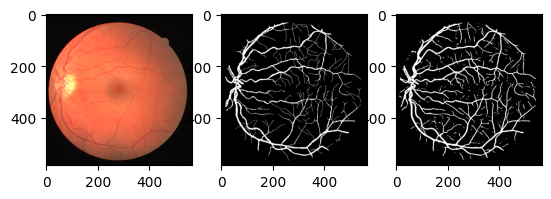

Train Epoch: 80 [0/20 (0%)]	Loss: 0.373931
Train Epoch: 80 [2/20 (10%)]	Loss: 0.390950
Train Epoch: 80 [4/20 (20%)]	Loss: 0.383384
Train Epoch: 80 [6/20 (30%)]	Loss: 0.333981
Train Epoch: 80 [8/20 (40%)]	Loss: 0.431107
Train Epoch: 80 [10/20 (50%)]	Loss: 0.373899
Train Epoch: 80 [12/20 (60%)]	Loss: 0.314033
Train Epoch: 80 [14/20 (70%)]	Loss: 0.364894
Train Epoch: 80 [16/20 (80%)]	Loss: 0.326242
Train Epoch: 80 [18/20 (90%)]	Loss: 0.378231

Test set: Avg. loss: 1.0101, Accuracy: 6363066/6599200 (96%)



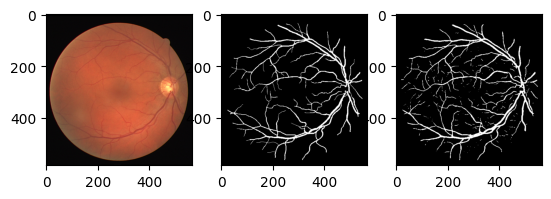

Train Epoch: 81 [0/20 (0%)]	Loss: 0.295356
Train Epoch: 81 [2/20 (10%)]	Loss: 0.428347
Train Epoch: 81 [4/20 (20%)]	Loss: 0.396830
Train Epoch: 81 [6/20 (30%)]	Loss: 0.362395
Train Epoch: 81 [8/20 (40%)]	Loss: 0.287595
Train Epoch: 81 [10/20 (50%)]	Loss: 0.396143
Train Epoch: 81 [12/20 (60%)]	Loss: 0.381883
Train Epoch: 81 [14/20 (70%)]	Loss: 0.322813
Train Epoch: 81 [16/20 (80%)]	Loss: 0.331274
Train Epoch: 81 [18/20 (90%)]	Loss: 0.372708

Test set: Avg. loss: 1.0022, Accuracy: 6339230/6599200 (96%)



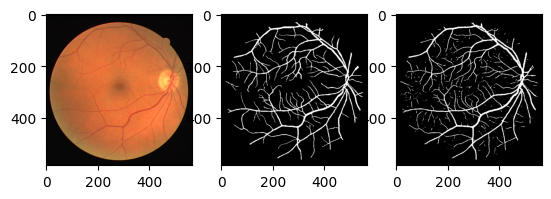

Train Epoch: 82 [0/20 (0%)]	Loss: 0.379754
Train Epoch: 82 [2/20 (10%)]	Loss: 0.338672
Train Epoch: 82 [4/20 (20%)]	Loss: 0.296827
Train Epoch: 82 [6/20 (30%)]	Loss: 0.388511
Train Epoch: 82 [8/20 (40%)]	Loss: 0.342761
Train Epoch: 82 [10/20 (50%)]	Loss: 0.385239
Train Epoch: 82 [12/20 (60%)]	Loss: 0.362911
Train Epoch: 82 [14/20 (70%)]	Loss: 0.440111
Train Epoch: 82 [16/20 (80%)]	Loss: 0.317306
Train Epoch: 82 [18/20 (90%)]	Loss: 0.369729

Test set: Avg. loss: 0.9449, Accuracy: 6320399/6599200 (96%)



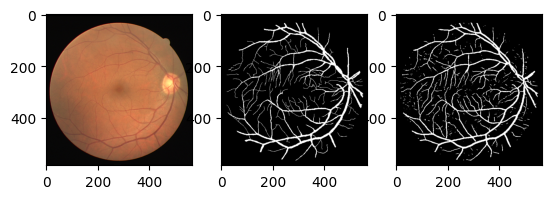

Train Epoch: 83 [0/20 (0%)]	Loss: 0.332422
Train Epoch: 83 [2/20 (10%)]	Loss: 0.317532
Train Epoch: 83 [4/20 (20%)]	Loss: 0.350476
Train Epoch: 83 [6/20 (30%)]	Loss: 0.393943
Train Epoch: 83 [8/20 (40%)]	Loss: 0.353452
Train Epoch: 83 [10/20 (50%)]	Loss: 0.330974
Train Epoch: 83 [12/20 (60%)]	Loss: 0.352982
Train Epoch: 83 [14/20 (70%)]	Loss: 0.339368
Train Epoch: 83 [16/20 (80%)]	Loss: 0.364109
Train Epoch: 83 [18/20 (90%)]	Loss: 0.357792

Test set: Avg. loss: 1.1095, Accuracy: 6353937/6599200 (96%)



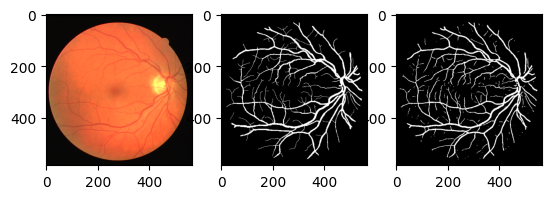

Train Epoch: 84 [0/20 (0%)]	Loss: 0.349571
Train Epoch: 84 [2/20 (10%)]	Loss: 0.326094
Train Epoch: 84 [4/20 (20%)]	Loss: 0.319773
Train Epoch: 84 [6/20 (30%)]	Loss: 0.407091
Train Epoch: 84 [8/20 (40%)]	Loss: 0.297995
Train Epoch: 84 [10/20 (50%)]	Loss: 0.312816
Train Epoch: 84 [12/20 (60%)]	Loss: 0.379650
Train Epoch: 84 [14/20 (70%)]	Loss: 0.352885
Train Epoch: 84 [16/20 (80%)]	Loss: 0.293235
Train Epoch: 84 [18/20 (90%)]	Loss: 0.300639

Test set: Avg. loss: 1.0397, Accuracy: 6357688/6599200 (96%)



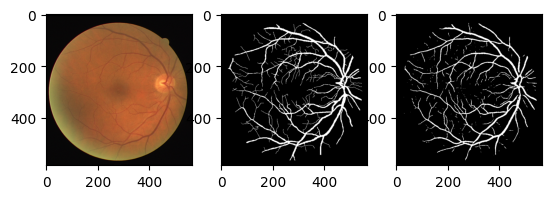

Train Epoch: 85 [0/20 (0%)]	Loss: 0.338250
Train Epoch: 85 [2/20 (10%)]	Loss: 0.336331
Train Epoch: 85 [4/20 (20%)]	Loss: 0.316279
Train Epoch: 85 [6/20 (30%)]	Loss: 0.303230
Train Epoch: 85 [8/20 (40%)]	Loss: 0.341531
Train Epoch: 85 [10/20 (50%)]	Loss: 0.277982
Train Epoch: 85 [12/20 (60%)]	Loss: 0.350776
Train Epoch: 85 [14/20 (70%)]	Loss: 0.286028
Train Epoch: 85 [16/20 (80%)]	Loss: 0.289819
Train Epoch: 85 [18/20 (90%)]	Loss: 0.328378

Test set: Avg. loss: 1.1644, Accuracy: 6356906/6599200 (96%)



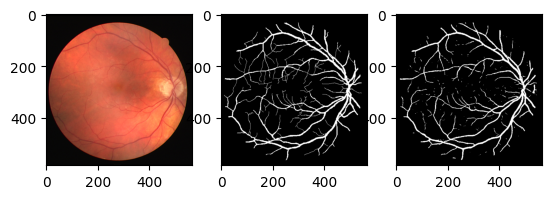

Train Epoch: 86 [0/20 (0%)]	Loss: 0.291324
Train Epoch: 86 [2/20 (10%)]	Loss: 0.308537
Train Epoch: 86 [4/20 (20%)]	Loss: 0.282726
Train Epoch: 86 [6/20 (30%)]	Loss: 0.297520
Train Epoch: 86 [8/20 (40%)]	Loss: 0.334882
Train Epoch: 86 [10/20 (50%)]	Loss: 0.252935
Train Epoch: 86 [12/20 (60%)]	Loss: 0.278223
Train Epoch: 86 [14/20 (70%)]	Loss: 0.316239
Train Epoch: 86 [16/20 (80%)]	Loss: 0.310915
Train Epoch: 86 [18/20 (90%)]	Loss: 0.326022

Test set: Avg. loss: 1.1285, Accuracy: 6352216/6599200 (96%)



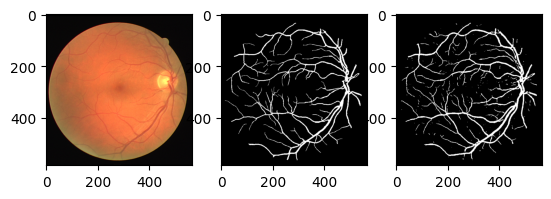

Train Epoch: 87 [0/20 (0%)]	Loss: 0.258681
Train Epoch: 87 [2/20 (10%)]	Loss: 0.318674
Train Epoch: 87 [4/20 (20%)]	Loss: 0.252910
Train Epoch: 87 [6/20 (30%)]	Loss: 0.313393
Train Epoch: 87 [8/20 (40%)]	Loss: 0.297404
Train Epoch: 87 [10/20 (50%)]	Loss: 0.268100
Train Epoch: 87 [12/20 (60%)]	Loss: 0.328687
Train Epoch: 87 [14/20 (70%)]	Loss: 0.355895
Train Epoch: 87 [16/20 (80%)]	Loss: 0.246667
Train Epoch: 87 [18/20 (90%)]	Loss: 0.314764

Test set: Avg. loss: 1.1227, Accuracy: 6348719/6599200 (96%)



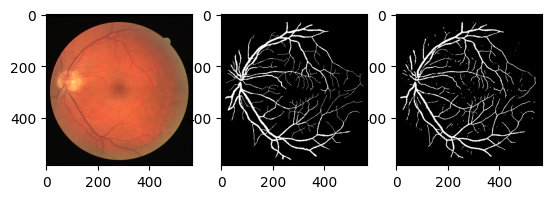

Train Epoch: 88 [0/20 (0%)]	Loss: 0.256977
Train Epoch: 88 [2/20 (10%)]	Loss: 0.288261
Train Epoch: 88 [4/20 (20%)]	Loss: 0.286548
Train Epoch: 88 [6/20 (30%)]	Loss: 0.292538
Train Epoch: 88 [8/20 (40%)]	Loss: 0.377225
Train Epoch: 88 [10/20 (50%)]	Loss: 0.242427
Train Epoch: 88 [12/20 (60%)]	Loss: 0.311031
Train Epoch: 88 [14/20 (70%)]	Loss: 0.321700
Train Epoch: 88 [16/20 (80%)]	Loss: 0.299956
Train Epoch: 88 [18/20 (90%)]	Loss: 0.311418

Test set: Avg. loss: 1.1708, Accuracy: 6352110/6599200 (96%)



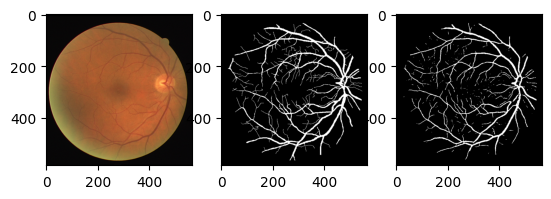

Train Epoch: 89 [0/20 (0%)]	Loss: 0.225906
Train Epoch: 89 [2/20 (10%)]	Loss: 0.268573
Train Epoch: 89 [4/20 (20%)]	Loss: 0.319467
Train Epoch: 89 [6/20 (30%)]	Loss: 0.290661
Train Epoch: 89 [8/20 (40%)]	Loss: 0.310296
Train Epoch: 89 [10/20 (50%)]	Loss: 0.245470
Train Epoch: 89 [12/20 (60%)]	Loss: 0.296386
Train Epoch: 89 [14/20 (70%)]	Loss: 0.339619
Train Epoch: 89 [16/20 (80%)]	Loss: 0.278782
Train Epoch: 89 [18/20 (90%)]	Loss: 0.274957

Test set: Avg. loss: 1.1429, Accuracy: 6348034/6599200 (96%)



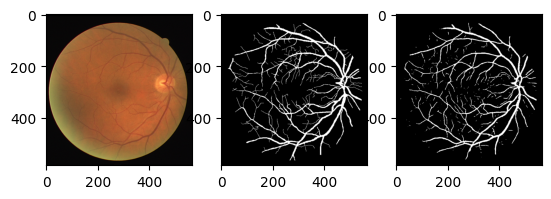

Train Epoch: 90 [0/20 (0%)]	Loss: 0.263932
Train Epoch: 90 [2/20 (10%)]	Loss: 0.276351
Train Epoch: 90 [4/20 (20%)]	Loss: 0.223623
Train Epoch: 90 [6/20 (30%)]	Loss: 0.290620
Train Epoch: 90 [8/20 (40%)]	Loss: 0.239828
Train Epoch: 90 [10/20 (50%)]	Loss: 0.306629
Train Epoch: 90 [12/20 (60%)]	Loss: 0.333290
Train Epoch: 90 [14/20 (70%)]	Loss: 0.241686
Train Epoch: 90 [16/20 (80%)]	Loss: 0.292463
Train Epoch: 90 [18/20 (90%)]	Loss: 0.293783

Test set: Avg. loss: 1.1369, Accuracy: 6329907/6599200 (96%)



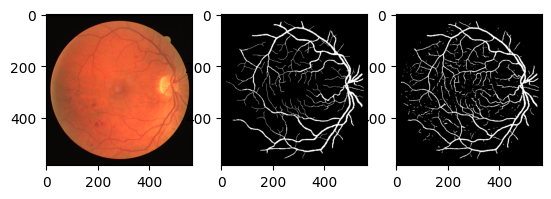

Train Epoch: 91 [0/20 (0%)]	Loss: 0.297992
Train Epoch: 91 [2/20 (10%)]	Loss: 0.279793
Train Epoch: 91 [4/20 (20%)]	Loss: 0.220262
Train Epoch: 91 [6/20 (30%)]	Loss: 0.268158
Train Epoch: 91 [8/20 (40%)]	Loss: 0.264984
Train Epoch: 91 [10/20 (50%)]	Loss: 0.271016
Train Epoch: 91 [12/20 (60%)]	Loss: 0.257479
Train Epoch: 91 [14/20 (70%)]	Loss: 0.272015
Train Epoch: 91 [16/20 (80%)]	Loss: 0.250125
Train Epoch: 91 [18/20 (90%)]	Loss: 0.292273

Test set: Avg. loss: 1.1533, Accuracy: 6336367/6599200 (96%)



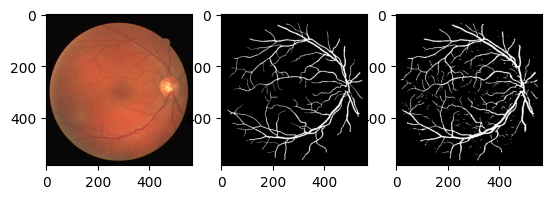

Train Epoch: 92 [0/20 (0%)]	Loss: 0.292546
Train Epoch: 92 [2/20 (10%)]	Loss: 0.264167
Train Epoch: 92 [4/20 (20%)]	Loss: 0.242992
Train Epoch: 92 [6/20 (30%)]	Loss: 0.271265
Train Epoch: 92 [8/20 (40%)]	Loss: 0.219122
Train Epoch: 92 [10/20 (50%)]	Loss: 0.236394
Train Epoch: 92 [12/20 (60%)]	Loss: 0.268104
Train Epoch: 92 [14/20 (70%)]	Loss: 0.269465
Train Epoch: 92 [16/20 (80%)]	Loss: 0.227100
Train Epoch: 92 [18/20 (90%)]	Loss: 0.243773

Test set: Avg. loss: 1.3263, Accuracy: 6359639/6599200 (96%)



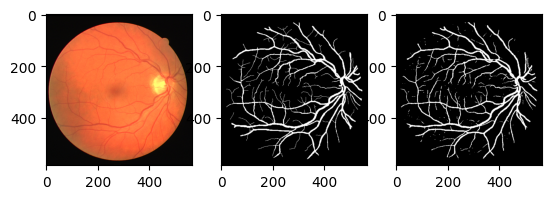

Train Epoch: 93 [0/20 (0%)]	Loss: 0.254834
Train Epoch: 93 [2/20 (10%)]	Loss: 0.217824
Train Epoch: 93 [4/20 (20%)]	Loss: 0.263309
Train Epoch: 93 [6/20 (30%)]	Loss: 0.229319
Train Epoch: 93 [8/20 (40%)]	Loss: 0.253264
Train Epoch: 93 [10/20 (50%)]	Loss: 0.268864
Train Epoch: 93 [12/20 (60%)]	Loss: 0.260978
Train Epoch: 93 [14/20 (70%)]	Loss: 0.271566
Train Epoch: 93 [16/20 (80%)]	Loss: 0.261888
Train Epoch: 93 [18/20 (90%)]	Loss: 0.230490

Test set: Avg. loss: 1.2445, Accuracy: 6346717/6599200 (96%)



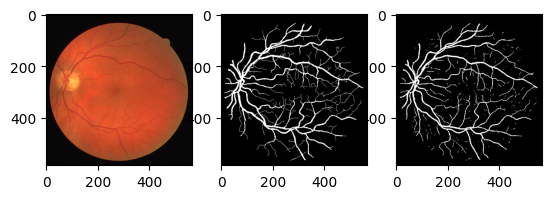

Train Epoch: 94 [0/20 (0%)]	Loss: 0.246707
Train Epoch: 94 [2/20 (10%)]	Loss: 0.227001
Train Epoch: 94 [4/20 (20%)]	Loss: 0.205742
Train Epoch: 94 [6/20 (30%)]	Loss: 0.217912
Train Epoch: 94 [8/20 (40%)]	Loss: 0.252945
Train Epoch: 94 [10/20 (50%)]	Loss: 0.225995
Train Epoch: 94 [12/20 (60%)]	Loss: 0.229490
Train Epoch: 94 [14/20 (70%)]	Loss: 0.345120
Train Epoch: 94 [16/20 (80%)]	Loss: 0.252028
Train Epoch: 94 [18/20 (90%)]	Loss: 0.259729

Test set: Avg. loss: 1.2229, Accuracy: 6332331/6599200 (96%)



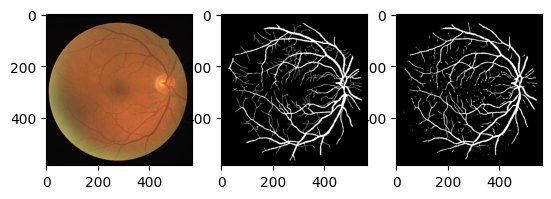

Train Epoch: 95 [0/20 (0%)]	Loss: 0.248836
Train Epoch: 95 [2/20 (10%)]	Loss: 0.199592
Train Epoch: 95 [4/20 (20%)]	Loss: 0.255101
Train Epoch: 95 [6/20 (30%)]	Loss: 0.238518
Train Epoch: 95 [8/20 (40%)]	Loss: 0.259458
Train Epoch: 95 [10/20 (50%)]	Loss: 0.270610
Train Epoch: 95 [12/20 (60%)]	Loss: 0.261913
Train Epoch: 95 [14/20 (70%)]	Loss: 0.249989
Train Epoch: 95 [16/20 (80%)]	Loss: 0.206504
Train Epoch: 95 [18/20 (90%)]	Loss: 0.208458

Test set: Avg. loss: 1.4121, Accuracy: 6356907/6599200 (96%)



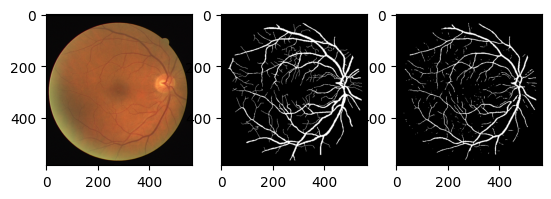

Train Epoch: 96 [0/20 (0%)]	Loss: 0.315180
Train Epoch: 96 [2/20 (10%)]	Loss: 0.225335
Train Epoch: 96 [4/20 (20%)]	Loss: 0.213083
Train Epoch: 96 [6/20 (30%)]	Loss: 0.226962
Train Epoch: 96 [8/20 (40%)]	Loss: 0.226390
Train Epoch: 96 [10/20 (50%)]	Loss: 0.247425
Train Epoch: 96 [12/20 (60%)]	Loss: 0.238043
Train Epoch: 96 [14/20 (70%)]	Loss: 0.205429
Train Epoch: 96 [16/20 (80%)]	Loss: 0.232802
Train Epoch: 96 [18/20 (90%)]	Loss: 0.256491

Test set: Avg. loss: 1.2563, Accuracy: 6332028/6599200 (96%)



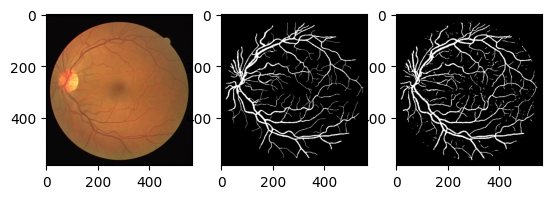

Train Epoch: 97 [0/20 (0%)]	Loss: 0.208965
Train Epoch: 97 [2/20 (10%)]	Loss: 0.228817
Train Epoch: 97 [4/20 (20%)]	Loss: 0.206115
Train Epoch: 97 [6/20 (30%)]	Loss: 0.213995
Train Epoch: 97 [8/20 (40%)]	Loss: 0.229663
Train Epoch: 97 [10/20 (50%)]	Loss: 0.203070
Train Epoch: 97 [12/20 (60%)]	Loss: 0.234141
Train Epoch: 97 [14/20 (70%)]	Loss: 0.203738
Train Epoch: 97 [16/20 (80%)]	Loss: 0.196475
Train Epoch: 97 [18/20 (90%)]	Loss: 0.284918

Test set: Avg. loss: 1.2539, Accuracy: 6344170/6599200 (96%)



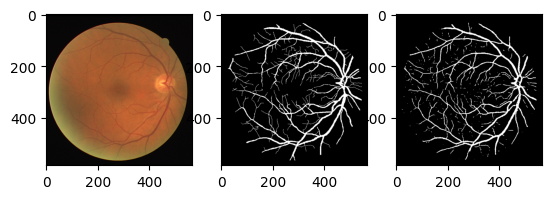

Train Epoch: 98 [0/20 (0%)]	Loss: 0.194997
Train Epoch: 98 [2/20 (10%)]	Loss: 0.192695
Train Epoch: 98 [4/20 (20%)]	Loss: 0.238363
Train Epoch: 98 [6/20 (30%)]	Loss: 0.214801
Train Epoch: 98 [8/20 (40%)]	Loss: 0.216634
Train Epoch: 98 [10/20 (50%)]	Loss: 0.214577
Train Epoch: 98 [12/20 (60%)]	Loss: 0.189317
Train Epoch: 98 [14/20 (70%)]	Loss: 0.241863
Train Epoch: 98 [16/20 (80%)]	Loss: 0.241789
Train Epoch: 98 [18/20 (90%)]	Loss: 0.207903

Test set: Avg. loss: 1.4084, Accuracy: 6350645/6599200 (96%)



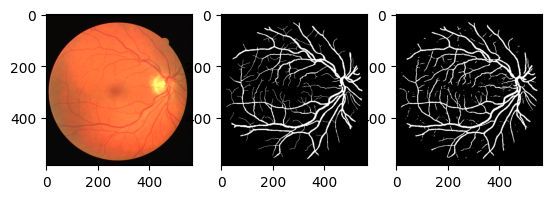

Train Epoch: 99 [0/20 (0%)]	Loss: 0.258651
Train Epoch: 99 [2/20 (10%)]	Loss: 0.218139
Train Epoch: 99 [4/20 (20%)]	Loss: 0.236042
Train Epoch: 99 [6/20 (30%)]	Loss: 0.207573
Train Epoch: 99 [8/20 (40%)]	Loss: 0.213724
Train Epoch: 99 [10/20 (50%)]	Loss: 0.206228
Train Epoch: 99 [12/20 (60%)]	Loss: 0.166391
Train Epoch: 99 [14/20 (70%)]	Loss: 0.242016
Train Epoch: 99 [16/20 (80%)]	Loss: 0.230063
Train Epoch: 99 [18/20 (90%)]	Loss: 0.195098

Test set: Avg. loss: 1.2740, Accuracy: 6355357/6599200 (96%)



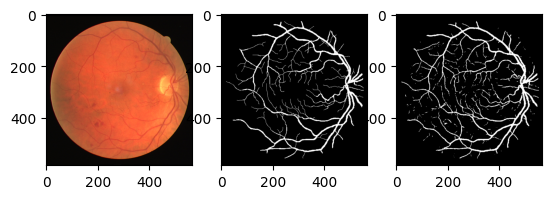

Train Epoch: 100 [0/20 (0%)]	Loss: 0.198204
Train Epoch: 100 [2/20 (10%)]	Loss: 0.240696
Train Epoch: 100 [4/20 (20%)]	Loss: 0.203599
Train Epoch: 100 [6/20 (30%)]	Loss: 0.197064
Train Epoch: 100 [8/20 (40%)]	Loss: 0.222571
Train Epoch: 100 [10/20 (50%)]	Loss: 0.210420
Train Epoch: 100 [12/20 (60%)]	Loss: 0.193138
Train Epoch: 100 [14/20 (70%)]	Loss: 0.215858
Train Epoch: 100 [16/20 (80%)]	Loss: 0.154704
Train Epoch: 100 [18/20 (90%)]	Loss: 0.223572

Test set: Avg. loss: 1.3759, Accuracy: 6354474/6599200 (96%)



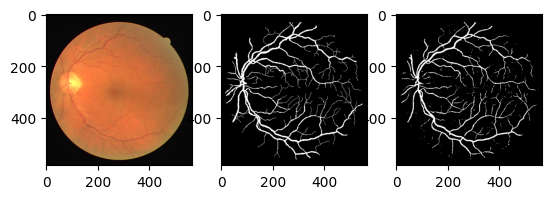

Train Epoch: 101 [0/20 (0%)]	Loss: 0.194340
Train Epoch: 101 [2/20 (10%)]	Loss: 0.181810
Train Epoch: 101 [4/20 (20%)]	Loss: 0.186213
Train Epoch: 101 [6/20 (30%)]	Loss: 0.164224
Train Epoch: 101 [8/20 (40%)]	Loss: 0.205567
Train Epoch: 101 [10/20 (50%)]	Loss: 0.134715
Train Epoch: 101 [12/20 (60%)]	Loss: 0.190660
Train Epoch: 101 [14/20 (70%)]	Loss: 0.165756
Train Epoch: 101 [16/20 (80%)]	Loss: 0.193772
Train Epoch: 101 [18/20 (90%)]	Loss: 0.163569

Test set: Avg. loss: 1.4660, Accuracy: 6360639/6599200 (96%)



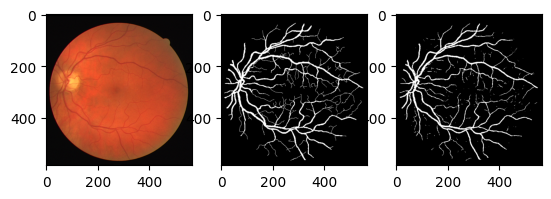

Train Epoch: 102 [0/20 (0%)]	Loss: 0.165571
Train Epoch: 102 [2/20 (10%)]	Loss: 0.179280
Train Epoch: 102 [4/20 (20%)]	Loss: 0.164329
Train Epoch: 102 [6/20 (30%)]	Loss: 0.145014
Train Epoch: 102 [8/20 (40%)]	Loss: 0.161539
Train Epoch: 102 [10/20 (50%)]	Loss: 0.153656
Train Epoch: 102 [12/20 (60%)]	Loss: 0.144859
Train Epoch: 102 [14/20 (70%)]	Loss: 0.146386
Train Epoch: 102 [16/20 (80%)]	Loss: 0.166854
Train Epoch: 102 [18/20 (90%)]	Loss: 0.146554

Test set: Avg. loss: 1.4970, Accuracy: 6364380/6599200 (96%)



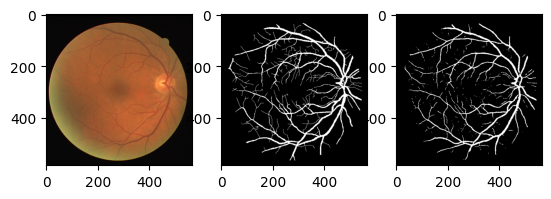

Train Epoch: 103 [0/20 (0%)]	Loss: 0.141317
Train Epoch: 103 [2/20 (10%)]	Loss: 0.142475
Train Epoch: 103 [4/20 (20%)]	Loss: 0.166465
Train Epoch: 103 [6/20 (30%)]	Loss: 0.141911
Train Epoch: 103 [8/20 (40%)]	Loss: 0.145245
Train Epoch: 103 [10/20 (50%)]	Loss: 0.135992
Train Epoch: 103 [12/20 (60%)]	Loss: 0.135754
Train Epoch: 103 [14/20 (70%)]	Loss: 0.166058
Train Epoch: 103 [16/20 (80%)]	Loss: 0.131382
Train Epoch: 103 [18/20 (90%)]	Loss: 0.123569

Test set: Avg. loss: 1.5739, Accuracy: 6362133/6599200 (96%)



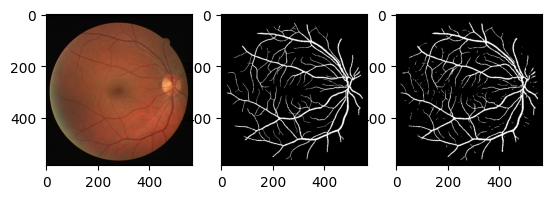

Train Epoch: 104 [0/20 (0%)]	Loss: 0.112709
Train Epoch: 104 [2/20 (10%)]	Loss: 0.128071
Train Epoch: 104 [4/20 (20%)]	Loss: 0.157645
Train Epoch: 104 [6/20 (30%)]	Loss: 0.124649
Train Epoch: 104 [8/20 (40%)]	Loss: 0.136647
Train Epoch: 104 [10/20 (50%)]	Loss: 0.136271
Train Epoch: 104 [12/20 (60%)]	Loss: 0.161012
Train Epoch: 104 [14/20 (70%)]	Loss: 0.129126
Train Epoch: 104 [16/20 (80%)]	Loss: 0.115580
Train Epoch: 104 [18/20 (90%)]	Loss: 0.108564

Test set: Avg. loss: 1.6311, Accuracy: 6360254/6599200 (96%)



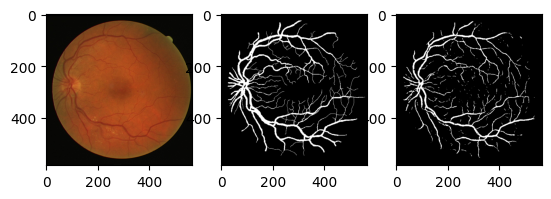

Train Epoch: 105 [0/20 (0%)]	Loss: 0.111832
Train Epoch: 105 [2/20 (10%)]	Loss: 0.134523
Train Epoch: 105 [4/20 (20%)]	Loss: 0.106472
Train Epoch: 105 [6/20 (30%)]	Loss: 0.139867
Train Epoch: 105 [8/20 (40%)]	Loss: 0.156243
Train Epoch: 105 [10/20 (50%)]	Loss: 0.122042
Train Epoch: 105 [12/20 (60%)]	Loss: 0.128117
Train Epoch: 105 [14/20 (70%)]	Loss: 0.139671
Train Epoch: 105 [16/20 (80%)]	Loss: 0.136717
Train Epoch: 105 [18/20 (90%)]	Loss: 0.114743

Test set: Avg. loss: 1.6185, Accuracy: 6359003/6599200 (96%)



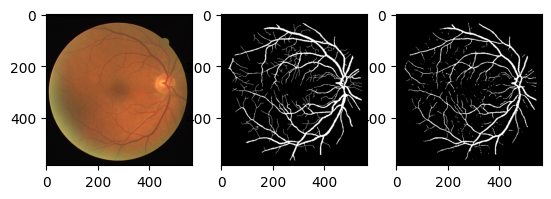

Train Epoch: 106 [0/20 (0%)]	Loss: 0.113773
Train Epoch: 106 [2/20 (10%)]	Loss: 0.116052
Train Epoch: 106 [4/20 (20%)]	Loss: 0.108066
Train Epoch: 106 [6/20 (30%)]	Loss: 0.119882
Train Epoch: 106 [8/20 (40%)]	Loss: 0.118734
Train Epoch: 106 [10/20 (50%)]	Loss: 0.142916
Train Epoch: 106 [12/20 (60%)]	Loss: 0.134358
Train Epoch: 106 [14/20 (70%)]	Loss: 0.112267
Train Epoch: 106 [16/20 (80%)]	Loss: 0.117762
Train Epoch: 106 [18/20 (90%)]	Loss: 0.149562

Test set: Avg. loss: 1.7542, Accuracy: 6361028/6599200 (96%)



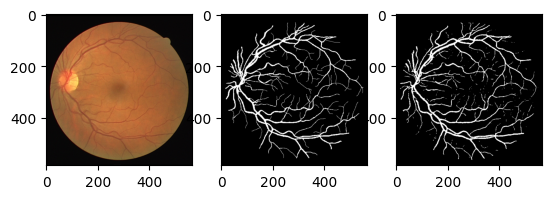

Train Epoch: 107 [0/20 (0%)]	Loss: 0.131805
Train Epoch: 107 [2/20 (10%)]	Loss: 0.089512
Train Epoch: 107 [4/20 (20%)]	Loss: 0.153884
Train Epoch: 107 [6/20 (30%)]	Loss: 0.104724
Train Epoch: 107 [8/20 (40%)]	Loss: 0.140175
Train Epoch: 107 [10/20 (50%)]	Loss: 0.131110
Train Epoch: 107 [12/20 (60%)]	Loss: 0.098150
Train Epoch: 107 [14/20 (70%)]	Loss: 0.107798
Train Epoch: 107 [16/20 (80%)]	Loss: 0.139323
Train Epoch: 107 [18/20 (90%)]	Loss: 0.108347

Test set: Avg. loss: 1.6668, Accuracy: 6357669/6599200 (96%)



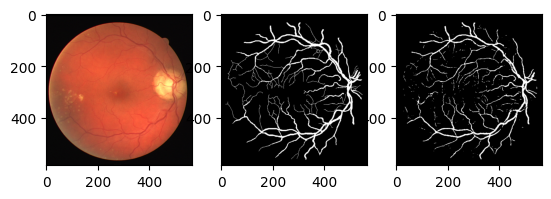

Train Epoch: 108 [0/20 (0%)]	Loss: 0.114829
Train Epoch: 108 [2/20 (10%)]	Loss: 0.129941
Train Epoch: 108 [4/20 (20%)]	Loss: 0.135655
Train Epoch: 108 [6/20 (30%)]	Loss: 0.133234
Train Epoch: 108 [8/20 (40%)]	Loss: 0.112114
Train Epoch: 108 [10/20 (50%)]	Loss: 0.109861
Train Epoch: 108 [12/20 (60%)]	Loss: 0.127128
Train Epoch: 108 [14/20 (70%)]	Loss: 0.093457
Train Epoch: 108 [16/20 (80%)]	Loss: 0.124869
Train Epoch: 108 [18/20 (90%)]	Loss: 0.103214

Test set: Avg. loss: 1.7182, Accuracy: 6360220/6599200 (96%)



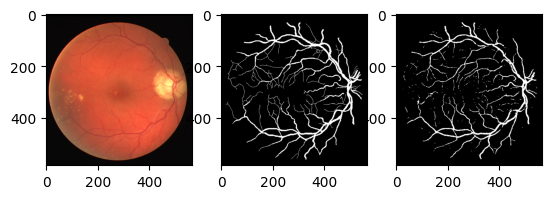

Train Epoch: 109 [0/20 (0%)]	Loss: 0.095574
Train Epoch: 109 [2/20 (10%)]	Loss: 0.109762
Train Epoch: 109 [4/20 (20%)]	Loss: 0.109087
Train Epoch: 109 [6/20 (30%)]	Loss: 0.088645
Train Epoch: 109 [8/20 (40%)]	Loss: 0.121944
Train Epoch: 109 [10/20 (50%)]	Loss: 0.103997
Train Epoch: 109 [12/20 (60%)]	Loss: 0.120194
Train Epoch: 109 [14/20 (70%)]	Loss: 0.106712
Train Epoch: 109 [16/20 (80%)]	Loss: 0.130401
Train Epoch: 109 [18/20 (90%)]	Loss: 0.134792

Test set: Avg. loss: 1.7719, Accuracy: 6360288/6599200 (96%)



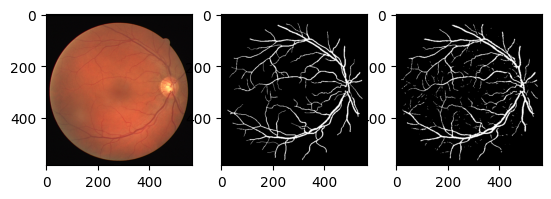

Train Epoch: 110 [0/20 (0%)]	Loss: 0.079844
Train Epoch: 110 [2/20 (10%)]	Loss: 0.106157
Train Epoch: 110 [4/20 (20%)]	Loss: 0.103110
Train Epoch: 110 [6/20 (30%)]	Loss: 0.097820
Train Epoch: 110 [8/20 (40%)]	Loss: 0.097074
Train Epoch: 110 [10/20 (50%)]	Loss: 0.110471
Train Epoch: 110 [12/20 (60%)]	Loss: 0.100118
Train Epoch: 110 [14/20 (70%)]	Loss: 0.092498
Train Epoch: 110 [16/20 (80%)]	Loss: 0.110408
Train Epoch: 110 [18/20 (90%)]	Loss: 0.114444

Test set: Avg. loss: 1.8018, Accuracy: 6361731/6599200 (96%)



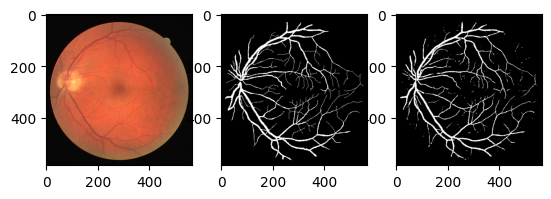

Train Epoch: 111 [0/20 (0%)]	Loss: 0.099743
Train Epoch: 111 [2/20 (10%)]	Loss: 0.114934
Train Epoch: 111 [4/20 (20%)]	Loss: 0.080817
Train Epoch: 111 [6/20 (30%)]	Loss: 0.091930
Train Epoch: 111 [8/20 (40%)]	Loss: 0.092161
Train Epoch: 111 [10/20 (50%)]	Loss: 0.109547
Train Epoch: 111 [12/20 (60%)]	Loss: 0.094544
Train Epoch: 111 [14/20 (70%)]	Loss: 0.102456
Train Epoch: 111 [16/20 (80%)]	Loss: 0.100024
Train Epoch: 111 [18/20 (90%)]	Loss: 0.099622

Test set: Avg. loss: 1.7904, Accuracy: 6358698/6599200 (96%)



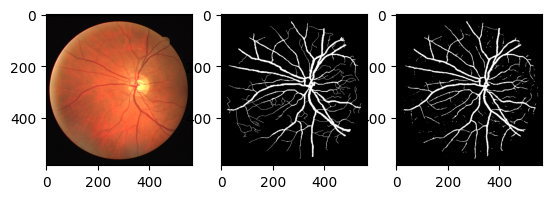

Train Epoch: 112 [0/20 (0%)]	Loss: 0.118326
Train Epoch: 112 [2/20 (10%)]	Loss: 0.091098
Train Epoch: 112 [4/20 (20%)]	Loss: 0.097229
Train Epoch: 112 [6/20 (30%)]	Loss: 0.080550
Train Epoch: 112 [8/20 (40%)]	Loss: 0.093245
Train Epoch: 112 [10/20 (50%)]	Loss: 0.086621
Train Epoch: 112 [12/20 (60%)]	Loss: 0.146811
Train Epoch: 112 [14/20 (70%)]	Loss: 0.133566
Train Epoch: 112 [16/20 (80%)]	Loss: 0.098249
Train Epoch: 112 [18/20 (90%)]	Loss: 0.092355

Test set: Avg. loss: 1.7944, Accuracy: 6354986/6599200 (96%)



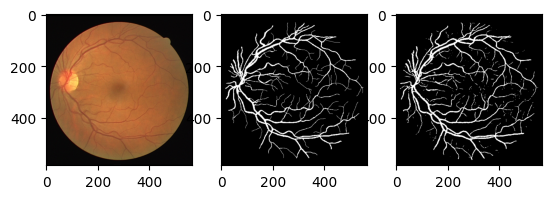

Train Epoch: 113 [0/20 (0%)]	Loss: 0.109371
Train Epoch: 113 [2/20 (10%)]	Loss: 0.112374
Train Epoch: 113 [4/20 (20%)]	Loss: 0.101541
Train Epoch: 113 [6/20 (30%)]	Loss: 0.093689
Train Epoch: 113 [8/20 (40%)]	Loss: 0.078705
Train Epoch: 113 [10/20 (50%)]	Loss: 0.099341
Train Epoch: 113 [12/20 (60%)]	Loss: 0.105123
Train Epoch: 113 [14/20 (70%)]	Loss: 0.095020
Train Epoch: 113 [16/20 (80%)]	Loss: 0.115681
Train Epoch: 113 [18/20 (90%)]	Loss: 0.118352

Test set: Avg. loss: 1.8562, Accuracy: 6359600/6599200 (96%)



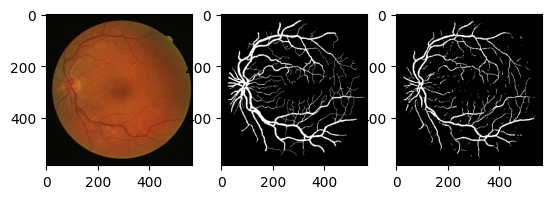

Train Epoch: 114 [0/20 (0%)]	Loss: 0.098349
Train Epoch: 114 [2/20 (10%)]	Loss: 0.086099
Train Epoch: 114 [4/20 (20%)]	Loss: 0.114491
Train Epoch: 114 [6/20 (30%)]	Loss: 0.094812
Train Epoch: 114 [8/20 (40%)]	Loss: 0.100819
Train Epoch: 114 [10/20 (50%)]	Loss: 0.095936
Train Epoch: 114 [12/20 (60%)]	Loss: 0.092740
Train Epoch: 114 [14/20 (70%)]	Loss: 0.128102
Train Epoch: 114 [16/20 (80%)]	Loss: 0.095450
Train Epoch: 114 [18/20 (90%)]	Loss: 0.106209

Test set: Avg. loss: 1.8392, Accuracy: 6353300/6599200 (96%)



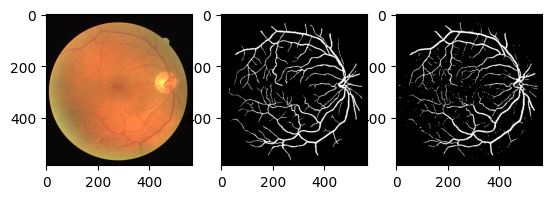

Train Epoch: 115 [0/20 (0%)]	Loss: 0.088118
Train Epoch: 115 [2/20 (10%)]	Loss: 0.109605
Train Epoch: 115 [4/20 (20%)]	Loss: 0.094387
Train Epoch: 115 [6/20 (30%)]	Loss: 0.124669
Train Epoch: 115 [8/20 (40%)]	Loss: 0.105346
Train Epoch: 115 [10/20 (50%)]	Loss: 0.093897
Train Epoch: 115 [12/20 (60%)]	Loss: 0.084217
Train Epoch: 115 [14/20 (70%)]	Loss: 0.118438
Train Epoch: 115 [16/20 (80%)]	Loss: 0.118948
Train Epoch: 115 [18/20 (90%)]	Loss: 0.090886

Test set: Avg. loss: 1.8288, Accuracy: 6354735/6599200 (96%)



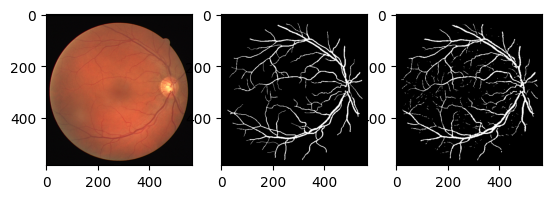

Train Epoch: 116 [0/20 (0%)]	Loss: 0.099193
Train Epoch: 116 [2/20 (10%)]	Loss: 0.087172
Train Epoch: 116 [4/20 (20%)]	Loss: 0.089103
Train Epoch: 116 [6/20 (30%)]	Loss: 0.105622
Train Epoch: 116 [8/20 (40%)]	Loss: 0.124452
Train Epoch: 116 [10/20 (50%)]	Loss: 0.087612
Train Epoch: 116 [12/20 (60%)]	Loss: 0.117656
Train Epoch: 116 [14/20 (70%)]	Loss: 0.128191
Train Epoch: 116 [16/20 (80%)]	Loss: 0.096892
Train Epoch: 116 [18/20 (90%)]	Loss: 0.107063

Test set: Avg. loss: 1.9760, Accuracy: 6354565/6599200 (96%)



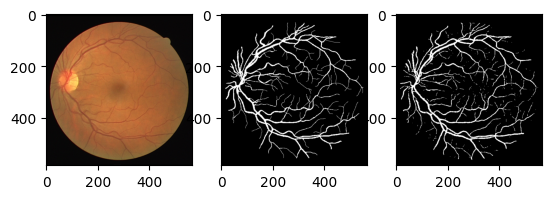

Train Epoch: 117 [0/20 (0%)]	Loss: 0.087535
Train Epoch: 117 [2/20 (10%)]	Loss: 0.087741
Train Epoch: 117 [4/20 (20%)]	Loss: 0.103393
Train Epoch: 117 [6/20 (30%)]	Loss: 0.126086
Train Epoch: 117 [8/20 (40%)]	Loss: 0.119488
Train Epoch: 117 [10/20 (50%)]	Loss: 0.105676
Train Epoch: 117 [12/20 (60%)]	Loss: 0.098200
Train Epoch: 117 [14/20 (70%)]	Loss: 0.089204
Train Epoch: 117 [16/20 (80%)]	Loss: 0.144709
Train Epoch: 117 [18/20 (90%)]	Loss: 0.108557

Test set: Avg. loss: 1.9437, Accuracy: 6357608/6599200 (96%)



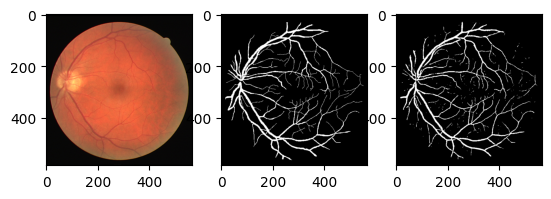

Train Epoch: 118 [0/20 (0%)]	Loss: 0.109933
Train Epoch: 118 [2/20 (10%)]	Loss: 0.109705
Train Epoch: 118 [4/20 (20%)]	Loss: 0.098649
Train Epoch: 118 [6/20 (30%)]	Loss: 0.124845
Train Epoch: 118 [8/20 (40%)]	Loss: 0.109057
Train Epoch: 118 [10/20 (50%)]	Loss: 0.099944
Train Epoch: 118 [12/20 (60%)]	Loss: 0.137574
Train Epoch: 118 [14/20 (70%)]	Loss: 0.146806
Train Epoch: 118 [16/20 (80%)]	Loss: 0.104555
Train Epoch: 118 [18/20 (90%)]	Loss: 0.123667

Test set: Avg. loss: 1.7896, Accuracy: 6346930/6599200 (96%)



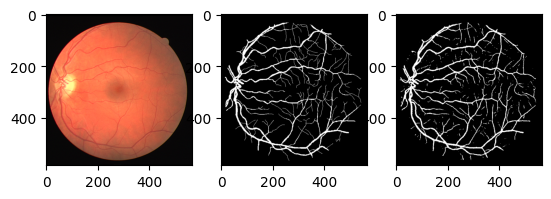

Train Epoch: 119 [0/20 (0%)]	Loss: 0.093918
Train Epoch: 119 [2/20 (10%)]	Loss: 0.098558
Train Epoch: 119 [4/20 (20%)]	Loss: 0.141596
Train Epoch: 119 [6/20 (30%)]	Loss: 0.109769
Train Epoch: 119 [8/20 (40%)]	Loss: 0.099081
Train Epoch: 119 [10/20 (50%)]	Loss: 0.125525
Train Epoch: 119 [12/20 (60%)]	Loss: 0.126666
Train Epoch: 119 [14/20 (70%)]	Loss: 0.124266
Train Epoch: 119 [16/20 (80%)]	Loss: 0.124688
Train Epoch: 119 [18/20 (90%)]	Loss: 0.093543

Test set: Avg. loss: 1.8166, Accuracy: 6352529/6599200 (96%)



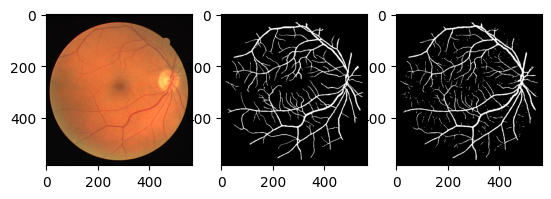

Train Epoch: 120 [0/20 (0%)]	Loss: 0.105276
Train Epoch: 120 [2/20 (10%)]	Loss: 0.091302
Train Epoch: 120 [4/20 (20%)]	Loss: 0.089276
Train Epoch: 120 [6/20 (30%)]	Loss: 0.104437
Train Epoch: 120 [8/20 (40%)]	Loss: 0.108849
Train Epoch: 120 [10/20 (50%)]	Loss: 0.093308
Train Epoch: 120 [12/20 (60%)]	Loss: 0.074018
Train Epoch: 120 [14/20 (70%)]	Loss: 0.123759
Train Epoch: 120 [16/20 (80%)]	Loss: 0.106243
Train Epoch: 120 [18/20 (90%)]	Loss: 0.126473

Test set: Avg. loss: 1.8251, Accuracy: 6352132/6599200 (96%)



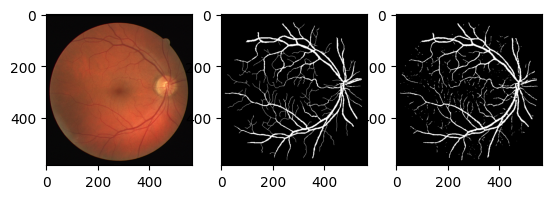

Train Epoch: 121 [0/20 (0%)]	Loss: 0.107419
Train Epoch: 121 [2/20 (10%)]	Loss: 0.091434
Train Epoch: 121 [4/20 (20%)]	Loss: 0.112277
Train Epoch: 121 [6/20 (30%)]	Loss: 0.080574
Train Epoch: 121 [8/20 (40%)]	Loss: 0.075231
Train Epoch: 121 [10/20 (50%)]	Loss: 0.111269
Train Epoch: 121 [12/20 (60%)]	Loss: 0.100841
Train Epoch: 121 [14/20 (70%)]	Loss: 0.125489
Train Epoch: 121 [16/20 (80%)]	Loss: 0.088435
Train Epoch: 121 [18/20 (90%)]	Loss: 0.098353

Test set: Avg. loss: 1.8890, Accuracy: 6357794/6599200 (96%)



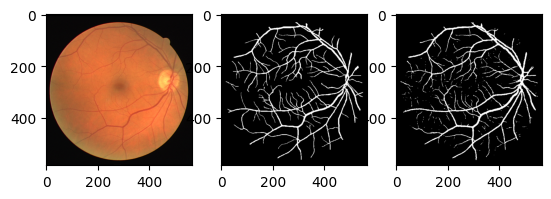

Train Epoch: 122 [0/20 (0%)]	Loss: 0.079131
Train Epoch: 122 [2/20 (10%)]	Loss: 0.097631
Train Epoch: 122 [4/20 (20%)]	Loss: 0.074461
Train Epoch: 122 [6/20 (30%)]	Loss: 0.112556
Train Epoch: 122 [8/20 (40%)]	Loss: 0.081599
Train Epoch: 122 [10/20 (50%)]	Loss: 0.112352
Train Epoch: 122 [12/20 (60%)]	Loss: 0.085404
Train Epoch: 122 [14/20 (70%)]	Loss: 0.094233
Train Epoch: 122 [16/20 (80%)]	Loss: 0.085921
Train Epoch: 122 [18/20 (90%)]	Loss: 0.074676

Test set: Avg. loss: 1.8879, Accuracy: 6360918/6599200 (96%)



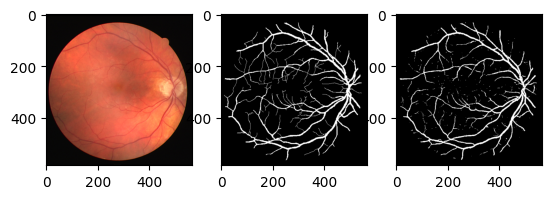

Train Epoch: 123 [0/20 (0%)]	Loss: 0.088056
Train Epoch: 123 [2/20 (10%)]	Loss: 0.077280
Train Epoch: 123 [4/20 (20%)]	Loss: 0.073809
Train Epoch: 123 [6/20 (30%)]	Loss: 0.084730
Train Epoch: 123 [8/20 (40%)]	Loss: 0.080499
Train Epoch: 123 [10/20 (50%)]	Loss: 0.079129
Train Epoch: 123 [12/20 (60%)]	Loss: 0.081046
Train Epoch: 123 [14/20 (70%)]	Loss: 0.069508
Train Epoch: 123 [16/20 (80%)]	Loss: 0.082287
Train Epoch: 123 [18/20 (90%)]	Loss: 0.086324

Test set: Avg. loss: 2.0232, Accuracy: 6360413/6599200 (96%)



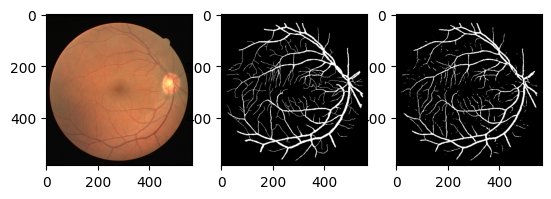

Train Epoch: 124 [0/20 (0%)]	Loss: 0.082141
Train Epoch: 124 [2/20 (10%)]	Loss: 0.065022
Train Epoch: 124 [4/20 (20%)]	Loss: 0.072926
Train Epoch: 124 [6/20 (30%)]	Loss: 0.091893
Train Epoch: 124 [8/20 (40%)]	Loss: 0.068101
Train Epoch: 124 [10/20 (50%)]	Loss: 0.076435
Train Epoch: 124 [12/20 (60%)]	Loss: 0.067058
Train Epoch: 124 [14/20 (70%)]	Loss: 0.074494
Train Epoch: 124 [16/20 (80%)]	Loss: 0.076324
Train Epoch: 124 [18/20 (90%)]	Loss: 0.070061

Test set: Avg. loss: 2.0215, Accuracy: 6357588/6599200 (96%)



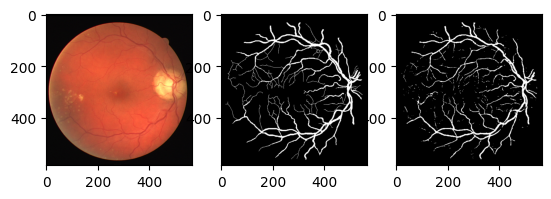

Train Epoch: 125 [0/20 (0%)]	Loss: 0.067405
Train Epoch: 125 [2/20 (10%)]	Loss: 0.069588
Train Epoch: 125 [4/20 (20%)]	Loss: 0.060869
Train Epoch: 125 [6/20 (30%)]	Loss: 0.077191
Train Epoch: 125 [8/20 (40%)]	Loss: 0.061101
Train Epoch: 125 [10/20 (50%)]	Loss: 0.103874
Train Epoch: 125 [12/20 (60%)]	Loss: 0.062125
Train Epoch: 125 [14/20 (70%)]	Loss: 0.065861
Train Epoch: 125 [16/20 (80%)]	Loss: 0.076456
Train Epoch: 125 [18/20 (90%)]	Loss: 0.111384

Test set: Avg. loss: 2.0269, Accuracy: 6358720/6599200 (96%)



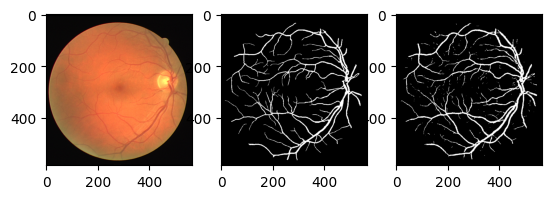

Train Epoch: 126 [0/20 (0%)]	Loss: 0.077660
Train Epoch: 126 [2/20 (10%)]	Loss: 0.087964
Train Epoch: 126 [4/20 (20%)]	Loss: 0.073029
Train Epoch: 126 [6/20 (30%)]	Loss: 0.068447
Train Epoch: 126 [8/20 (40%)]	Loss: 0.077593
Train Epoch: 126 [10/20 (50%)]	Loss: 0.078313
Train Epoch: 126 [12/20 (60%)]	Loss: 0.080314
Train Epoch: 126 [14/20 (70%)]	Loss: 0.082276
Train Epoch: 126 [16/20 (80%)]	Loss: 0.075382
Train Epoch: 126 [18/20 (90%)]	Loss: 0.076842

Test set: Avg. loss: 2.0833, Accuracy: 6361426/6599200 (96%)



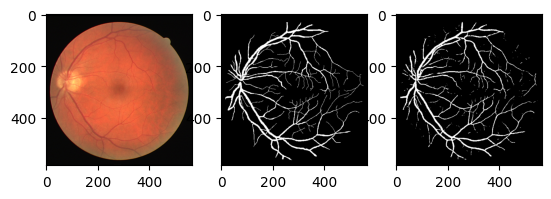

Train Epoch: 127 [0/20 (0%)]	Loss: 0.078300
Train Epoch: 127 [2/20 (10%)]	Loss: 0.072282
Train Epoch: 127 [4/20 (20%)]	Loss: 0.088207
Train Epoch: 127 [6/20 (30%)]	Loss: 0.084842
Train Epoch: 127 [8/20 (40%)]	Loss: 0.085416
Train Epoch: 127 [10/20 (50%)]	Loss: 0.077538
Train Epoch: 127 [12/20 (60%)]	Loss: 0.098930
Train Epoch: 127 [14/20 (70%)]	Loss: 0.056853
Train Epoch: 127 [16/20 (80%)]	Loss: 0.060550
Train Epoch: 127 [18/20 (90%)]	Loss: 0.126910

Test set: Avg. loss: 2.0992, Accuracy: 6358674/6599200 (96%)



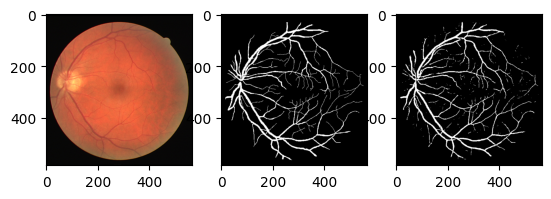

Train Epoch: 128 [0/20 (0%)]	Loss: 0.070952
Train Epoch: 128 [2/20 (10%)]	Loss: 0.067823
Train Epoch: 128 [4/20 (20%)]	Loss: 0.051658
Train Epoch: 128 [6/20 (30%)]	Loss: 0.097680
Train Epoch: 128 [8/20 (40%)]	Loss: 0.082746
Train Epoch: 128 [10/20 (50%)]	Loss: 0.066513
Train Epoch: 128 [12/20 (60%)]	Loss: 0.082688
Train Epoch: 128 [14/20 (70%)]	Loss: 0.075280
Train Epoch: 128 [16/20 (80%)]	Loss: 0.089693
Train Epoch: 128 [18/20 (90%)]	Loss: 0.070161

Test set: Avg. loss: 2.0919, Accuracy: 6359711/6599200 (96%)



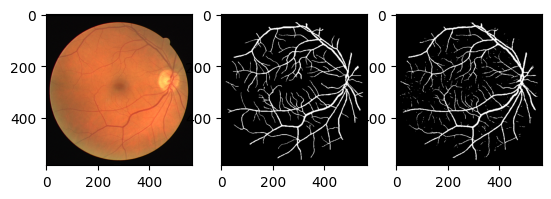

Train Epoch: 129 [0/20 (0%)]	Loss: 0.079309
Train Epoch: 129 [2/20 (10%)]	Loss: 0.065239
Train Epoch: 129 [4/20 (20%)]	Loss: 0.076810
Train Epoch: 129 [6/20 (30%)]	Loss: 0.055919
Train Epoch: 129 [8/20 (40%)]	Loss: 0.072735
Train Epoch: 129 [10/20 (50%)]	Loss: 0.070071
Train Epoch: 129 [12/20 (60%)]	Loss: 0.072614
Train Epoch: 129 [14/20 (70%)]	Loss: 0.087477
Train Epoch: 129 [16/20 (80%)]	Loss: 0.059475
Train Epoch: 129 [18/20 (90%)]	Loss: 0.072411

Test set: Avg. loss: 2.0568, Accuracy: 6356405/6599200 (96%)



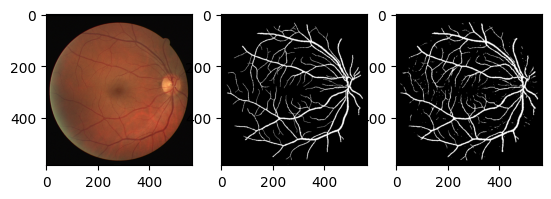

Train Epoch: 130 [0/20 (0%)]	Loss: 0.064642
Train Epoch: 130 [2/20 (10%)]	Loss: 0.066408
Train Epoch: 130 [4/20 (20%)]	Loss: 0.092804
Train Epoch: 130 [6/20 (30%)]	Loss: 0.071496
Train Epoch: 130 [8/20 (40%)]	Loss: 0.108724
Train Epoch: 130 [10/20 (50%)]	Loss: 0.065672
Train Epoch: 130 [12/20 (60%)]	Loss: 0.059262
Train Epoch: 130 [14/20 (70%)]	Loss: 0.077336
Train Epoch: 130 [16/20 (80%)]	Loss: 0.067516
Train Epoch: 130 [18/20 (90%)]	Loss: 0.078497

Test set: Avg. loss: 2.1625, Accuracy: 6359829/6599200 (96%)



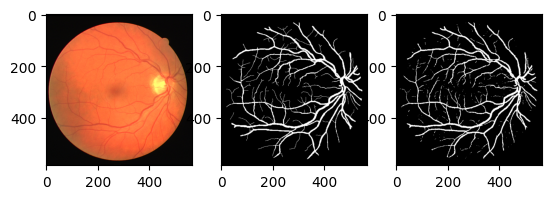

Train Epoch: 131 [0/20 (0%)]	Loss: 0.067591
Train Epoch: 131 [2/20 (10%)]	Loss: 0.067055
Train Epoch: 131 [4/20 (20%)]	Loss: 0.067069
Train Epoch: 131 [6/20 (30%)]	Loss: 0.072245
Train Epoch: 131 [8/20 (40%)]	Loss: 0.075205
Train Epoch: 131 [10/20 (50%)]	Loss: 0.056299
Train Epoch: 131 [12/20 (60%)]	Loss: 0.057993
Train Epoch: 131 [14/20 (70%)]	Loss: 0.071826
Train Epoch: 131 [16/20 (80%)]	Loss: 0.056939
Train Epoch: 131 [18/20 (90%)]	Loss: 0.080743

Test set: Avg. loss: 2.2175, Accuracy: 6361436/6599200 (96%)



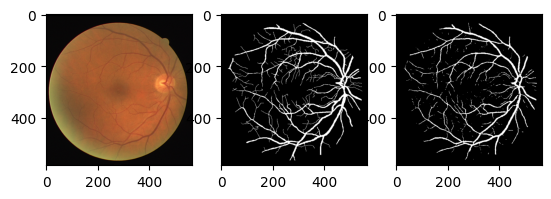

Train Epoch: 132 [0/20 (0%)]	Loss: 0.070024
Train Epoch: 132 [2/20 (10%)]	Loss: 0.047789
Train Epoch: 132 [4/20 (20%)]	Loss: 0.053560
Train Epoch: 132 [6/20 (30%)]	Loss: 0.064002
Train Epoch: 132 [8/20 (40%)]	Loss: 0.072863
Train Epoch: 132 [10/20 (50%)]	Loss: 0.055466
Train Epoch: 132 [12/20 (60%)]	Loss: 0.069337
Train Epoch: 132 [14/20 (70%)]	Loss: 0.052692
Train Epoch: 132 [16/20 (80%)]	Loss: 0.058998
Train Epoch: 132 [18/20 (90%)]	Loss: 0.070125

Test set: Avg. loss: 2.1374, Accuracy: 6356921/6599200 (96%)



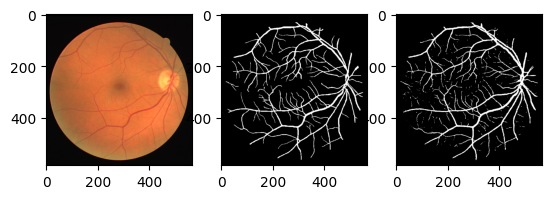

Train Epoch: 133 [0/20 (0%)]	Loss: 0.062532
Train Epoch: 133 [2/20 (10%)]	Loss: 0.052190
Train Epoch: 133 [4/20 (20%)]	Loss: 0.074082
Train Epoch: 133 [6/20 (30%)]	Loss: 0.055836
Train Epoch: 133 [8/20 (40%)]	Loss: 0.063846
Train Epoch: 133 [10/20 (50%)]	Loss: 0.076321
Train Epoch: 133 [12/20 (60%)]	Loss: 0.082091
Train Epoch: 133 [14/20 (70%)]	Loss: 0.077024
Train Epoch: 133 [16/20 (80%)]	Loss: 0.047891
Train Epoch: 133 [18/20 (90%)]	Loss: 0.057317

Test set: Avg. loss: 2.2158, Accuracy: 6356892/6599200 (96%)



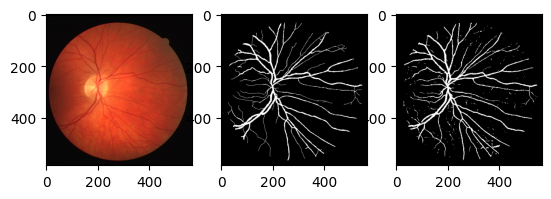

Train Epoch: 134 [0/20 (0%)]	Loss: 0.061615
Train Epoch: 134 [2/20 (10%)]	Loss: 0.064712
Train Epoch: 134 [4/20 (20%)]	Loss: 0.068349
Train Epoch: 134 [6/20 (30%)]	Loss: 0.046329
Train Epoch: 134 [8/20 (40%)]	Loss: 0.056383
Train Epoch: 134 [10/20 (50%)]	Loss: 0.045070
Train Epoch: 134 [12/20 (60%)]	Loss: 0.062432
Train Epoch: 134 [14/20 (70%)]	Loss: 0.065614
Train Epoch: 134 [16/20 (80%)]	Loss: 0.043516
Train Epoch: 134 [18/20 (90%)]	Loss: 0.056645

Test set: Avg. loss: 2.1862, Accuracy: 6358757/6599200 (96%)



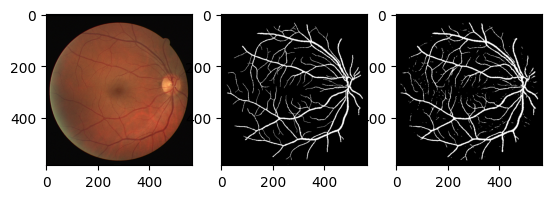

Train Epoch: 135 [0/20 (0%)]	Loss: 0.049880
Train Epoch: 135 [2/20 (10%)]	Loss: 0.047789
Train Epoch: 135 [4/20 (20%)]	Loss: 0.047707
Train Epoch: 135 [6/20 (30%)]	Loss: 0.054163
Train Epoch: 135 [8/20 (40%)]	Loss: 0.037860
Train Epoch: 135 [10/20 (50%)]	Loss: 0.053377
Train Epoch: 135 [12/20 (60%)]	Loss: 0.038884
Train Epoch: 135 [14/20 (70%)]	Loss: 0.052675
Train Epoch: 135 [16/20 (80%)]	Loss: 0.056431
Train Epoch: 135 [18/20 (90%)]	Loss: 0.053888

Test set: Avg. loss: 2.3290, Accuracy: 6360496/6599200 (96%)



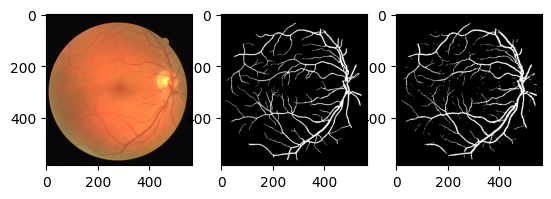

Train Epoch: 136 [0/20 (0%)]	Loss: 0.048306
Train Epoch: 136 [2/20 (10%)]	Loss: 0.056736
Train Epoch: 136 [4/20 (20%)]	Loss: 0.051285
Train Epoch: 136 [6/20 (30%)]	Loss: 0.042218
Train Epoch: 136 [8/20 (40%)]	Loss: 0.043307
Train Epoch: 136 [10/20 (50%)]	Loss: 0.052174
Train Epoch: 136 [12/20 (60%)]	Loss: 0.037518
Train Epoch: 136 [14/20 (70%)]	Loss: 0.049847
Train Epoch: 136 [16/20 (80%)]	Loss: 0.057029
Train Epoch: 136 [18/20 (90%)]	Loss: 0.039228

Test set: Avg. loss: 2.3333, Accuracy: 6364106/6599200 (96%)



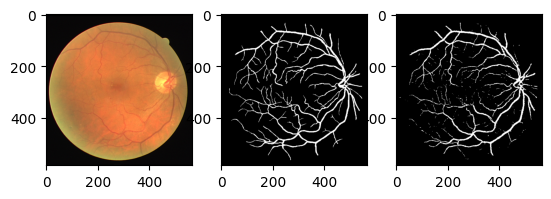

Train Epoch: 137 [0/20 (0%)]	Loss: 0.045125
Train Epoch: 137 [2/20 (10%)]	Loss: 0.039962
Train Epoch: 137 [4/20 (20%)]	Loss: 0.046447
Train Epoch: 137 [6/20 (30%)]	Loss: 0.048286
Train Epoch: 137 [8/20 (40%)]	Loss: 0.051102
Train Epoch: 137 [10/20 (50%)]	Loss: 0.044583
Train Epoch: 137 [12/20 (60%)]	Loss: 0.049601
Train Epoch: 137 [14/20 (70%)]	Loss: 0.069753
Train Epoch: 137 [16/20 (80%)]	Loss: 0.041619
Train Epoch: 137 [18/20 (90%)]	Loss: 0.051531

Test set: Avg. loss: 2.4028, Accuracy: 6360373/6599200 (96%)



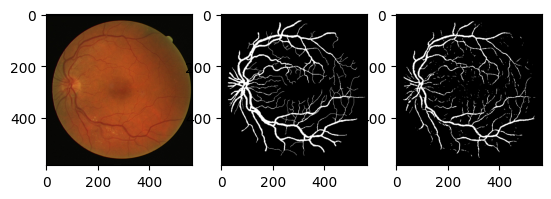

Train Epoch: 138 [0/20 (0%)]	Loss: 0.044408
Train Epoch: 138 [2/20 (10%)]	Loss: 0.030238
Train Epoch: 138 [4/20 (20%)]	Loss: 0.050891
Train Epoch: 138 [6/20 (30%)]	Loss: 0.051938
Train Epoch: 138 [8/20 (40%)]	Loss: 0.040395
Train Epoch: 138 [10/20 (50%)]	Loss: 0.067628
Train Epoch: 138 [12/20 (60%)]	Loss: 0.065993
Train Epoch: 138 [14/20 (70%)]	Loss: 0.053658
Train Epoch: 138 [16/20 (80%)]	Loss: 0.047352
Train Epoch: 138 [18/20 (90%)]	Loss: 0.056188

Test set: Avg. loss: 2.3377, Accuracy: 6351834/6599200 (96%)



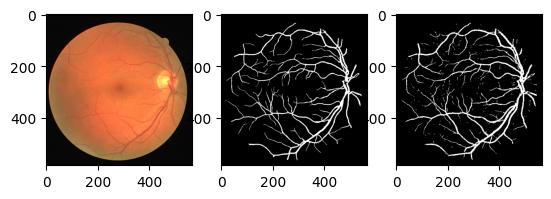

Train Epoch: 139 [0/20 (0%)]	Loss: 0.054073
Train Epoch: 139 [2/20 (10%)]	Loss: 0.037829
Train Epoch: 139 [4/20 (20%)]	Loss: 0.061106
Train Epoch: 139 [6/20 (30%)]	Loss: 0.045048
Train Epoch: 139 [8/20 (40%)]	Loss: 0.049522
Train Epoch: 139 [10/20 (50%)]	Loss: 0.045238
Train Epoch: 139 [12/20 (60%)]	Loss: 0.046187
Train Epoch: 139 [14/20 (70%)]	Loss: 0.057609
Train Epoch: 139 [16/20 (80%)]	Loss: 0.061250
Train Epoch: 139 [18/20 (90%)]	Loss: 0.046761

Test set: Avg. loss: 2.3881, Accuracy: 6357385/6599200 (96%)



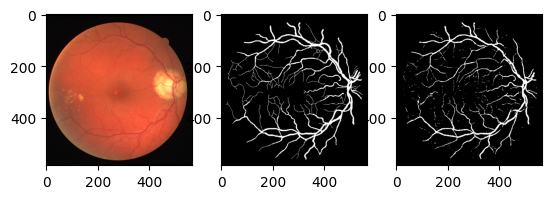

Train Epoch: 140 [0/20 (0%)]	Loss: 0.034573
Train Epoch: 140 [2/20 (10%)]	Loss: 0.058391
Train Epoch: 140 [4/20 (20%)]	Loss: 0.035924
Train Epoch: 140 [6/20 (30%)]	Loss: 0.054874
Train Epoch: 140 [8/20 (40%)]	Loss: 0.060791
Train Epoch: 140 [10/20 (50%)]	Loss: 0.043008
Train Epoch: 140 [12/20 (60%)]	Loss: 0.037790
Train Epoch: 140 [14/20 (70%)]	Loss: 0.050782
Train Epoch: 140 [16/20 (80%)]	Loss: 0.070952
Train Epoch: 140 [18/20 (90%)]	Loss: 0.046277

Test set: Avg. loss: 2.4844, Accuracy: 6357142/6599200 (96%)



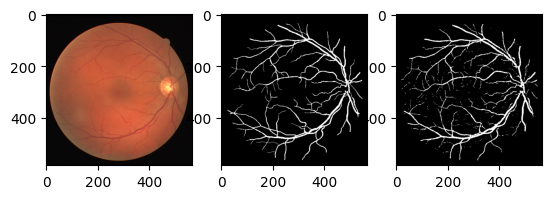

Train Epoch: 141 [0/20 (0%)]	Loss: 0.038955
Train Epoch: 141 [2/20 (10%)]	Loss: 0.065525
Train Epoch: 141 [4/20 (20%)]	Loss: 0.051372
Train Epoch: 141 [6/20 (30%)]	Loss: 0.043367
Train Epoch: 141 [8/20 (40%)]	Loss: 0.045322
Train Epoch: 141 [10/20 (50%)]	Loss: 0.055131
Train Epoch: 141 [12/20 (60%)]	Loss: 0.054873
Train Epoch: 141 [14/20 (70%)]	Loss: 0.047546
Train Epoch: 141 [16/20 (80%)]	Loss: 0.048516
Train Epoch: 141 [18/20 (90%)]	Loss: 0.042630

Test set: Avg. loss: 2.3840, Accuracy: 6362022/6599200 (96%)



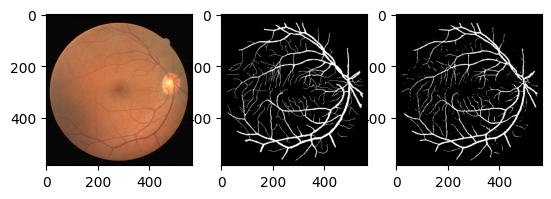

Train Epoch: 142 [0/20 (0%)]	Loss: 0.034853
Train Epoch: 142 [2/20 (10%)]	Loss: 0.045175
Train Epoch: 142 [4/20 (20%)]	Loss: 0.054012
Train Epoch: 142 [6/20 (30%)]	Loss: 0.056285
Train Epoch: 142 [8/20 (40%)]	Loss: 0.044885
Train Epoch: 142 [10/20 (50%)]	Loss: 0.042529
Train Epoch: 142 [12/20 (60%)]	Loss: 0.040000
Train Epoch: 142 [14/20 (70%)]	Loss: 0.064590
Train Epoch: 142 [16/20 (80%)]	Loss: 0.068431
Train Epoch: 142 [18/20 (90%)]	Loss: 0.054453

Test set: Avg. loss: 2.4036, Accuracy: 6354836/6599200 (96%)



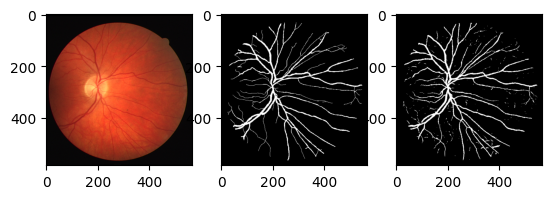

Train Epoch: 143 [0/20 (0%)]	Loss: 0.058600
Train Epoch: 143 [2/20 (10%)]	Loss: 0.083571
Train Epoch: 143 [4/20 (20%)]	Loss: 0.068550
Train Epoch: 143 [6/20 (30%)]	Loss: 0.050670
Train Epoch: 143 [8/20 (40%)]	Loss: 0.160820
Train Epoch: 143 [10/20 (50%)]	Loss: 0.058037
Train Epoch: 143 [12/20 (60%)]	Loss: 0.045498
Train Epoch: 143 [14/20 (70%)]	Loss: 0.094034
Train Epoch: 143 [16/20 (80%)]	Loss: 0.068264
Train Epoch: 143 [18/20 (90%)]	Loss: 0.059805

Test set: Avg. loss: 2.3292, Accuracy: 6355494/6599200 (96%)



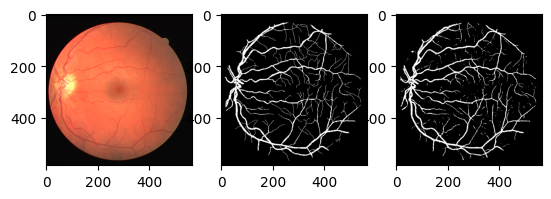

Train Epoch: 144 [0/20 (0%)]	Loss: 0.066386
Train Epoch: 144 [2/20 (10%)]	Loss: 0.047336
Train Epoch: 144 [4/20 (20%)]	Loss: 0.078884
Train Epoch: 144 [6/20 (30%)]	Loss: 0.066797
Train Epoch: 144 [8/20 (40%)]	Loss: 0.051565
Train Epoch: 144 [10/20 (50%)]	Loss: 0.065232
Train Epoch: 144 [12/20 (60%)]	Loss: 0.052769
Train Epoch: 144 [14/20 (70%)]	Loss: 0.062003
Train Epoch: 144 [16/20 (80%)]	Loss: 0.068887
Train Epoch: 144 [18/20 (90%)]	Loss: 0.071155

Test set: Avg. loss: 2.3875, Accuracy: 6355269/6599200 (96%)



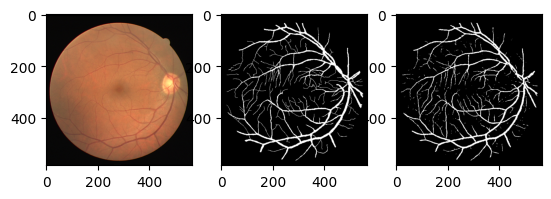

Train Epoch: 145 [0/20 (0%)]	Loss: 0.057512
Train Epoch: 145 [2/20 (10%)]	Loss: 0.035423
Train Epoch: 145 [4/20 (20%)]	Loss: 0.065111
Train Epoch: 145 [6/20 (30%)]	Loss: 0.067585
Train Epoch: 145 [8/20 (40%)]	Loss: 0.043380
Train Epoch: 145 [10/20 (50%)]	Loss: 0.051980
Train Epoch: 145 [12/20 (60%)]	Loss: 0.042761
Train Epoch: 145 [14/20 (70%)]	Loss: 0.041367
Train Epoch: 145 [16/20 (80%)]	Loss: 0.048044
Train Epoch: 145 [18/20 (90%)]	Loss: 0.051693

Test set: Avg. loss: 2.3792, Accuracy: 6361755/6599200 (96%)



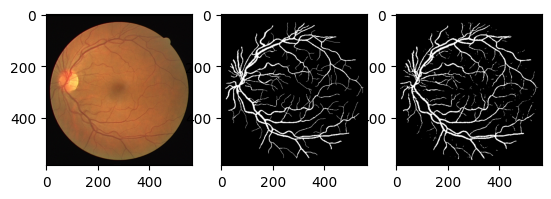

Train Epoch: 146 [0/20 (0%)]	Loss: 0.038373
Train Epoch: 146 [2/20 (10%)]	Loss: 0.036963
Train Epoch: 146 [4/20 (20%)]	Loss: 0.033163
Train Epoch: 146 [6/20 (30%)]	Loss: 0.051134
Train Epoch: 146 [8/20 (40%)]	Loss: 0.051273
Train Epoch: 146 [10/20 (50%)]	Loss: 0.053202
Train Epoch: 146 [12/20 (60%)]	Loss: 0.034431
Train Epoch: 146 [14/20 (70%)]	Loss: 0.038894
Train Epoch: 146 [16/20 (80%)]	Loss: 0.066008
Train Epoch: 146 [18/20 (90%)]	Loss: 0.041706

Test set: Avg. loss: 2.3508, Accuracy: 6358105/6599200 (96%)



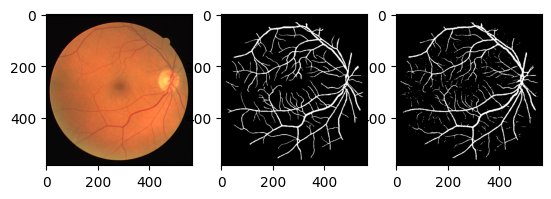

Train Epoch: 147 [0/20 (0%)]	Loss: 0.050543
Train Epoch: 147 [2/20 (10%)]	Loss: 0.038543
Train Epoch: 147 [4/20 (20%)]	Loss: 0.037457
Train Epoch: 147 [6/20 (30%)]	Loss: 0.047622
Train Epoch: 147 [8/20 (40%)]	Loss: 0.037130
Train Epoch: 147 [10/20 (50%)]	Loss: 0.035148
Train Epoch: 147 [12/20 (60%)]	Loss: 0.055842
Train Epoch: 147 [14/20 (70%)]	Loss: 0.036373
Train Epoch: 147 [16/20 (80%)]	Loss: 0.043867
Train Epoch: 147 [18/20 (90%)]	Loss: 0.044463

Test set: Avg. loss: 2.4135, Accuracy: 6360040/6599200 (96%)



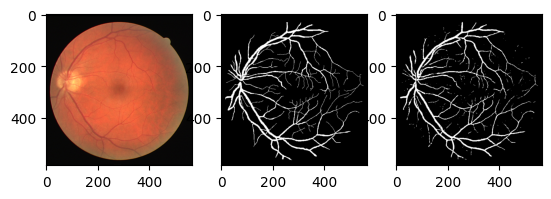

Train Epoch: 148 [0/20 (0%)]	Loss: 0.040937
Train Epoch: 148 [2/20 (10%)]	Loss: 0.037625
Train Epoch: 148 [4/20 (20%)]	Loss: 0.038821
Train Epoch: 148 [6/20 (30%)]	Loss: 0.034218
Train Epoch: 148 [8/20 (40%)]	Loss: 0.028354
Train Epoch: 148 [10/20 (50%)]	Loss: 0.043532
Train Epoch: 148 [12/20 (60%)]	Loss: 0.039851
Train Epoch: 148 [14/20 (70%)]	Loss: 0.050641
Train Epoch: 148 [16/20 (80%)]	Loss: 0.040226
Train Epoch: 148 [18/20 (90%)]	Loss: 0.038224

Test set: Avg. loss: 2.4882, Accuracy: 6360136/6599200 (96%)



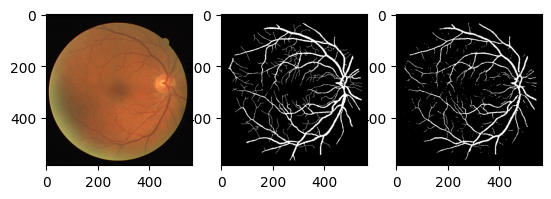

Train Epoch: 149 [0/20 (0%)]	Loss: 0.043618
Train Epoch: 149 [2/20 (10%)]	Loss: 0.033267
Train Epoch: 149 [4/20 (20%)]	Loss: 0.043825
Train Epoch: 149 [6/20 (30%)]	Loss: 0.030358
Train Epoch: 149 [8/20 (40%)]	Loss: 0.035303
Train Epoch: 149 [10/20 (50%)]	Loss: 0.054482
Train Epoch: 149 [12/20 (60%)]	Loss: 0.036867
Train Epoch: 149 [14/20 (70%)]	Loss: 0.033827
Train Epoch: 149 [16/20 (80%)]	Loss: 0.037307
Train Epoch: 149 [18/20 (90%)]	Loss: 0.027273

Test set: Avg. loss: 2.5489, Accuracy: 6362832/6599200 (96%)



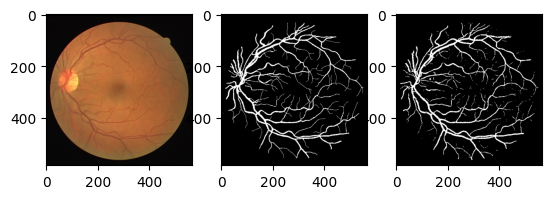

Train Epoch: 150 [0/20 (0%)]	Loss: 0.034501
Train Epoch: 150 [2/20 (10%)]	Loss: 0.024792
Train Epoch: 150 [4/20 (20%)]	Loss: 0.033409
Train Epoch: 150 [6/20 (30%)]	Loss: 0.037115
Train Epoch: 150 [8/20 (40%)]	Loss: 0.028760
Train Epoch: 150 [10/20 (50%)]	Loss: 0.038453
Train Epoch: 150 [12/20 (60%)]	Loss: 0.028453
Train Epoch: 150 [14/20 (70%)]	Loss: 0.040448
Train Epoch: 150 [16/20 (80%)]	Loss: 0.042665
Train Epoch: 150 [18/20 (90%)]	Loss: 0.032891

Test set: Avg. loss: 2.5401, Accuracy: 6357816/6599200 (96%)



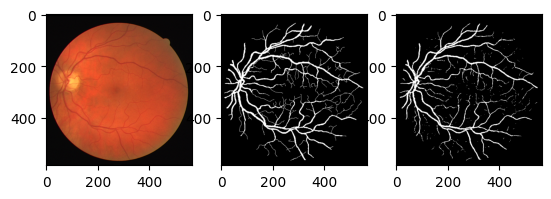

In [23]:
test(network, test_loader, loss_fn, batch_size_test,  test_losses, test_counter)
best=test_losses[-1]
for epoch in range(1, n_epochs + 1):
  train(network, train_loader, epoch, optimizer, loss_fn, log_interval, batch_size_train, train_losses, train_counter)
  test(network, test_loader, loss_fn, batch_size_test,  test_losses, test_counter)
  if test_losses[-1] < best:
    best=test_losses[-1]
    print("New best! Saving...")
    torch.save(network.state_dict(), parameters_file)
  scheduler.step()

torch.save((train_counter, train_losses, test_losses), training_data_file)

Best: 0.6731995940208435


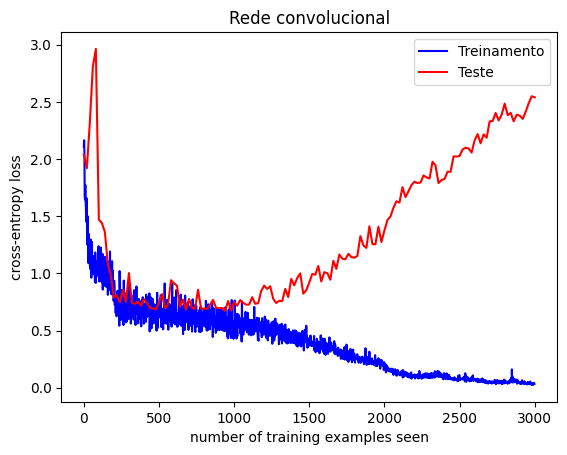

In [33]:
fig = plt.figure()
(train_counter, train_losses, test_losses) = torch.load( training_data_file)

test_counter = [i*len(train_loader.dataset) for i in range(len(test_losses))]
for i in range(len(train_losses)):
  train_losses[i] = train_losses[i].cpu().detach()

for i in range(len(test_losses)):
  test_losses[i] = test_losses[i].cpu().detach()

plt.plot(train_counter, train_losses, color='blue', label='Treinamento')
plt.plot(test_counter, test_losses, color='red', label='Teste')
plt.legend(['Train Loss', 'Test Loss'], loc='upper right')
plt.xlabel('number of training examples seen')
plt.ylabel('cross-entropy loss')
plt.legend()
plt.title("Rede convolucional")

print(f"Best: {min(test_losses)}")

torch.Size([3, 584, 565])
torch.Size([584, 565, 3])
torch.Size([584, 565])
tensor([0, 1])
torch.Size([2, 584, 565])
torch.Size([3, 584, 565])
torch.Size([584, 565, 3])
torch.Size([584, 565])
tensor([0, 1])
torch.Size([2, 584, 565])
torch.Size([3, 584, 565])
torch.Size([584, 565, 3])
torch.Size([584, 565])
tensor([0, 1])
torch.Size([2, 584, 565])
torch.Size([3, 584, 565])
torch.Size([584, 565, 3])
torch.Size([584, 565])
tensor([0, 1])
torch.Size([2, 584, 565])
torch.Size([3, 584, 565])
torch.Size([584, 565, 3])
torch.Size([584, 565])
tensor([0, 1])
torch.Size([2, 584, 565])


<Figure size 640x480 with 0 Axes>

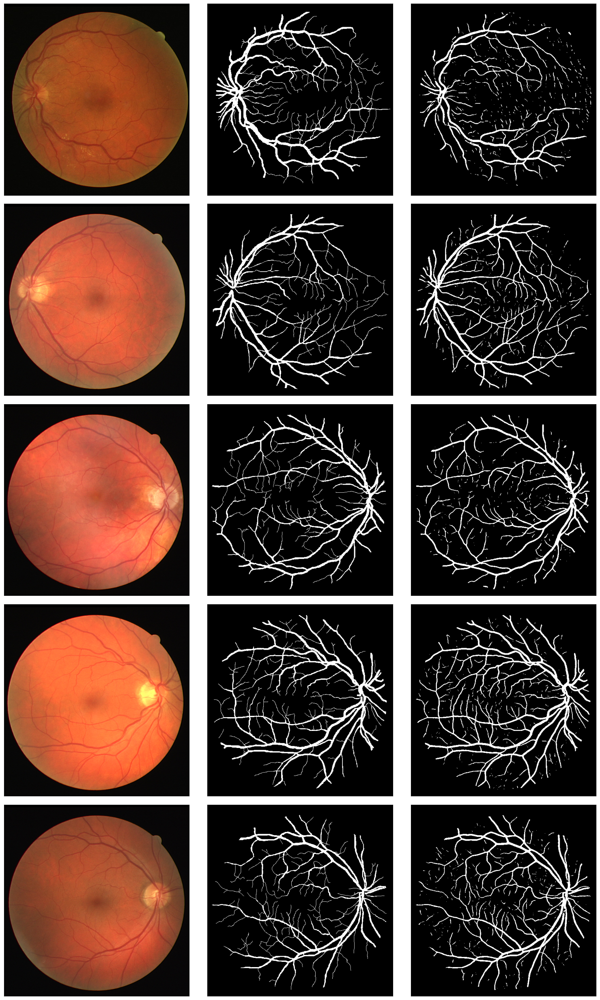

In [25]:

network.load_state_dict(torch.load(parameters_file))
fig = plt.figure()
length=5
begin=0
visualization_range = np.random.choice(len(test_data), length)
example_data = torch.stack([test_data[i][0] for i in visualization_range])
example_targets = torch.stack([test_data[i][1] for i in visualization_range])
network.eval()
plt.figure(figsize=(3*5, length*5))
for i in range(length):
  print(example_data[i].shape)

  data = example_data[i].movedim(0, 2)

  print(data.shape)
  plt.subplot(length,3,3*i+1)
  plt.tight_layout()
  plt.imshow(data)
  plt.xticks([])
  plt.yticks([])
  target = example_targets[i]

  print (target.shape)
  plt.subplot(length,3,3*i+2)
  plt.tight_layout()
  plt.imshow(target, cmap='gray')
  plt.xticks([])
  plt.yticks([])

  print(torch.unique(target))
  with torch.no_grad():
    output = network(example_data[i].to(device).unsqueeze(0)).squeeze(0)
    print (output.shape)
    plt.subplot(length,3,3*i+3)
    plt.tight_layout()
    plt.imshow(output.cpu().argmax(-3) , cmap='gray')
    plt.xticks([])
    plt.yticks([])
